# Train model on less complex data (64 channels -> 16 channels)

(83, 16, 9760)
eyes open


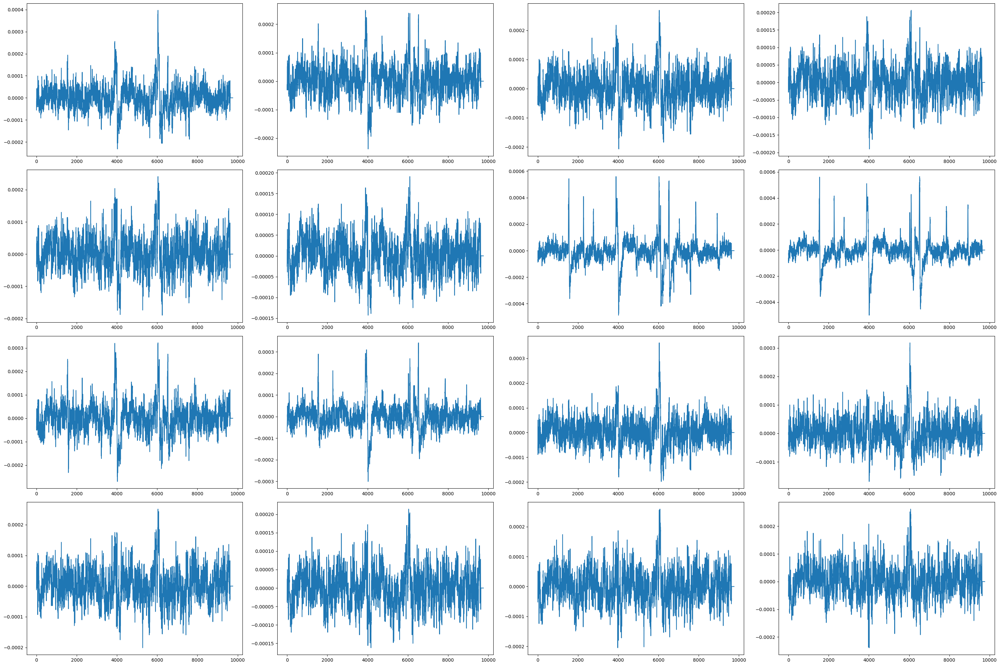

(76, 16, 9760)
eyes closed


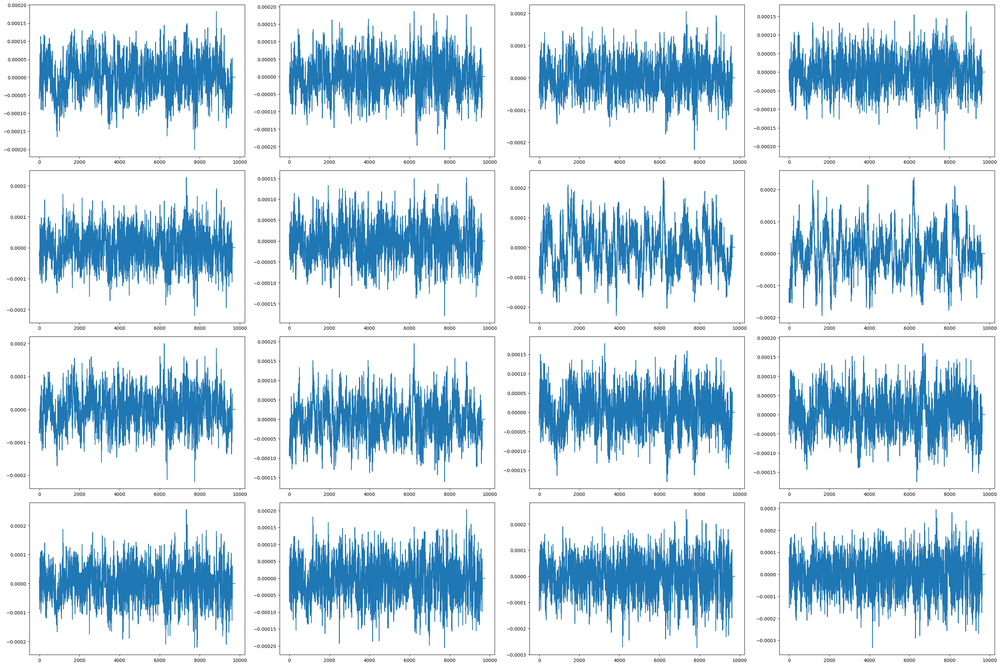

(83, 16, 9760)
eyes open


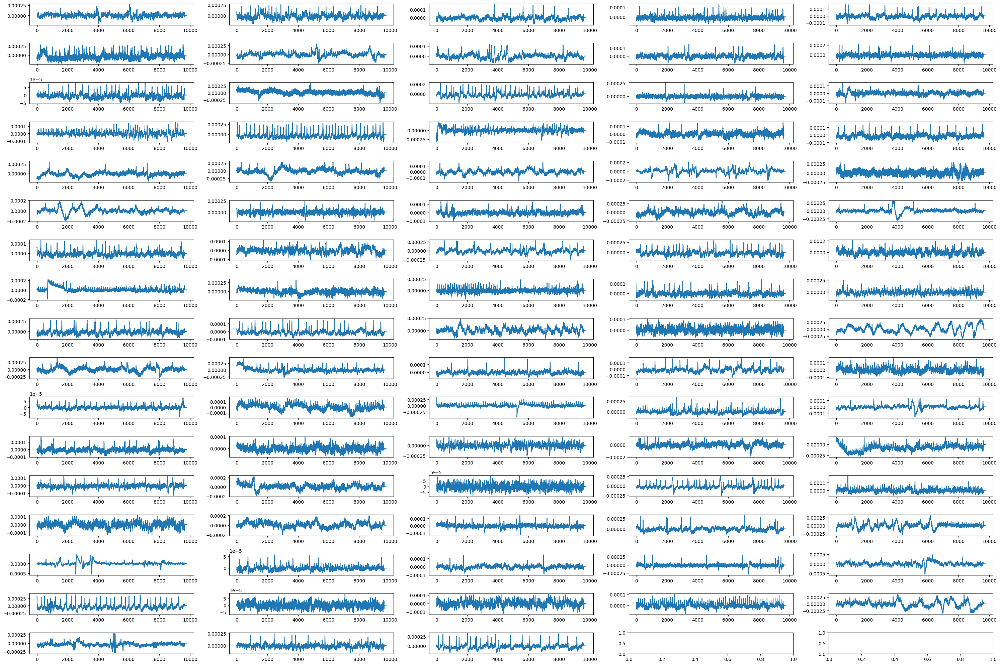

(76, 16, 9760)
eyes closed


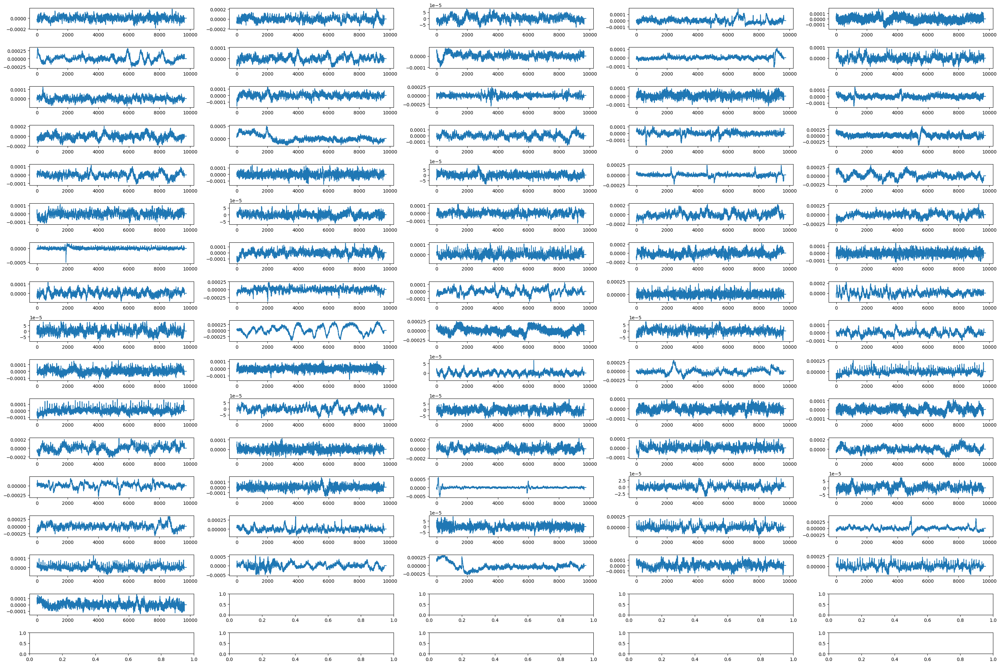

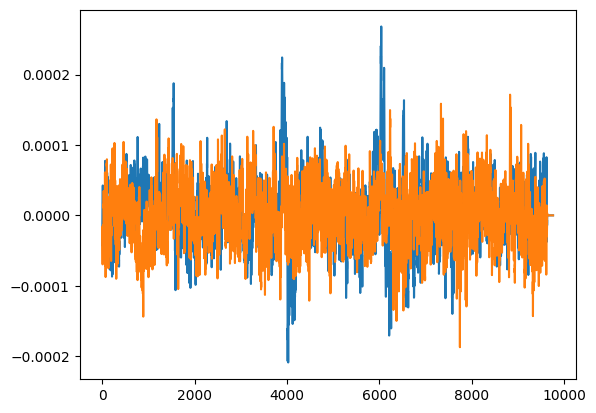

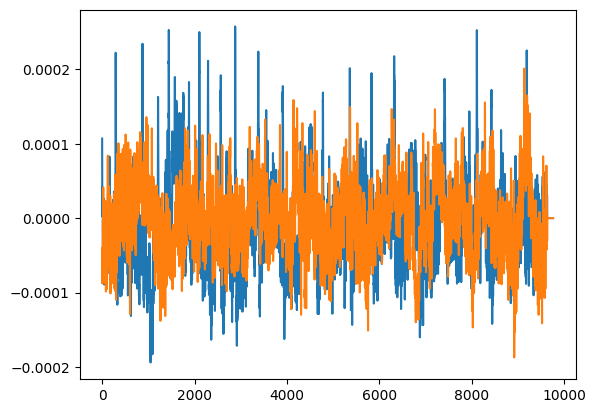

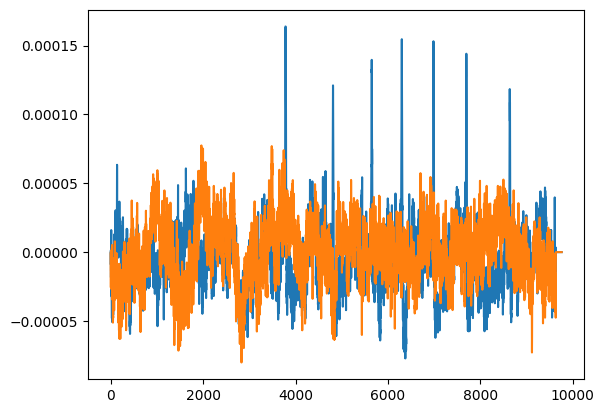

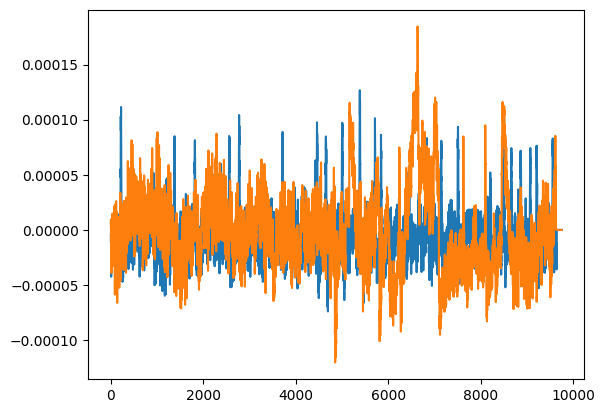

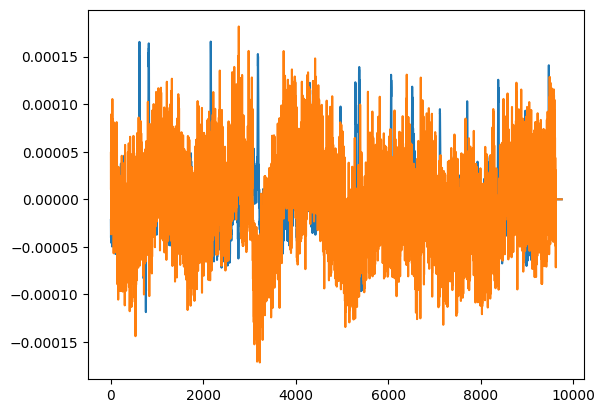

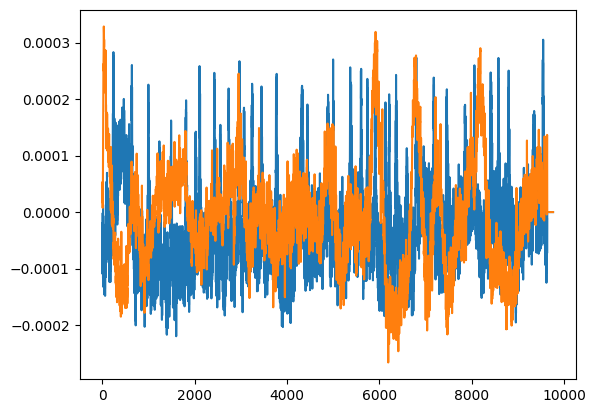

eyes open


C:\Users\joshua.park\AppData\Local\Temp\ipykernel_12444\1421570195.py:170: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:248.)
  averaged_data = average_across_arrays(torch.tensor(training_data_open).detach())


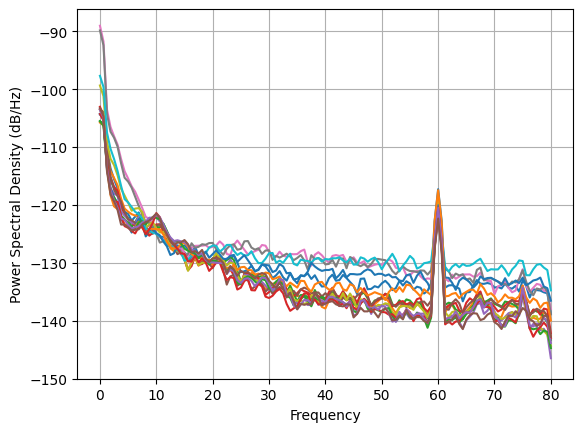

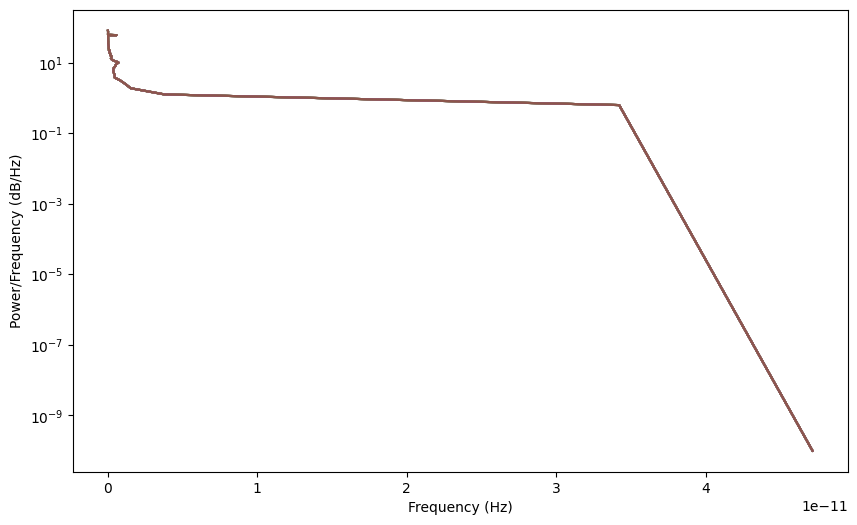

eyes closed


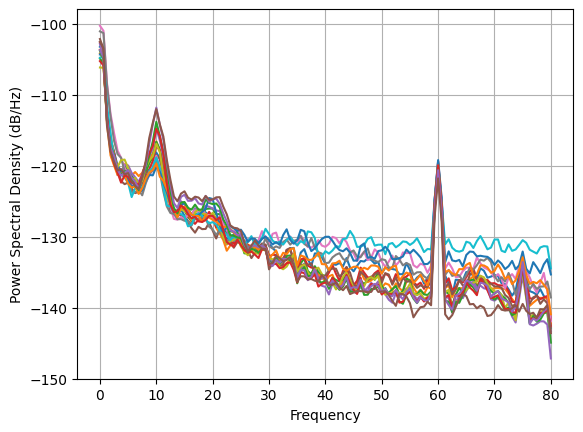

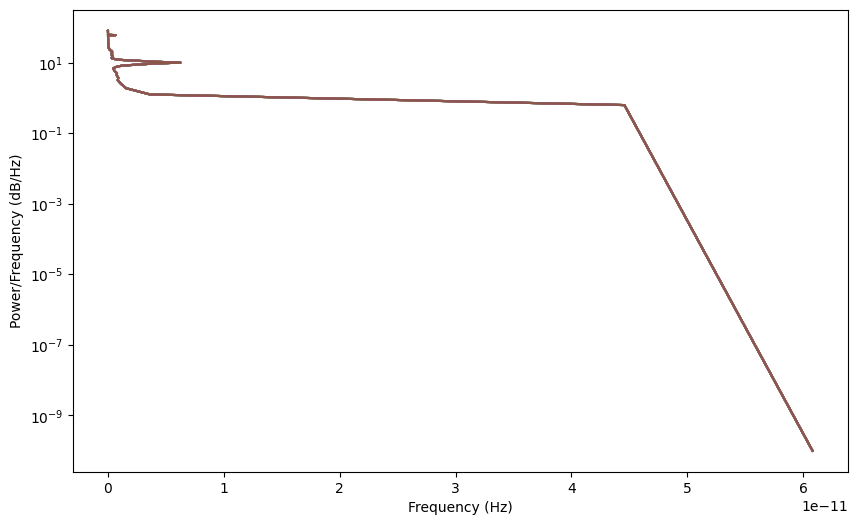

In [1]:
import mne
import numpy as np 
import matplotlib.pyplot as plt
import torch
import os
import sklearn
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from sklearn.preprocessing import MinMaxScaler
from torch.utils.data import TensorDataset, DataLoader


# Imports
# ==========================================================================================
# ==========================================================================================
# Data Trimming


eyes_open = np.load('training_open.npy')
eyes_closed = np.load('training_closed.npy')

training_data_open = []
training_data_closed = []

for i in range(len(eyes_open)):
    aux = []
    for j in range(0, 64, 4):
        aux.append(eyes_open[i,j,:])
    training_data_open.append(aux)

for i in range(len(eyes_closed)):
    aux = []
    for j in range(0, 64, 4):
        aux.append(eyes_closed[i,j,:])
    training_data_closed.append(aux)

eyes_open = None
eyes_closed = None


# Data Trimming
# ==========================================================================================
# ==========================================================================================
# Plot 16 channels of a sample


print(np.shape(training_data_open))
print("eyes open")
fig, axs = plt.subplots(4, 4, figsize=(30, 20))
axs = axs.flatten()
data_open = training_data_open[0]
for idx in range(16):
    axs[idx].plot(data_open[idx])
plt.tight_layout()
plt.show()


print(np.shape(training_data_closed))
print("eyes closed")
fig, axs = plt.subplots(4, 4, figsize=(30, 20))
axs = axs.flatten()
data_closed = training_data_closed[0]
for idx in range(16):
    axs[idx].plot(data_closed[idx])
plt.tight_layout()
plt.show()



# Plot 16 channels of a sample
# ==========================================================================================
# ==========================================================================================
# Plot average of all channels for all samples


print(np.shape(training_data_open))
print("eyes open")
fig, axs = plt.subplots(17, 5, figsize=(30, 20))
axs = axs.flatten()
for idx,data in enumerate(training_data_open):
    axs[idx].plot(np.array(data).mean(axis=0))
plt.tight_layout()
plt.show()

print(np.shape(training_data_closed))
print("eyes closed")
fig, axs = plt.subplots(17, 5, figsize=(30, 20))
axs = axs.flatten()
for idx,data in enumerate(training_data_closed):
    axs[idx].plot(np.array(data).mean(axis=0))
plt.tight_layout()
plt.show()



# Plot average of all channels for all samples
# ==========================================================================================
# ==========================================================================================
# Overlay open and closed

plt.plot(np.array(training_data_open[0]).mean(axis=0))
plt.plot(np.array(training_data_closed[0]).mean(axis=0))
plt.show()

plt.plot(np.array(training_data_open[1]).mean(axis=0))
plt.plot(np.array(training_data_closed[1]).mean(axis=0))
plt.show()

plt.plot(np.array(training_data_open[2]).mean(axis=0))
plt.plot(np.array(training_data_closed[2]).mean(axis=0))
plt.show()

plt.plot(np.array(training_data_open[3]).mean(axis=0))
plt.plot(np.array(training_data_closed[3]).mean(axis=0))
plt.show()


plt.plot(np.array(training_data_open[4]).mean(axis=0))
plt.plot(np.array(training_data_closed[4]).mean(axis=0))
plt.show()


plt.plot(np.array(training_data_open[5]).mean(axis=0))
plt.plot(np.array(training_data_closed[5]).mean(axis=0))
plt.show()

# Overlay open and closed
# ==========================================================================================
# ==========================================================================================
# PSD



def compute_psd(data, fs, nperseg=256, noverlap=None):
    """
    Compute Power Spectral Density (PSD) using the Welch method.

    Parameters:
        data (array): EEG data array with shape (n_channels, n_samples).
        fs (float): Sampling frequency.
        nperseg (int): Length of each segment for PSD estimation.
        noverlap (int): Number of overlapping samples between segments.
    
    Returns:
        freqs (array): Frequency values.
        psd (array): Power Spectral Density values.
    """
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = plt.psd(data[ch_idx], Fs=fs, NFFT=nperseg, noverlap=noverlap)
        # Add a small epsilon to avoid zero values
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def average_across_arrays(generated_data):
    return generated_data.mean(dim=0)

# Set the sampling frequency
fs = 160.0

## open data
averaged_data = average_across_arrays(torch.tensor(training_data_open).detach())
freqs, psd = compute_psd(averaged_data, fs)
plt.figure(figsize=(10, 6))  # Add this line to create a single figure
for ch_idx in range(16):
    plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')

print("eyes open")
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power/Frequency (dB/Hz)')
plt.show()



## closed data
averaged_data = average_across_arrays(torch.tensor(training_data_closed).detach())
freqs, psd = compute_psd(averaged_data, fs)
plt.figure(figsize=(10, 6))  # Add this line to create a single figure
for ch_idx in range(16):
    plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')

print("eyes closed")
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power/Frequency (dB/Hz)')
plt.show()


# PSD
# ==========================================================================================
# ==========================================================================================
# Model

NUM_CHANNELS = 16
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty


# Model
# ==========================================================================================
# ==========================================================================================
# Plot Model


def plot_everything(generated_data, gen_err, critic_err):
    generated_data = generated_data.detach()
    
    # plotting generated data
    values = generated_data[0, 0, :]
    plt.plot(values.tolist())
    plt.show()

    # plotting PSD
    averaged_data = average_across_arrays(generated_data)
    freqs, psd = compute_psd(averaged_data, fs)
    plt.figure(figsize=(10, 6))  # Add this line to create a single figure
    for ch_idx in range(16):
        plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power/Frequency (dB/Hz)')
    plt.show()

    # plotting G vs D losses
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(gen_err,label="Generator")
    plt.plot(critic_err,label="Critic")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

# 16 channel training data

Epoch 0: Critic error ([4.943850766774254]) Generator err ([-0.04374651983380318])


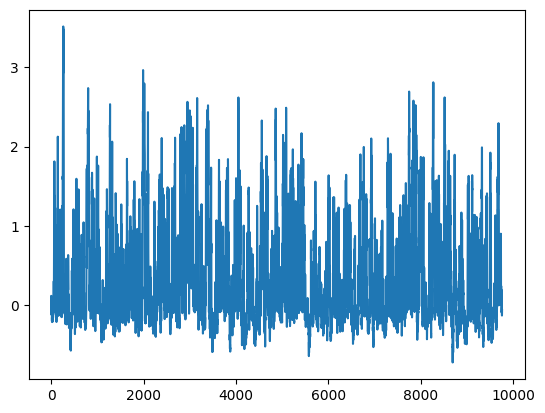

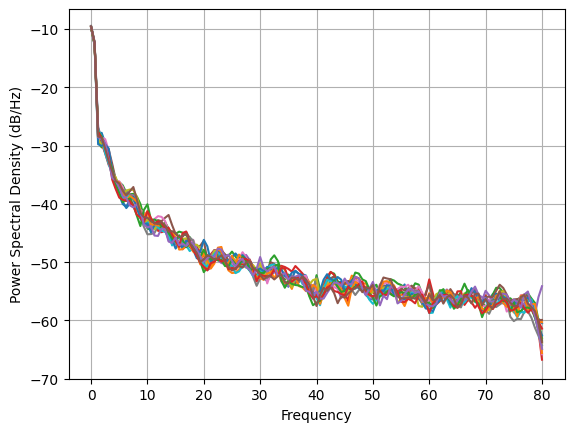

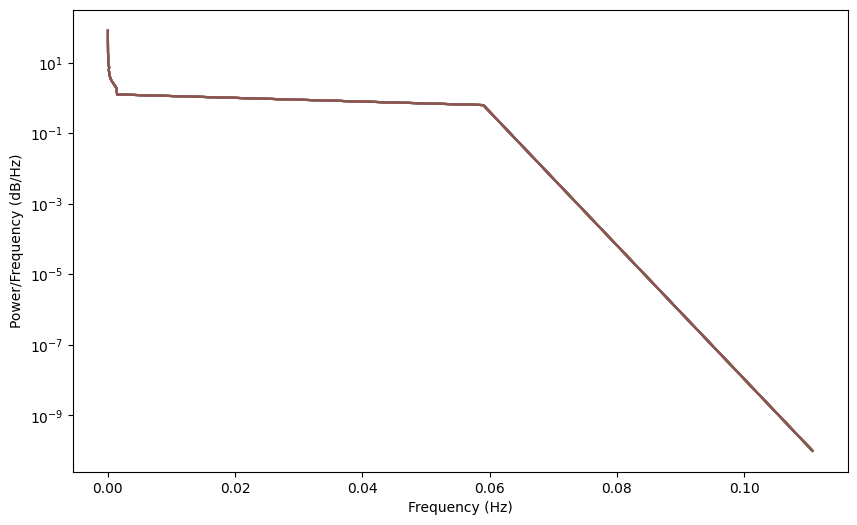

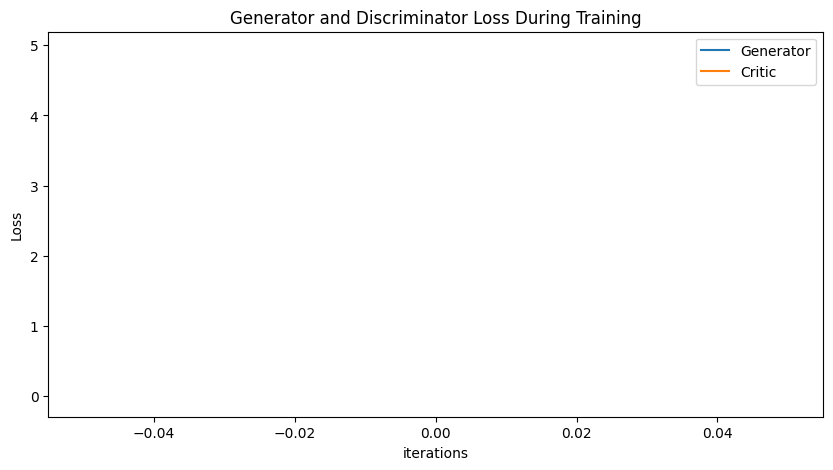

Epoch 10: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931]) Generator err ([-0.04374651983380318, -0.10013803094625473, 0.6476461887359619, 1.4785281419754028, 1.6544511318206787, 1.3438706398010254, 2.1753106117248535, 7.412339210510254, 8.543139457702637, 10.185006141662598, 8.973136901855469])


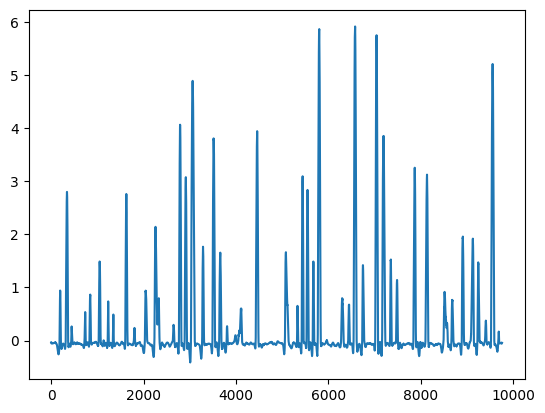

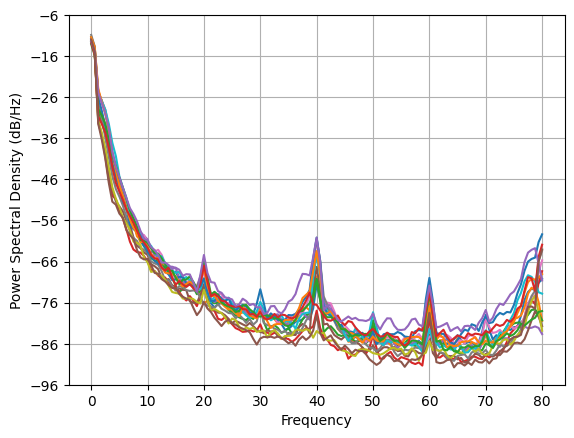

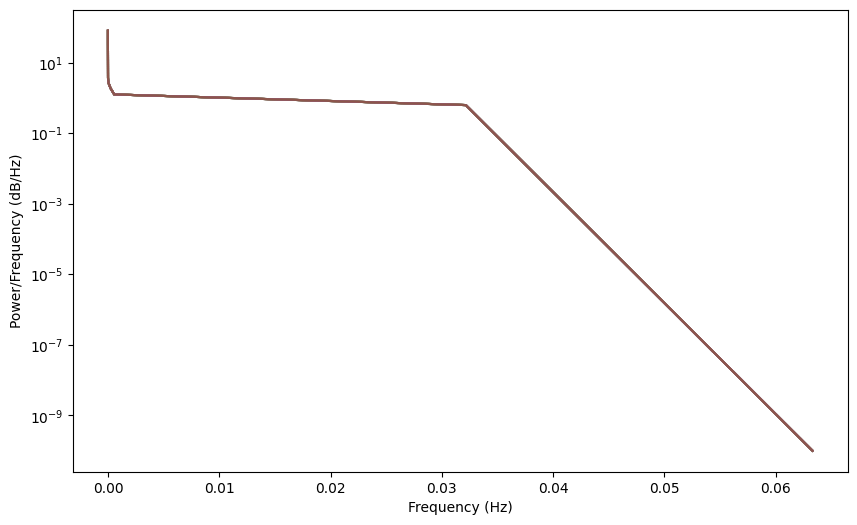

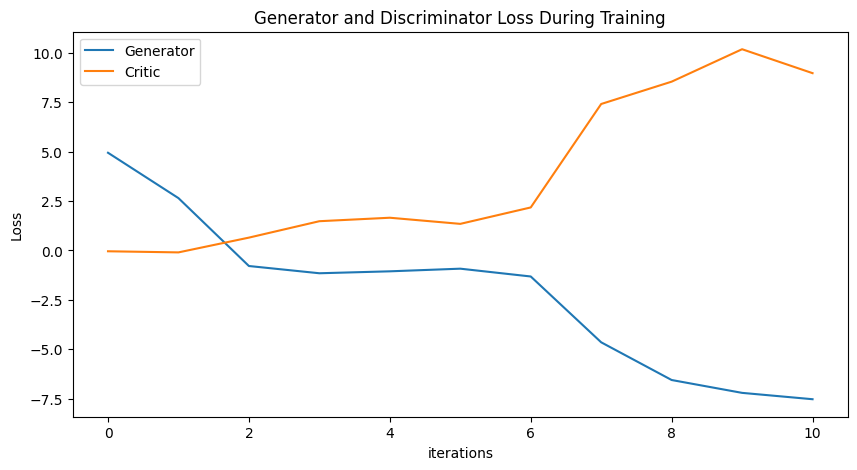

Epoch 20: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032]) Generator err ([-0.04374651983380318, -0.10013803094625473, 0.6476461887359619, 1.4785281419754028, 1.6544511318206787, 1.3438706398010254, 2.1753106117248535, 7.412339210510254, 8.543139457702637, 10.185006141662598, 8.973136901855469, 14.983121871948242, 12.464982986450195, 11.896175384521484, 12.699421882629395, 11.57563304901123, 13.083003044128418, 13.734391212463379, 13.568028450012207, 14.8766450881958, 19.941240310668945])


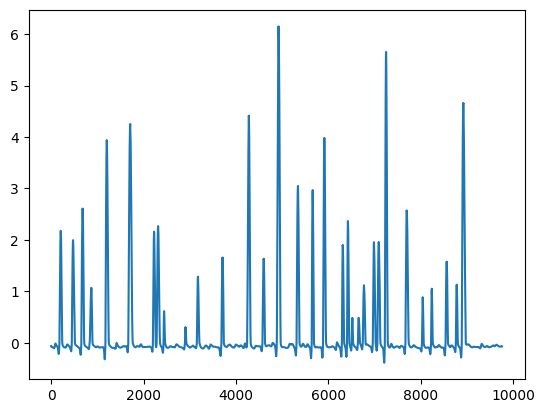

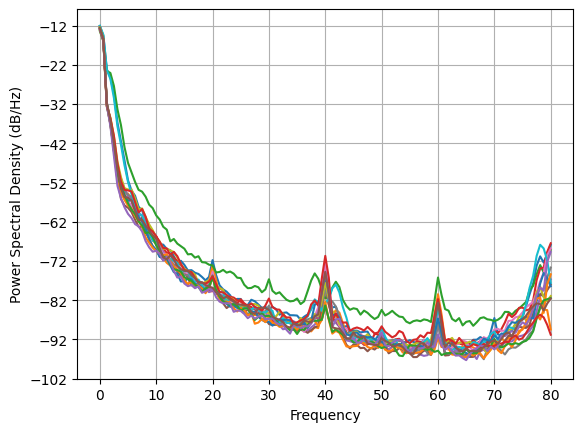

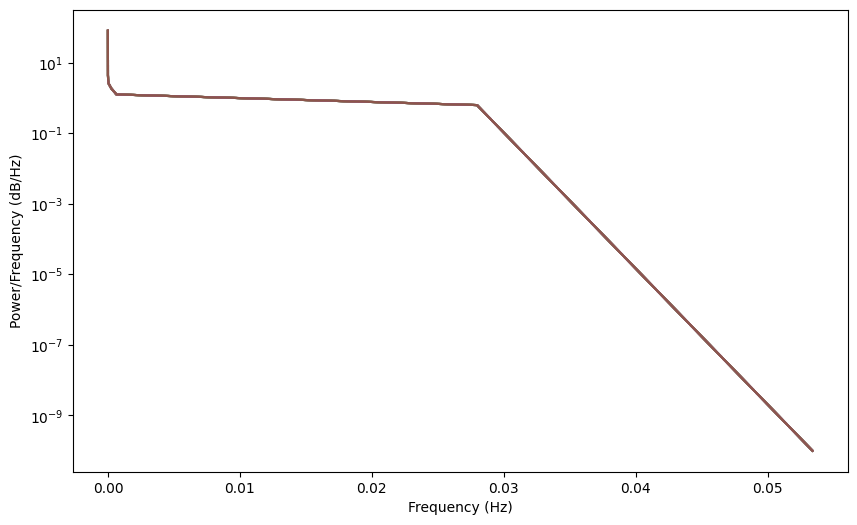

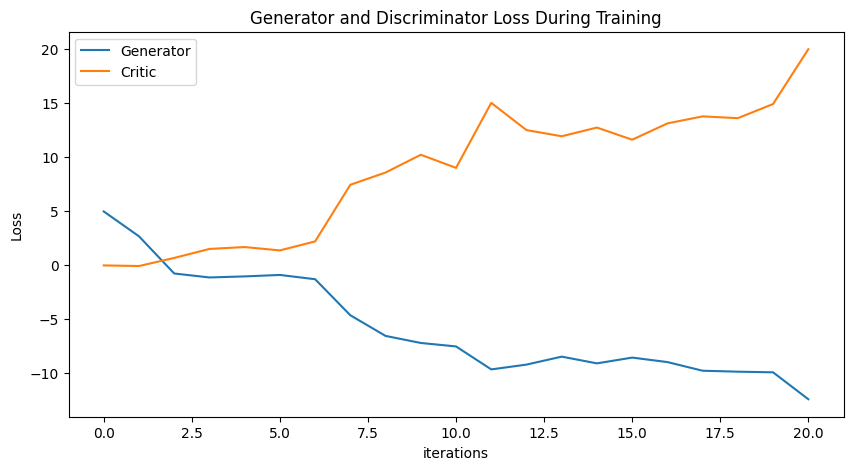

Epoch 30: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342]) Generator err ([-0.04374651983380318, -0.10013803094625473, 0.6476461887359619, 1.4785281419754028, 1.6544511318206787, 1.3438706398010254, 2.1753106117248535, 7.412339210510254, 8.543139457702637, 10.185006141662598, 8.973136901855469, 14.983121871948242, 12.464982986450195, 11.896175384521484, 12.699421882629395, 11.57563304901123, 13.0830030441284

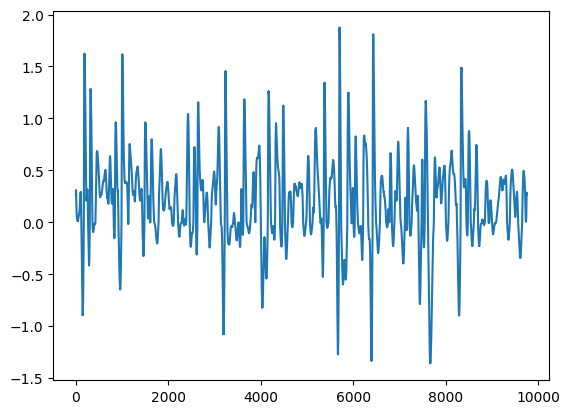

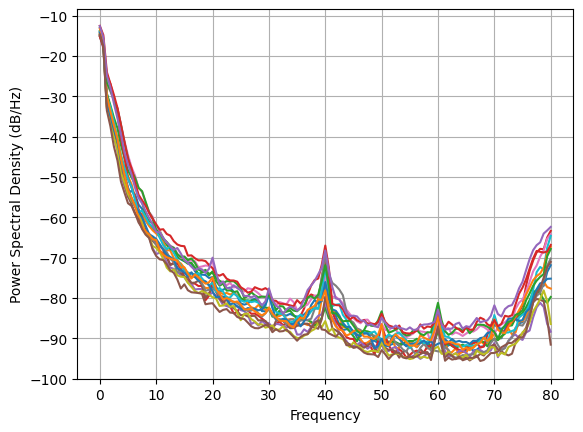

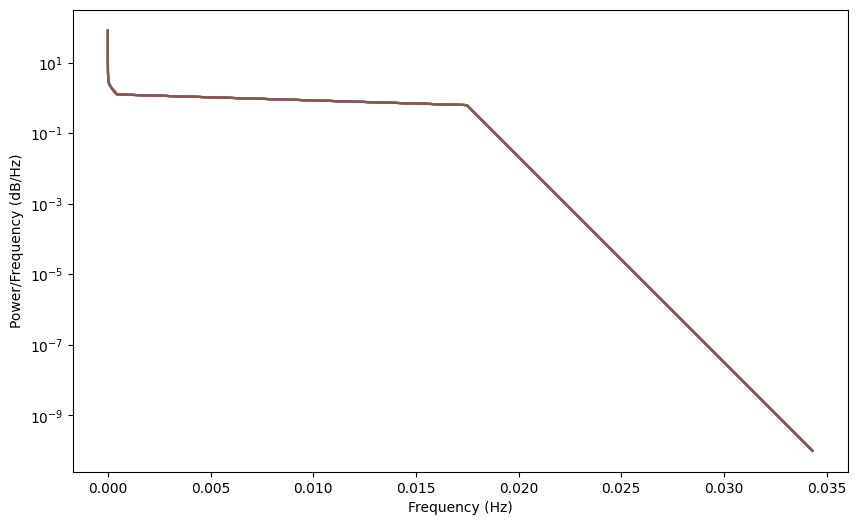

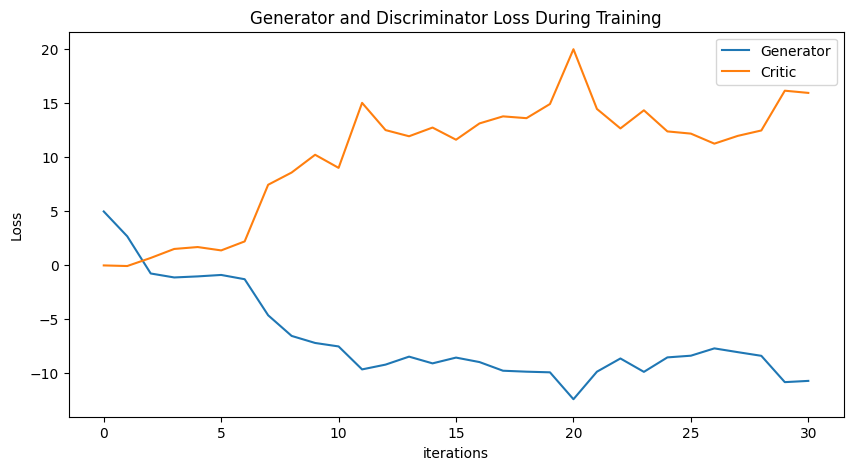

Epoch 40: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123]) Generator err ([-0.04374651983380318, -0.10013803094625473, 0.6476461887359619, 1.4785281419754028, 1.6544511318206787, 1.3438706398010254, 2.17531

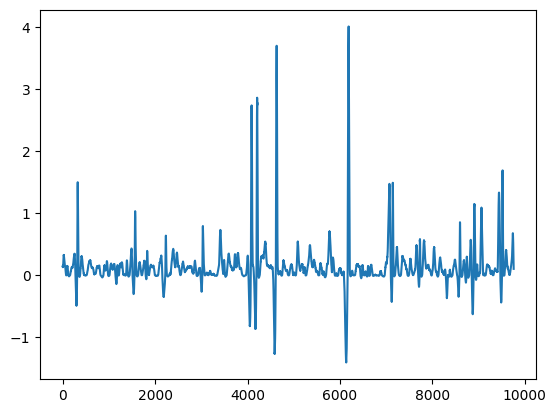

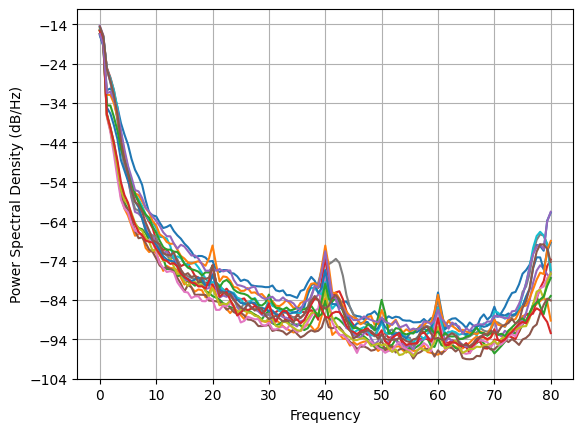

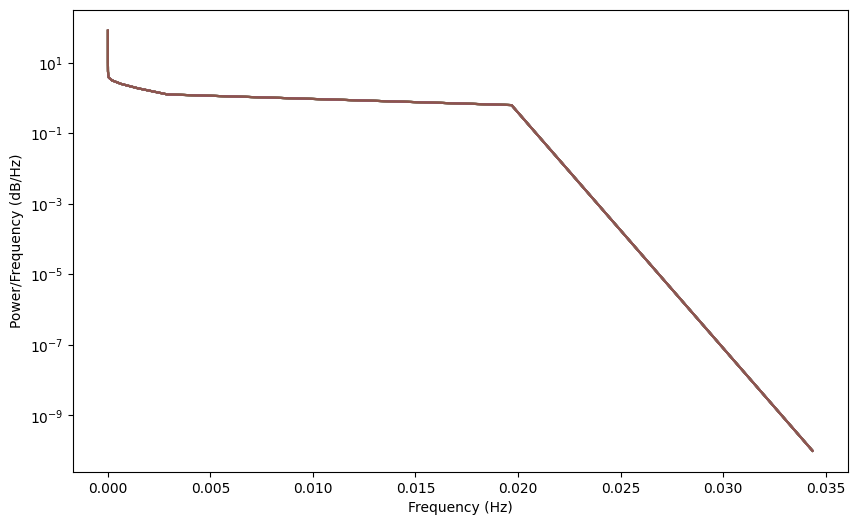

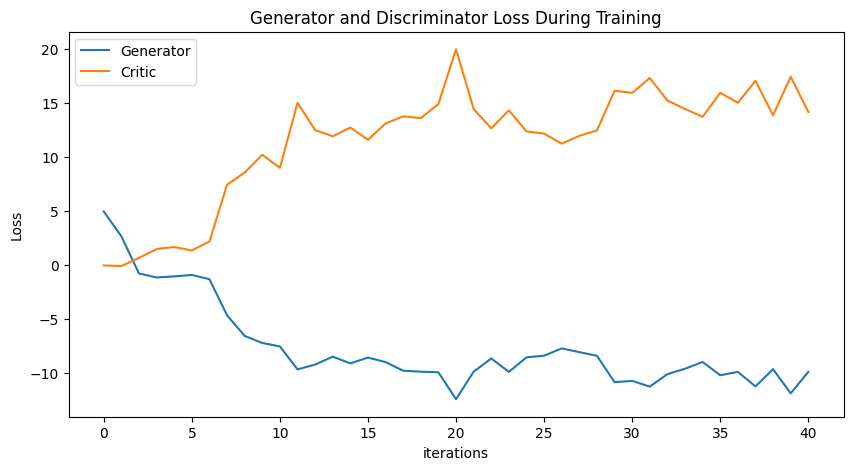

Epoch 50: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.8495

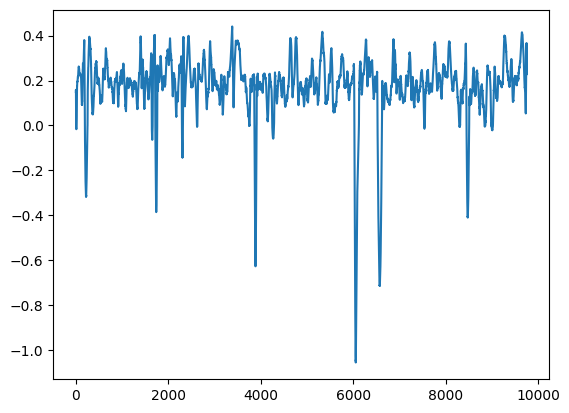

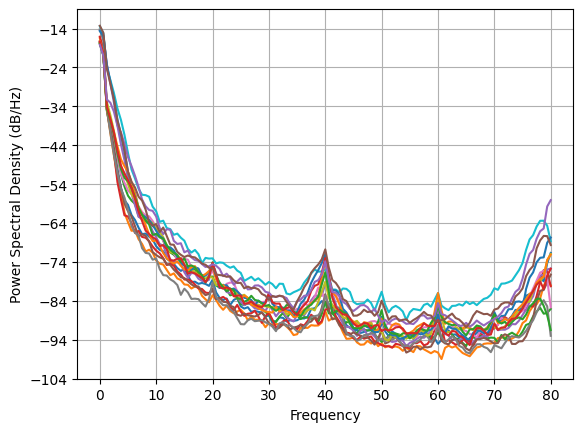

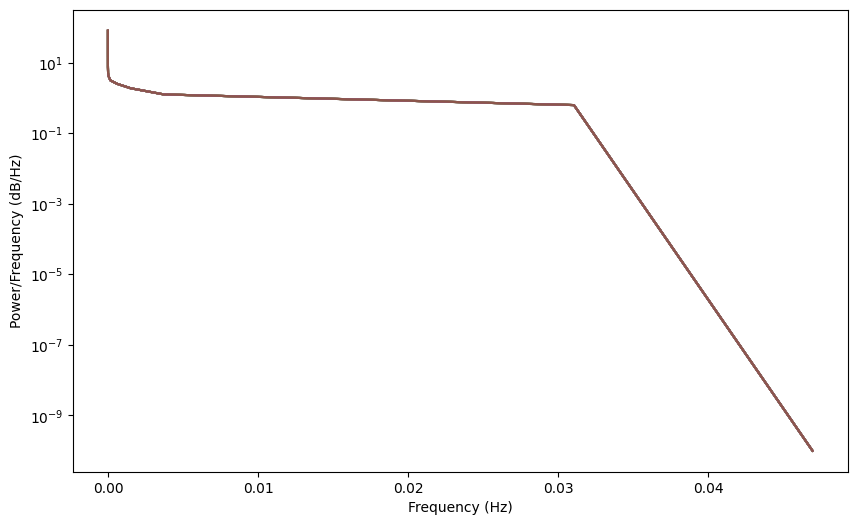

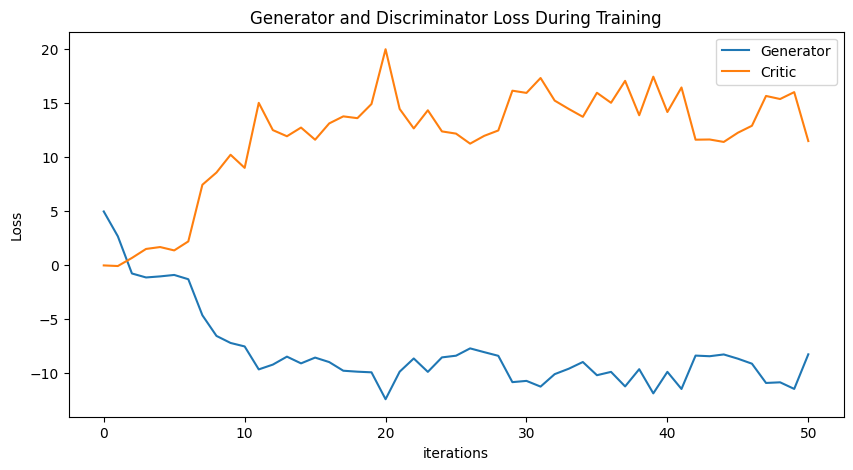

Epoch 60: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.8495

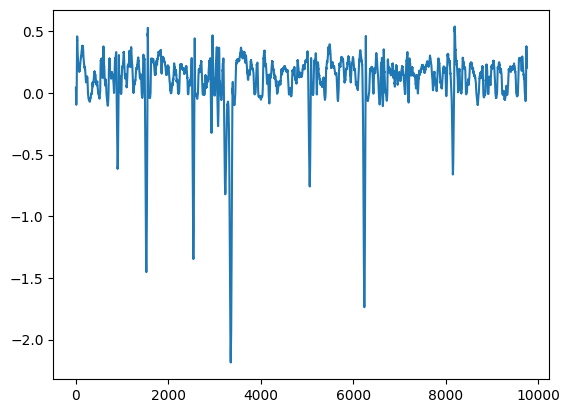

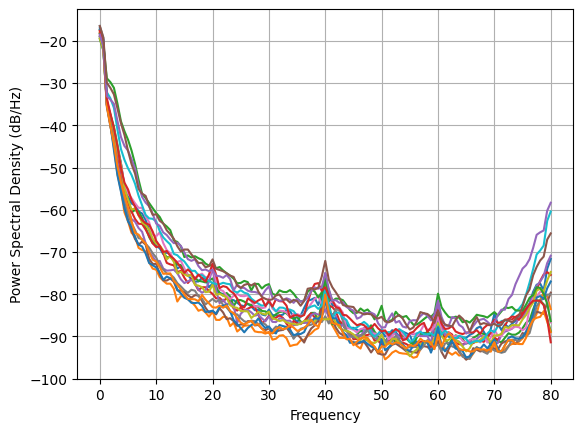

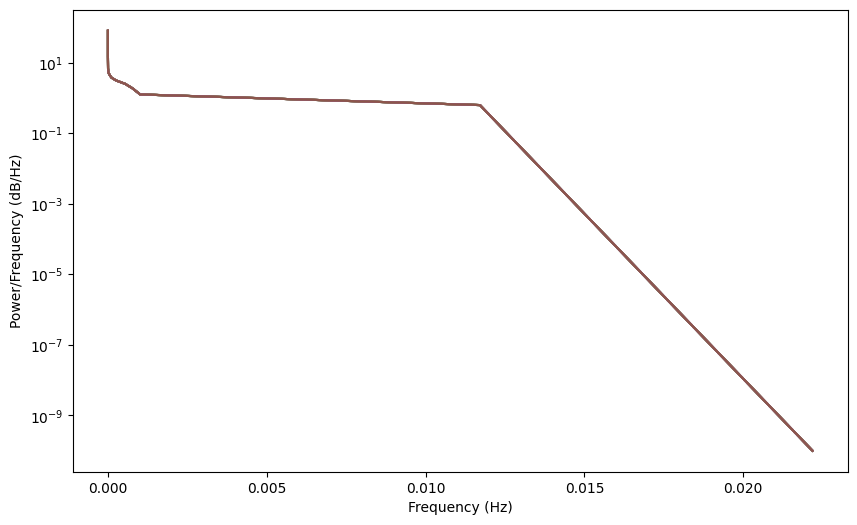

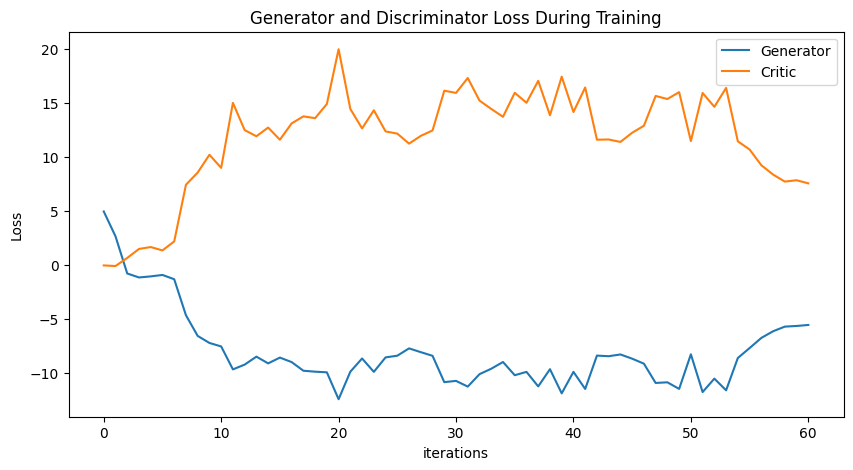

Epoch 70: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.8495

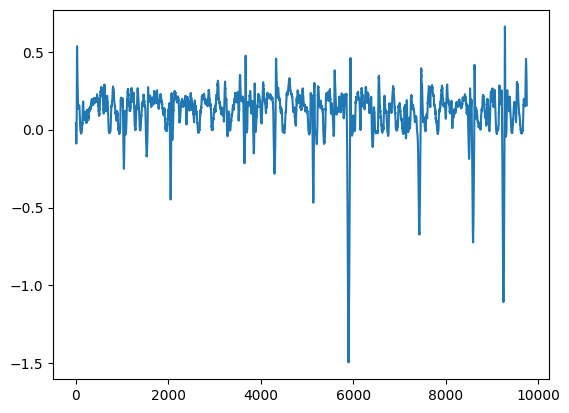

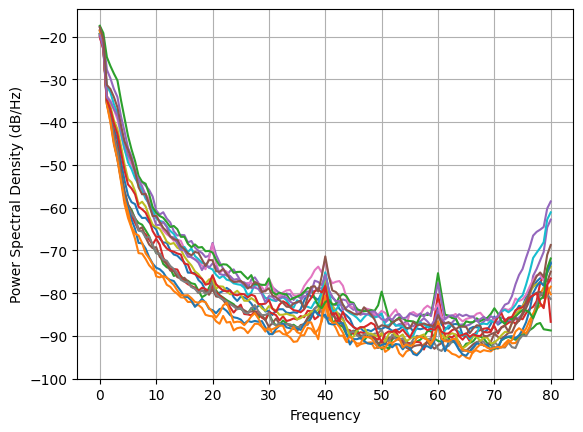

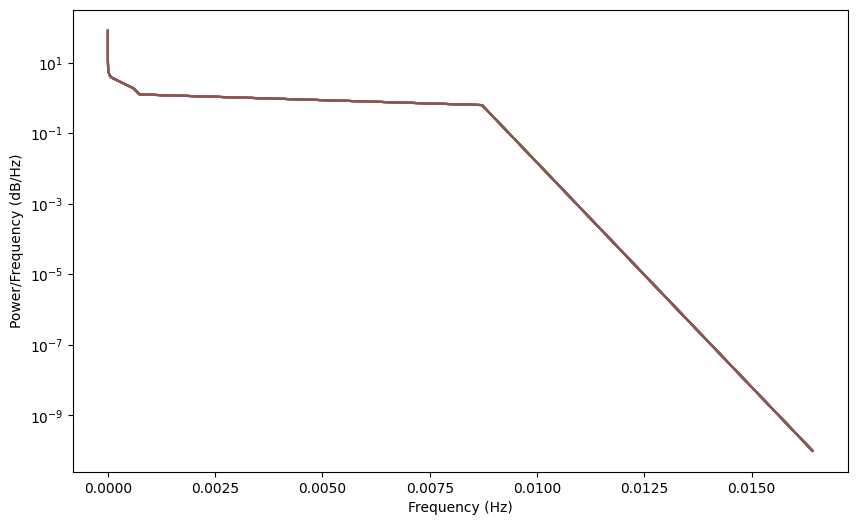

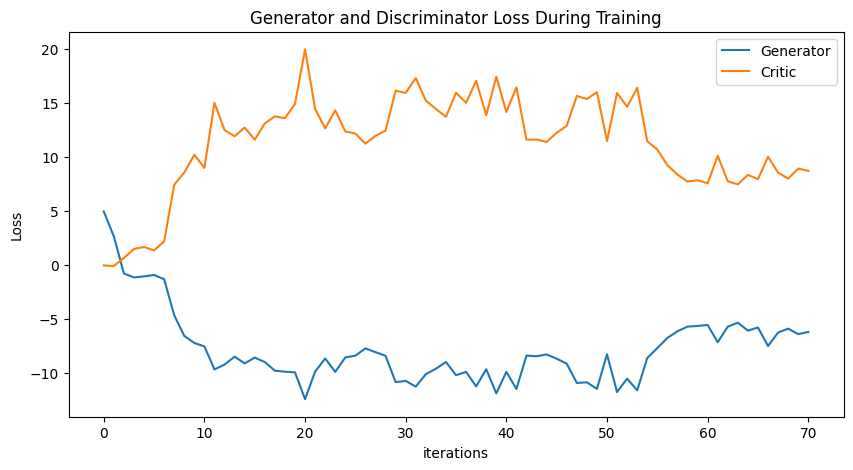

Epoch 80: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.8495

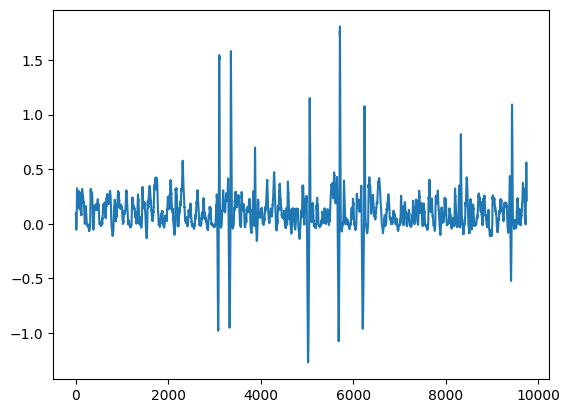

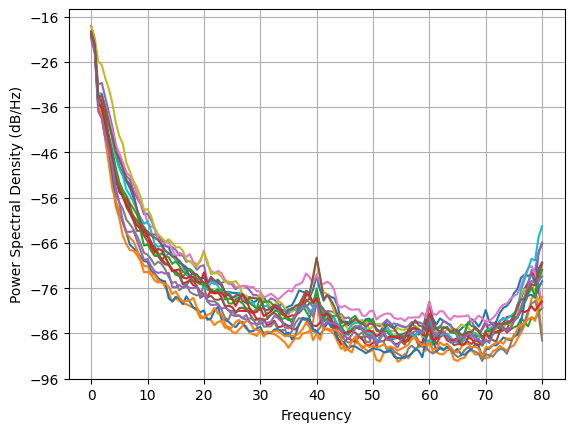

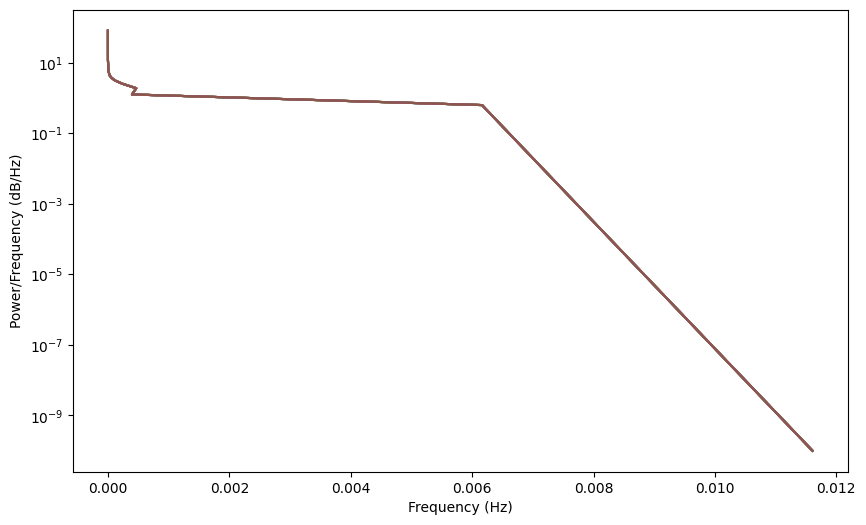

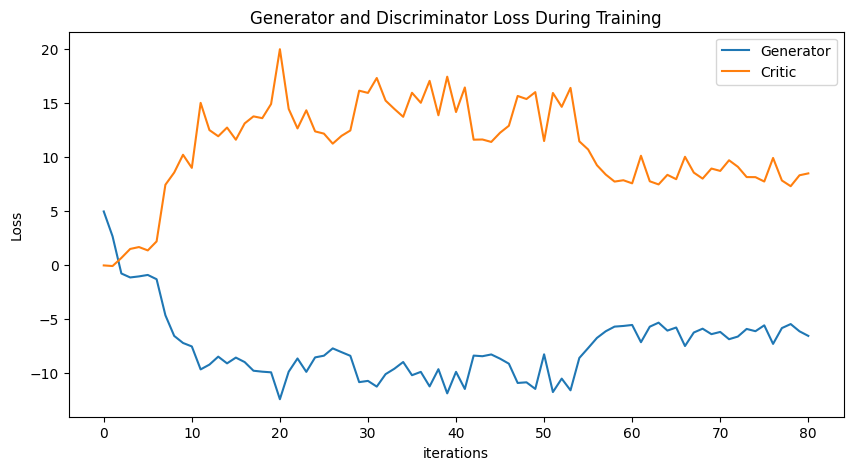

Epoch 90: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.8495

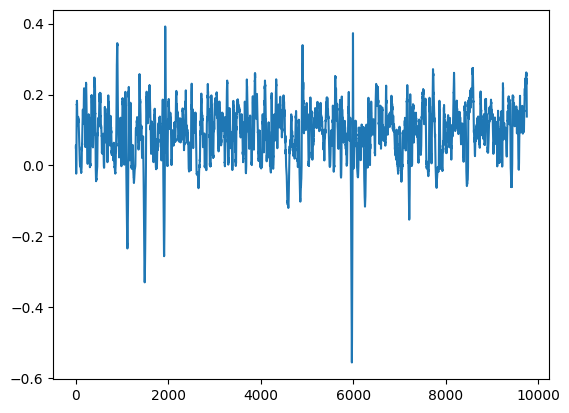

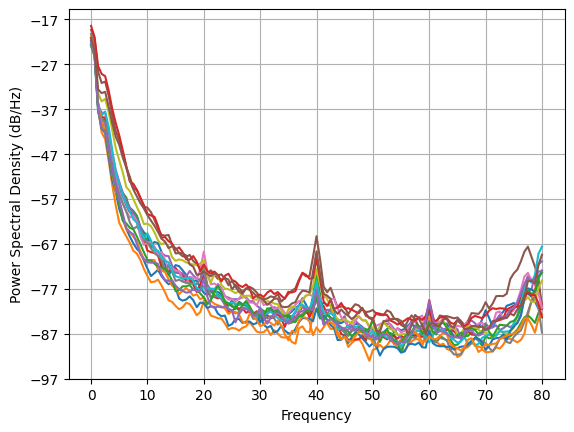

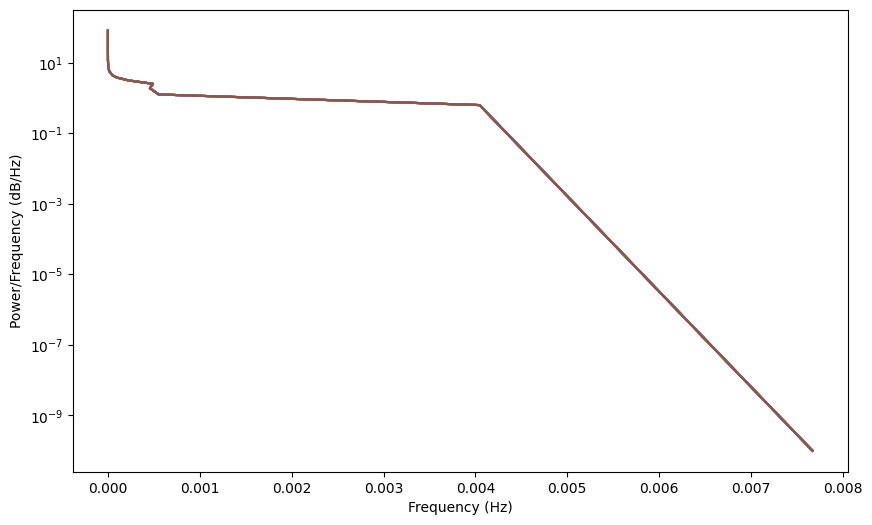

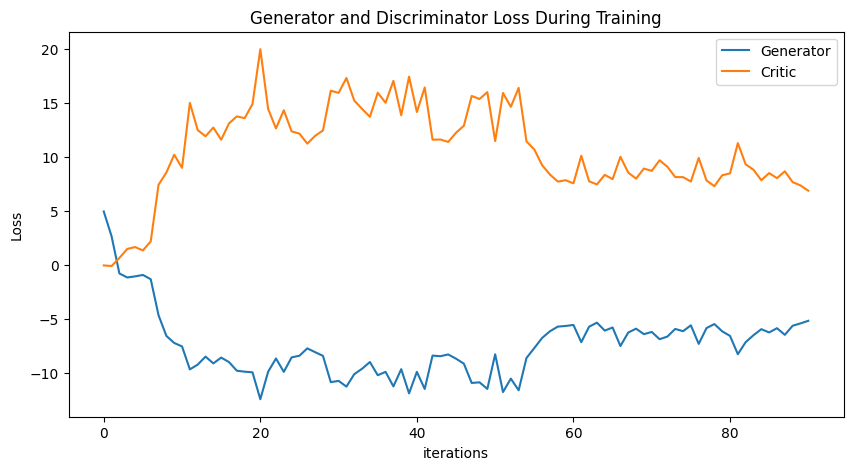

Epoch 100: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

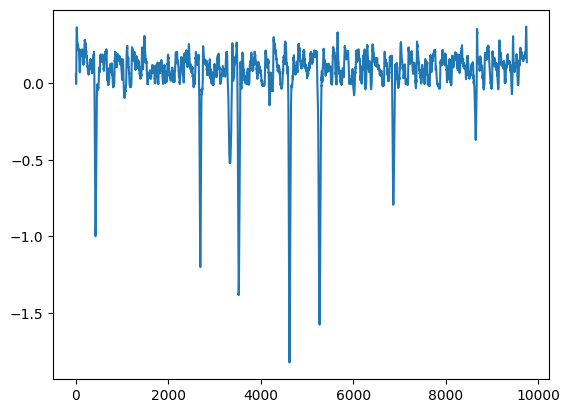

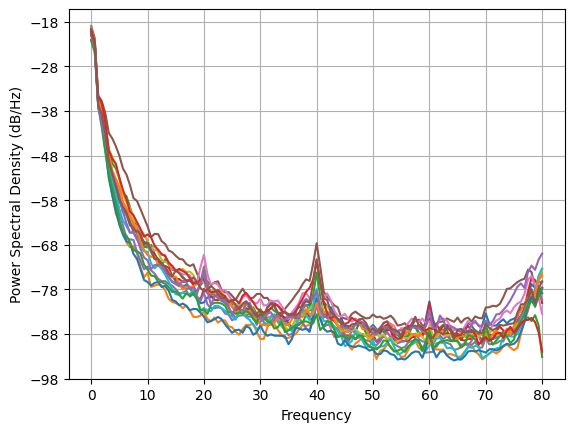

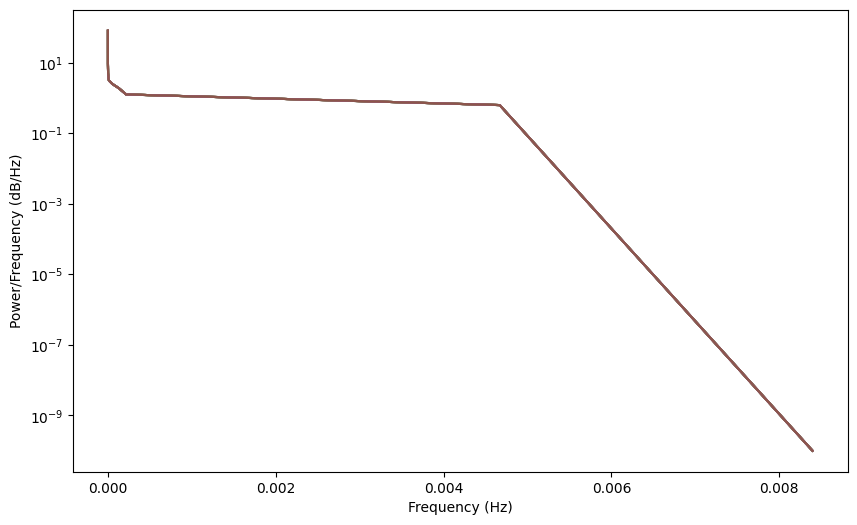

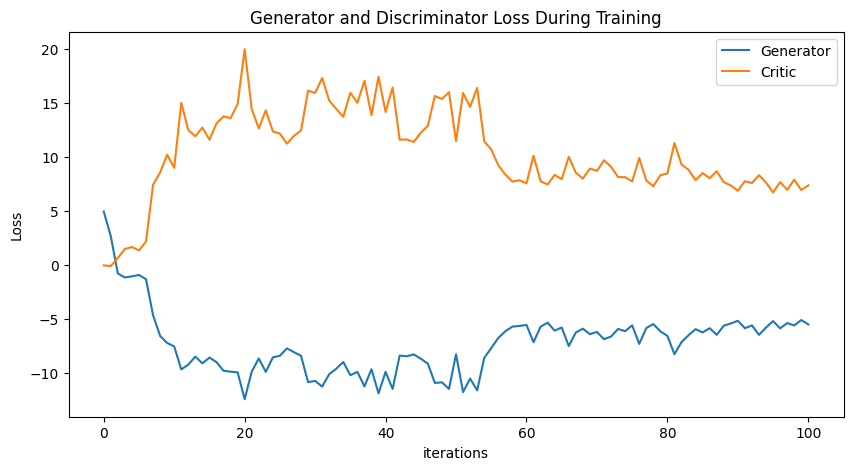

Epoch 110: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

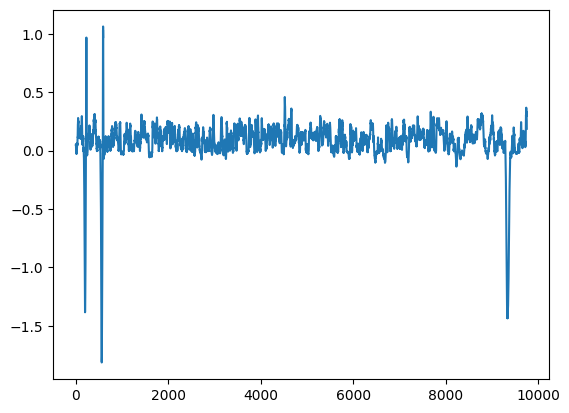

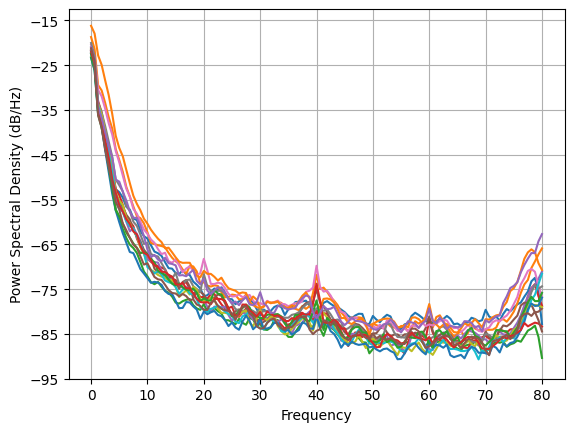

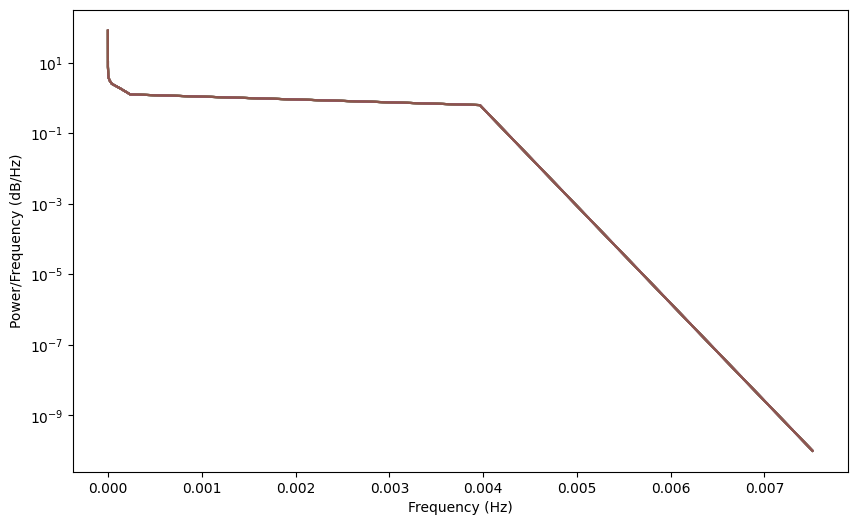

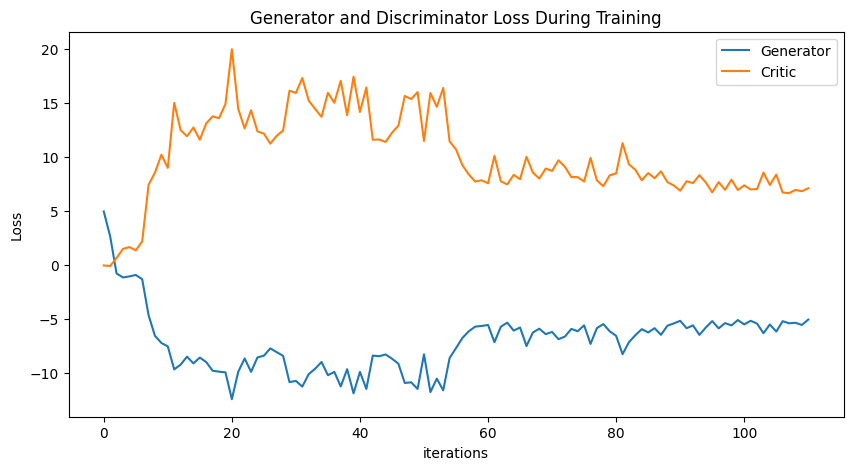

Epoch 120: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

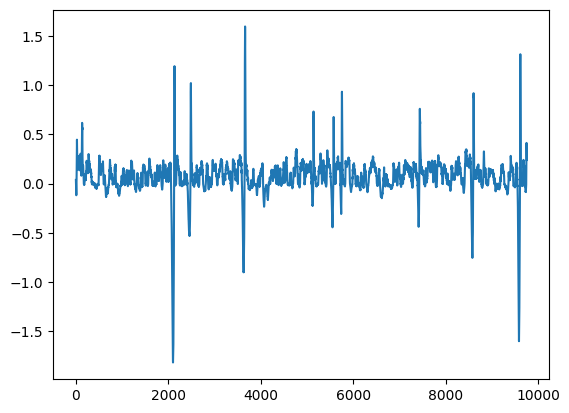

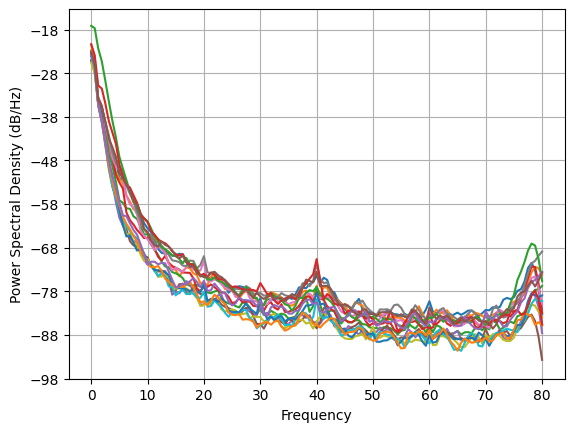

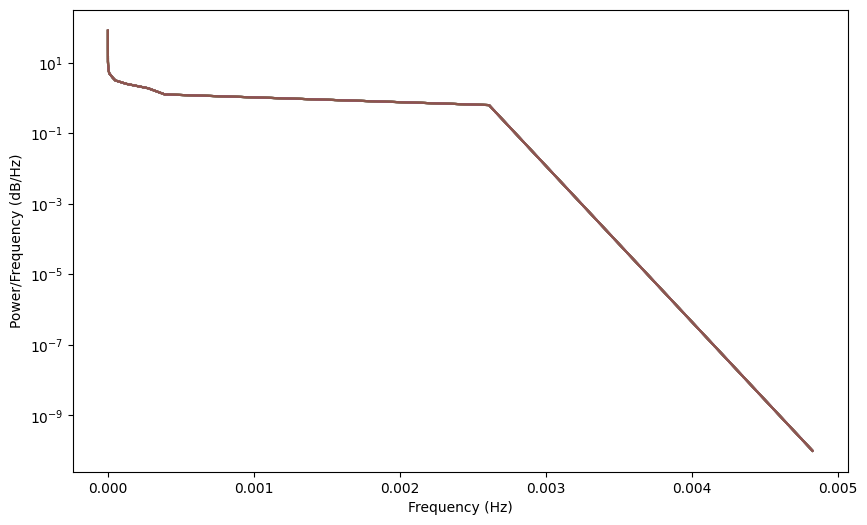

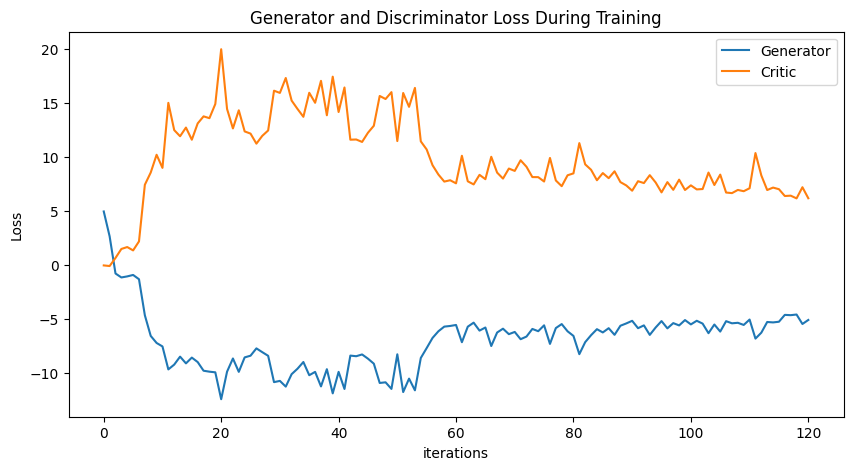

Epoch 130: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

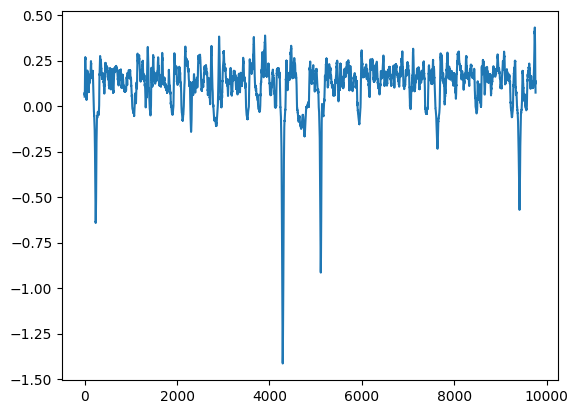

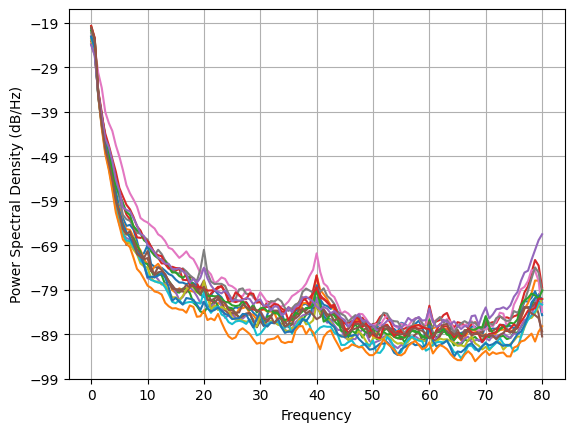

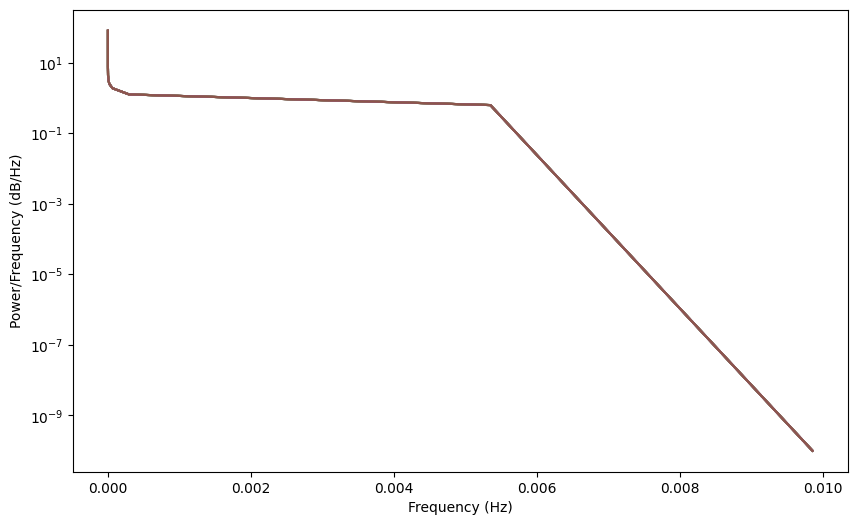

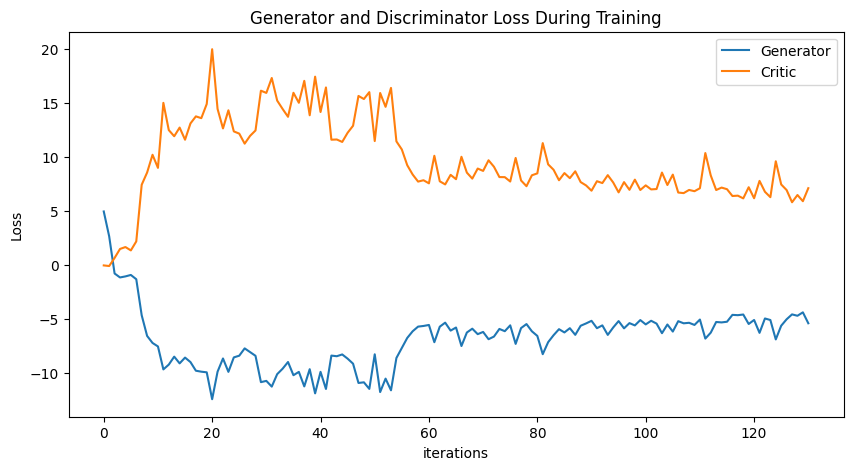

Epoch 140: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

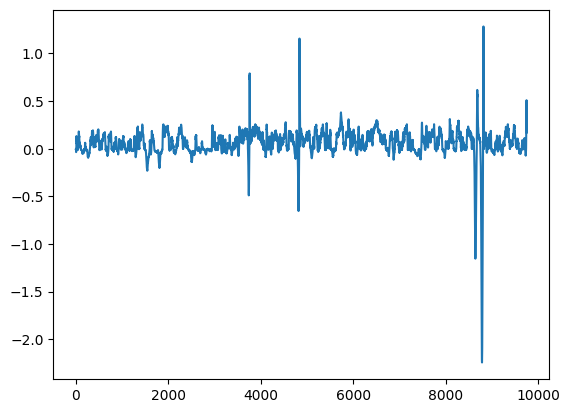

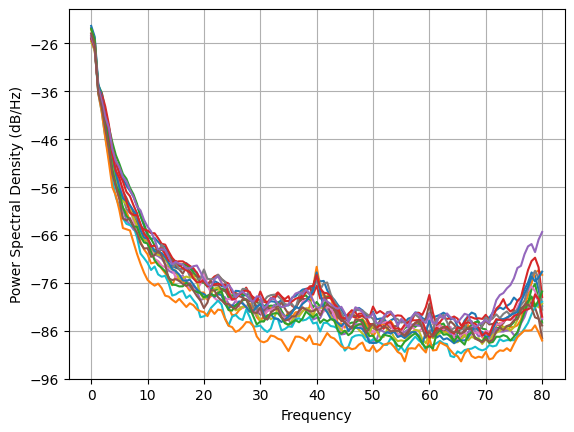

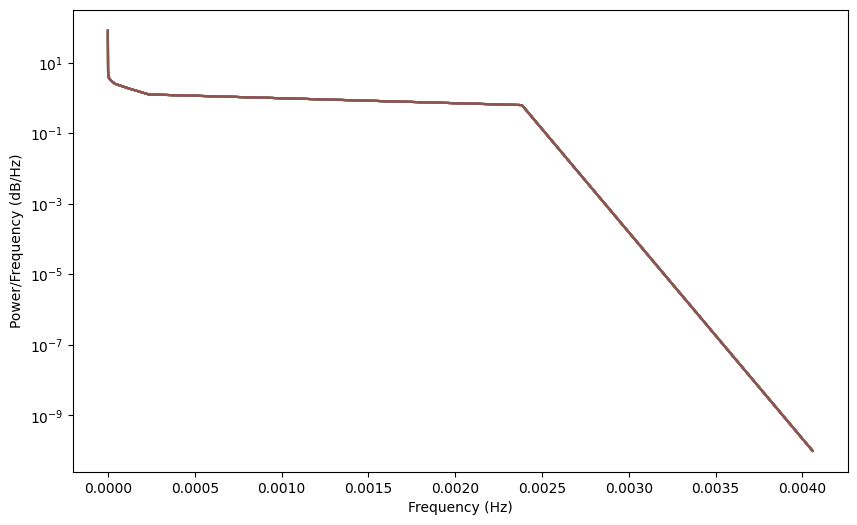

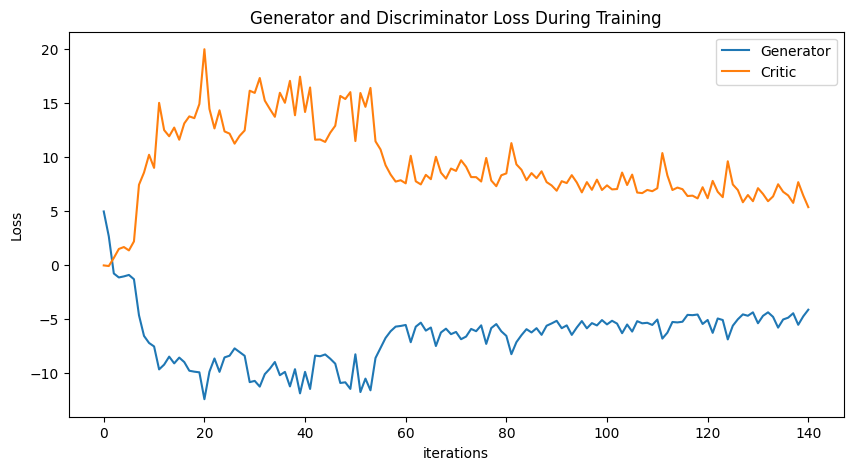

Epoch 150: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

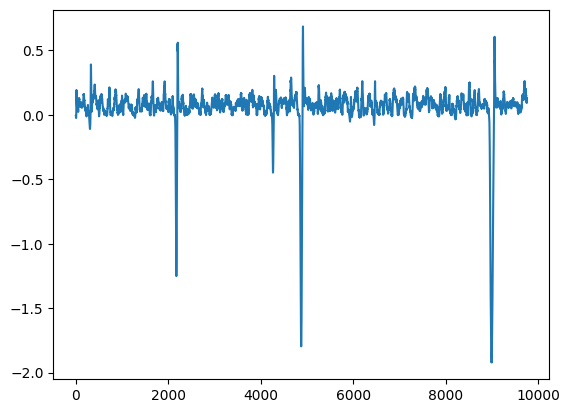

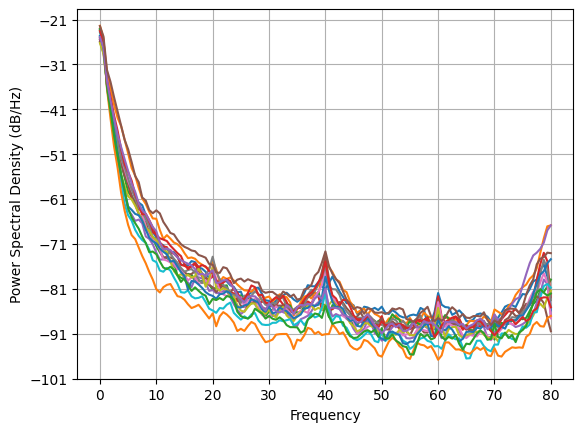

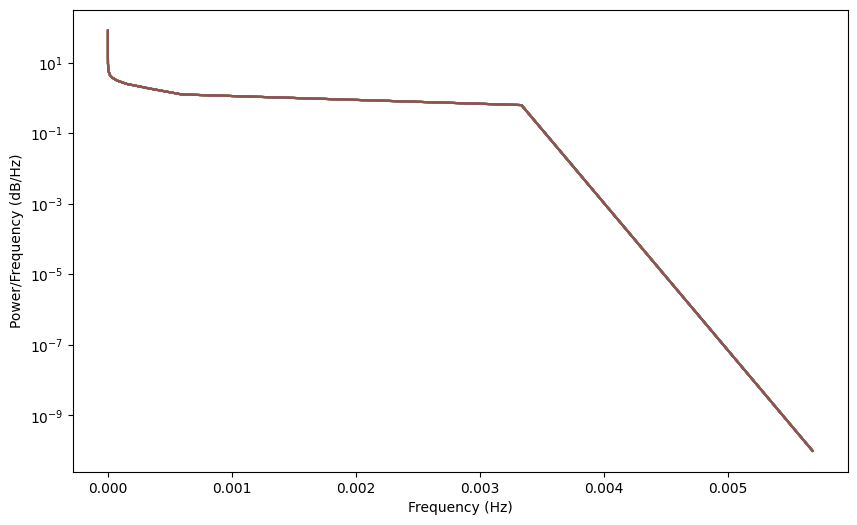

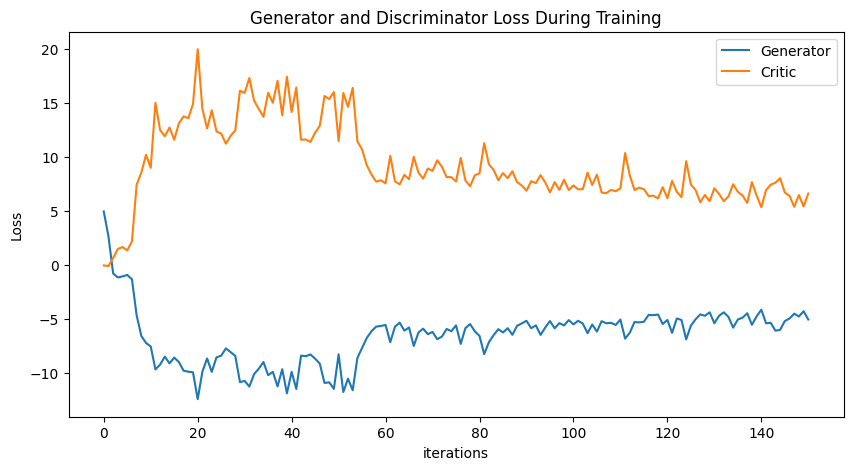

Epoch 160: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

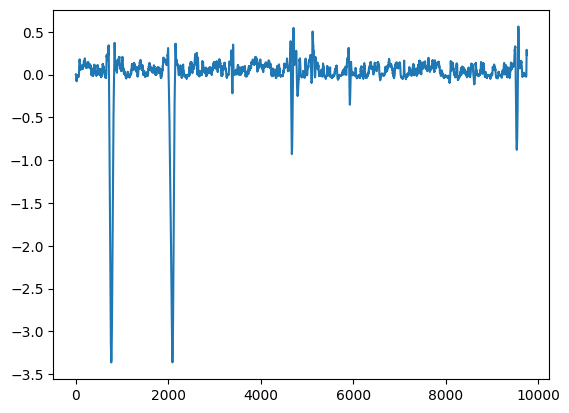

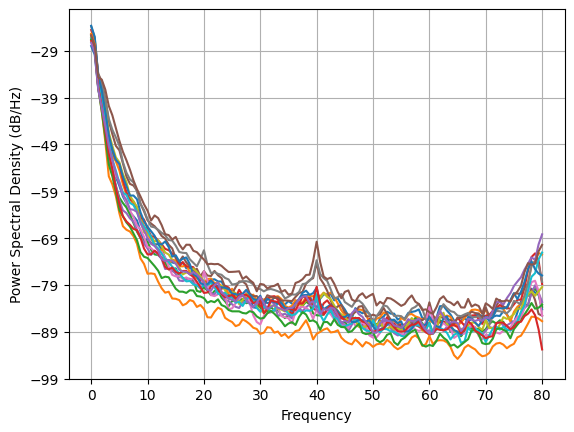

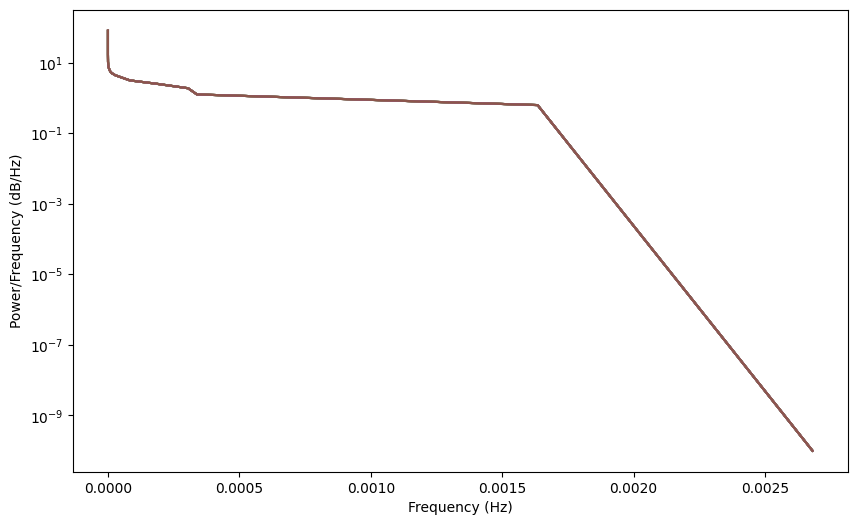

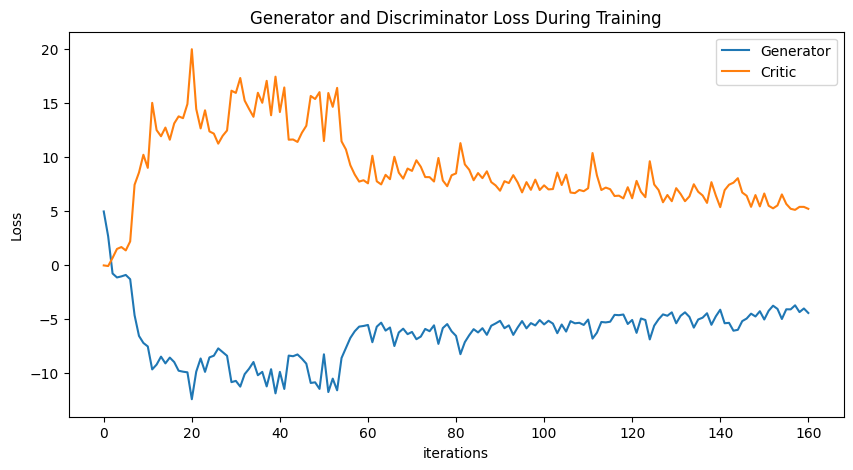

Epoch 170: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

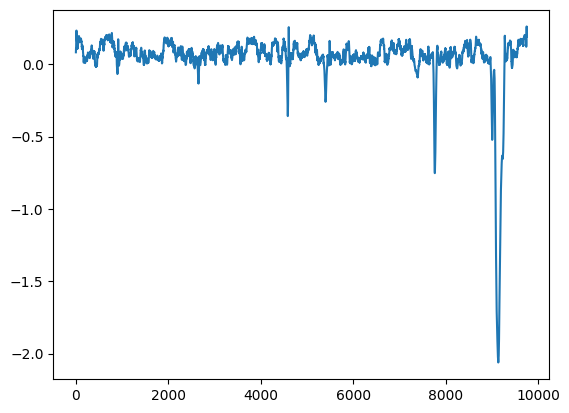

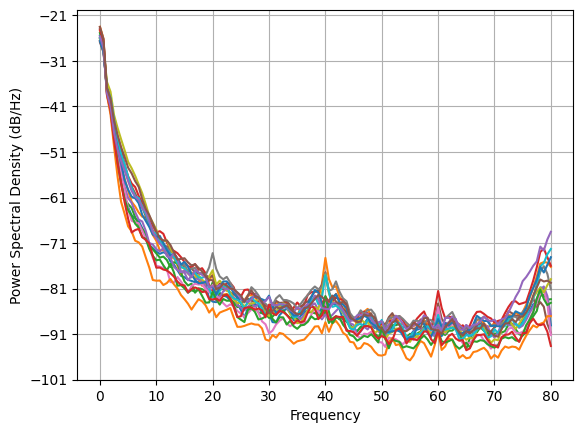

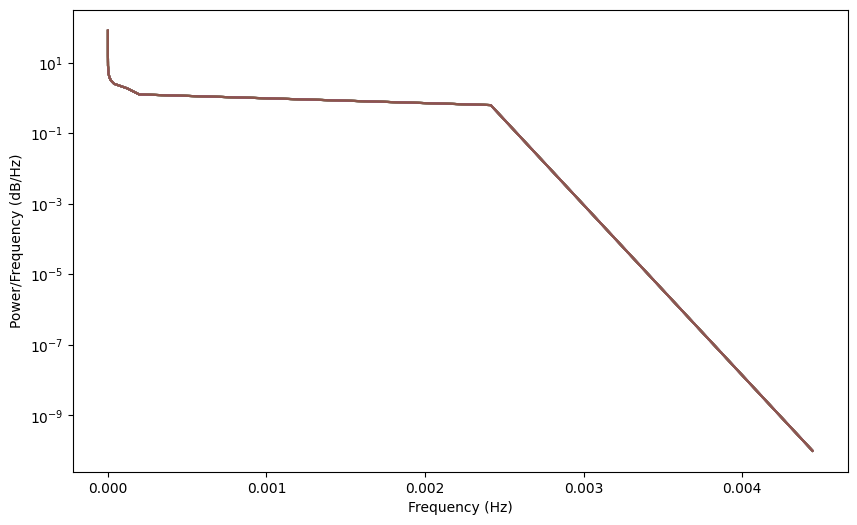

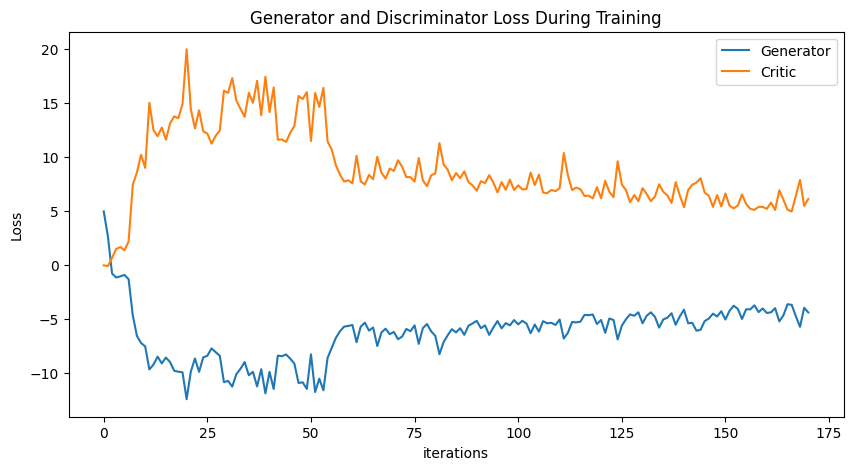

Epoch 180: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

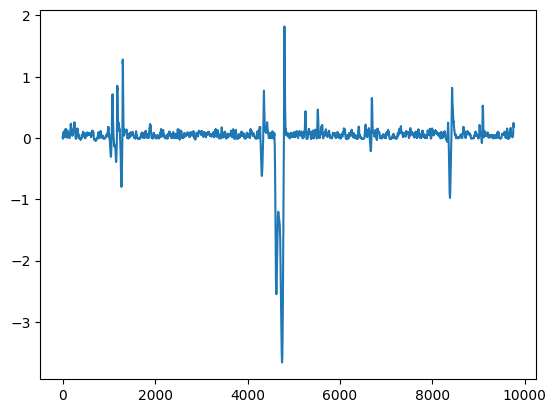

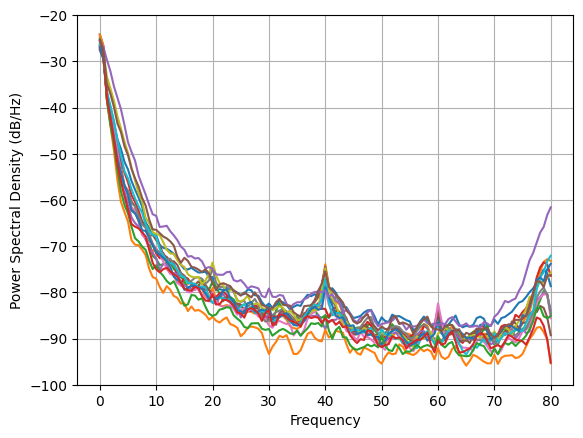

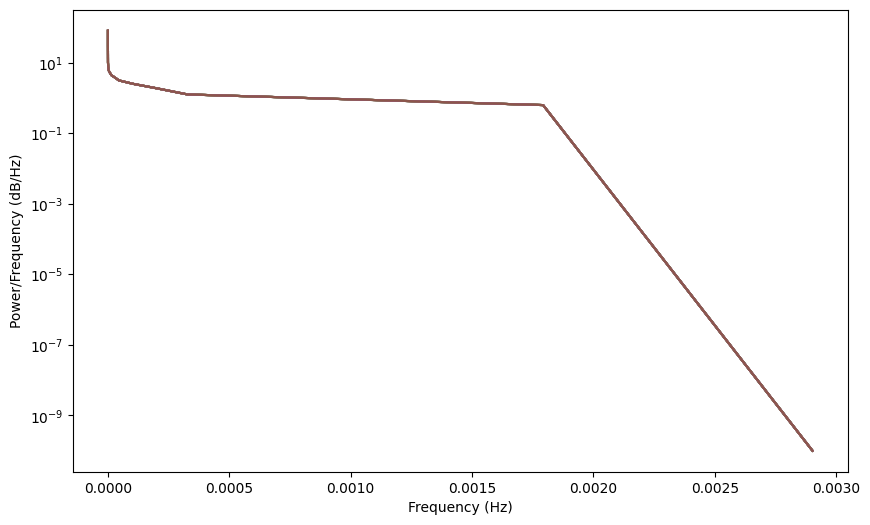

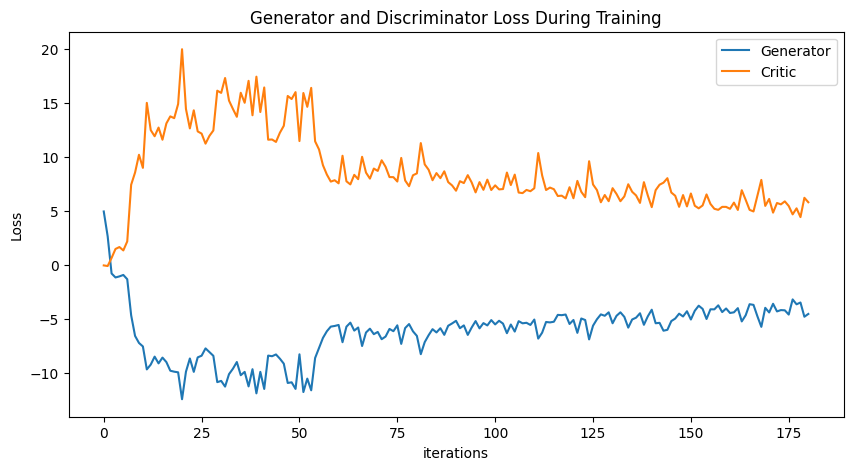

Epoch 190: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

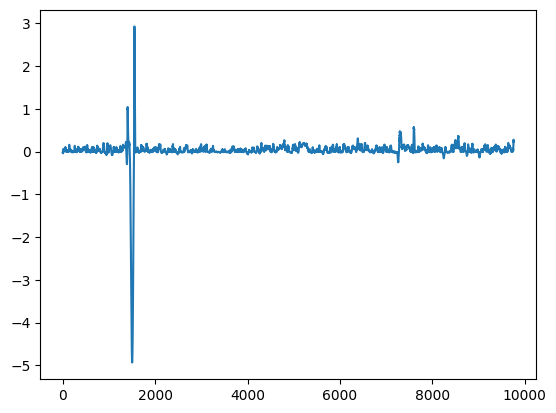

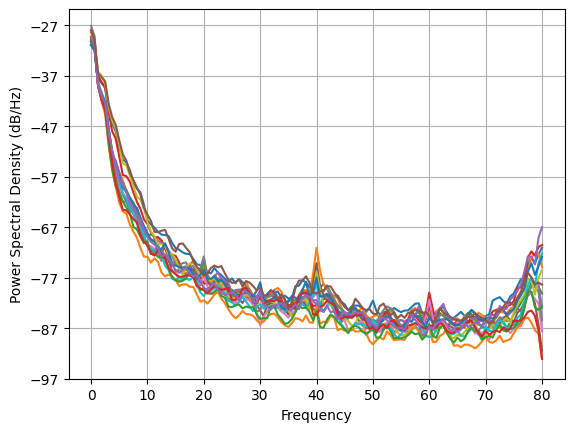

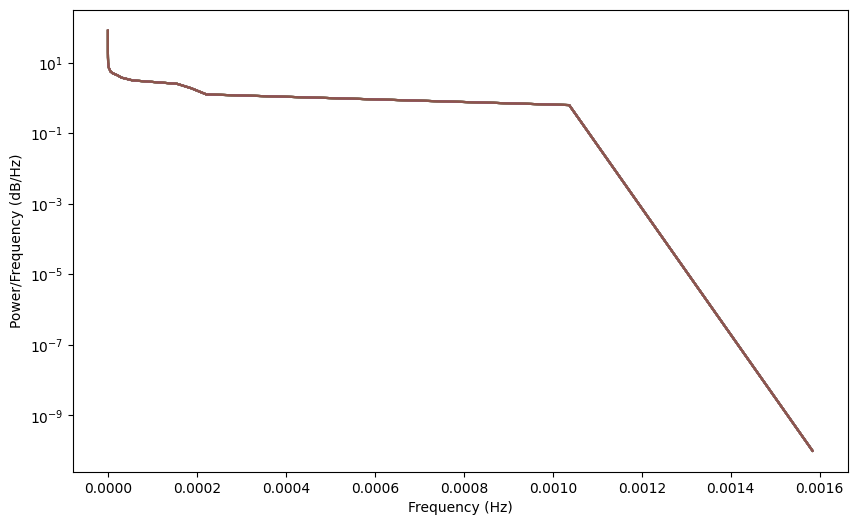

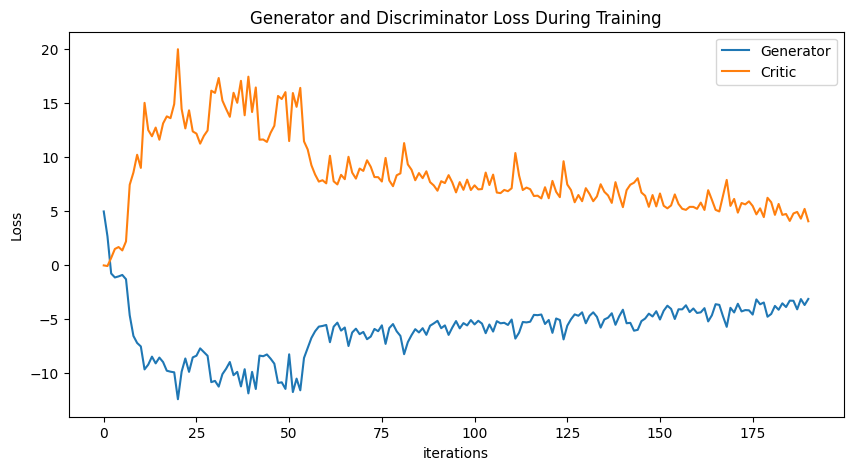

Epoch 200: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

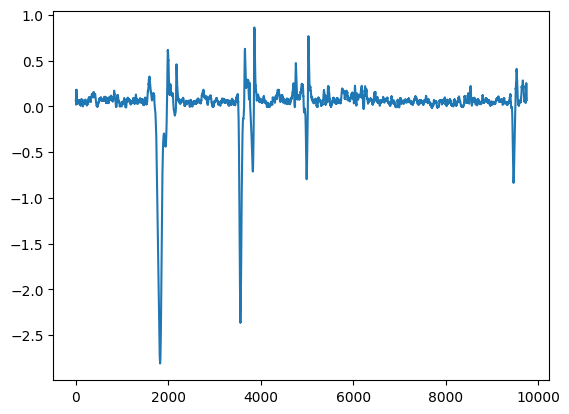

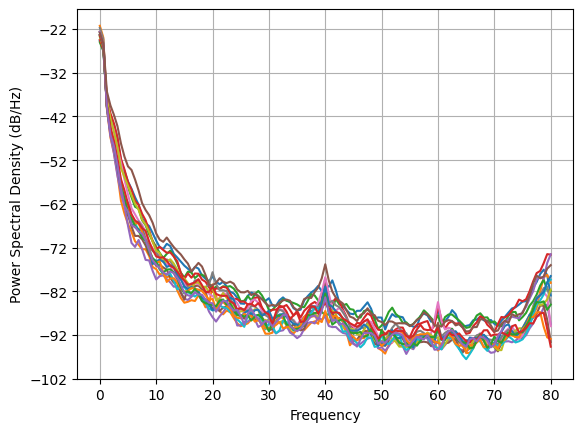

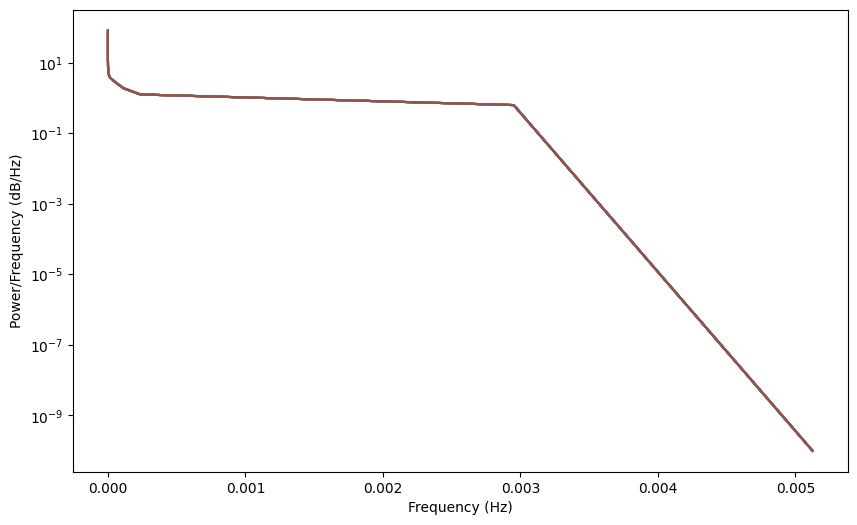

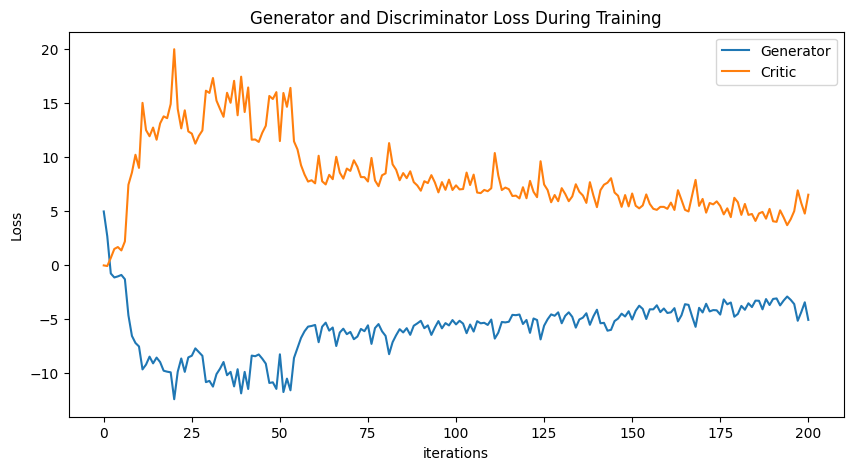

Epoch 210: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

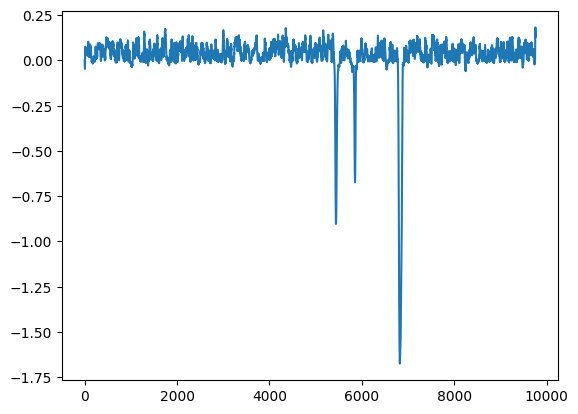

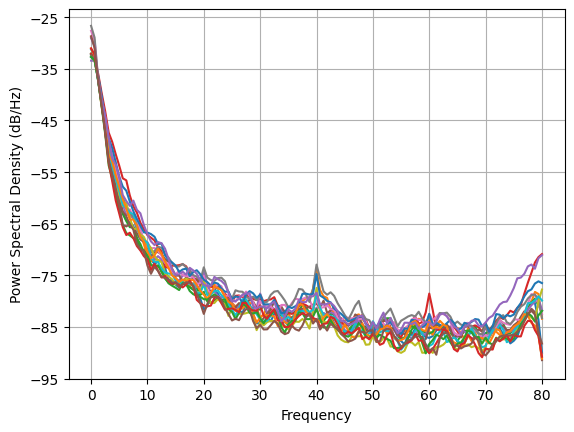

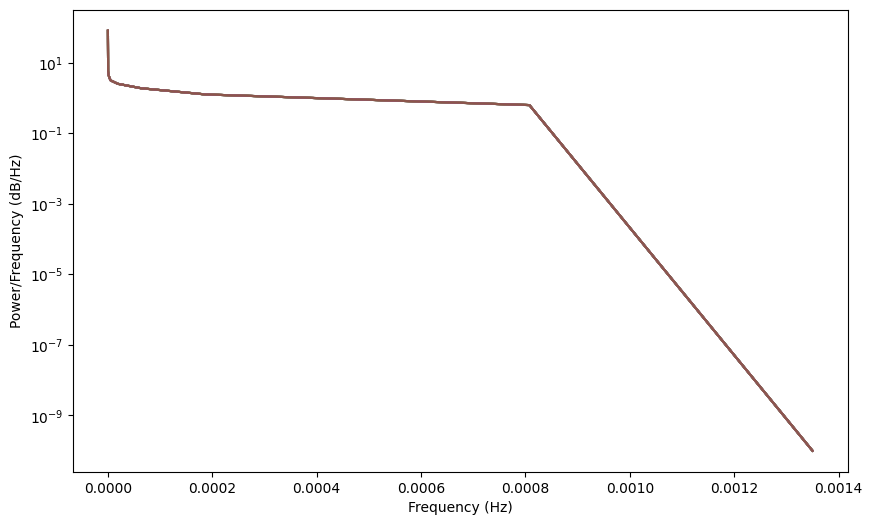

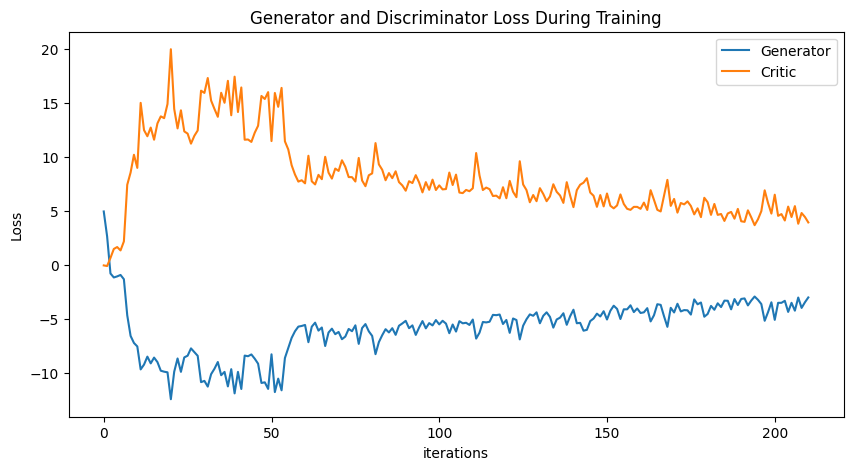

Epoch 220: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

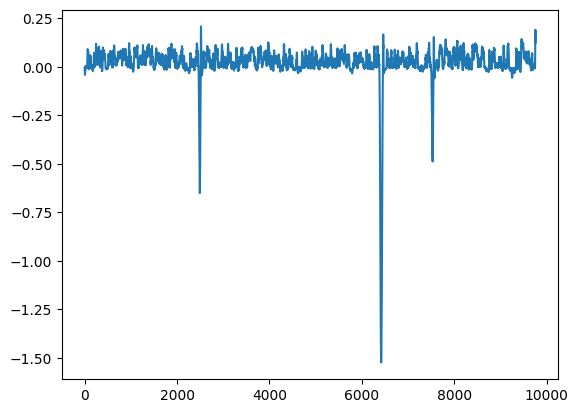

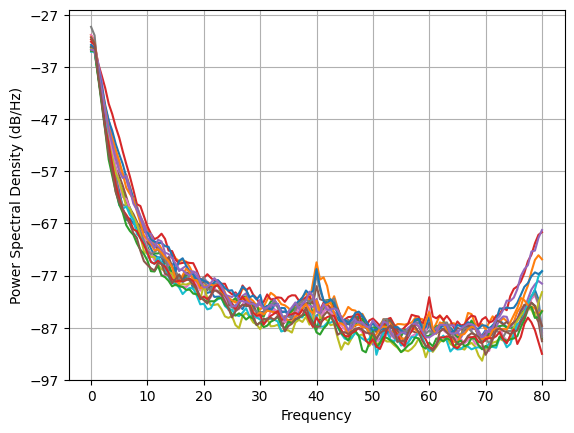

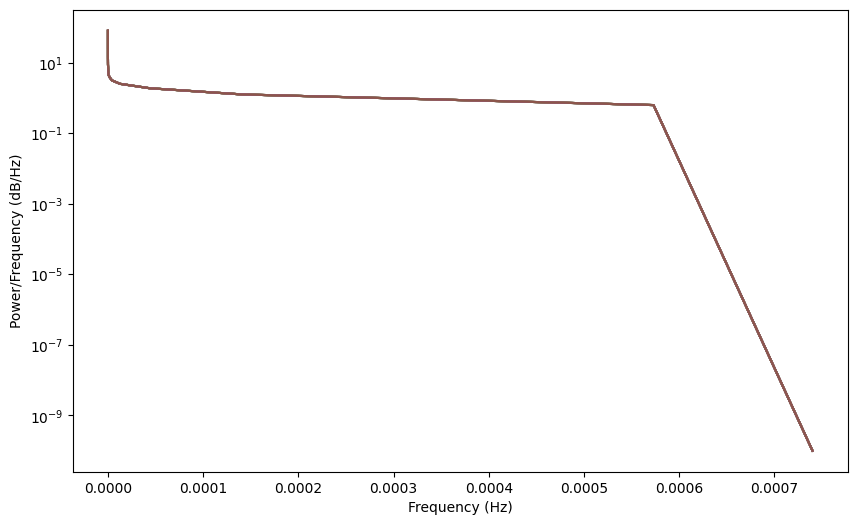

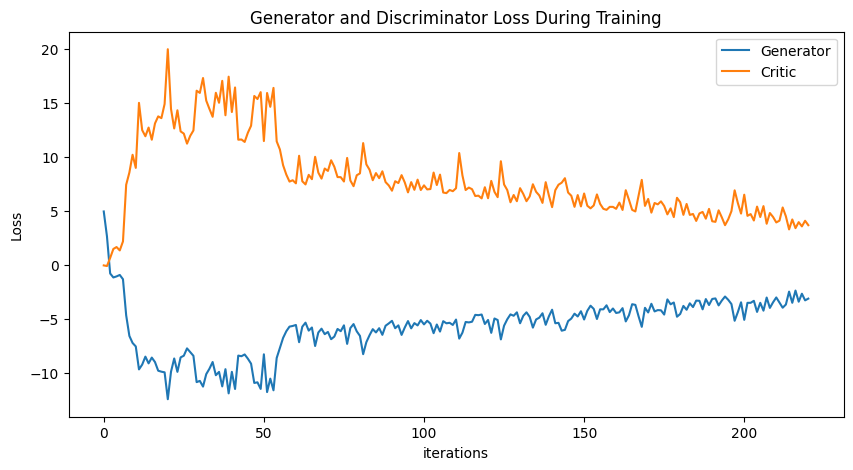

Epoch 230: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

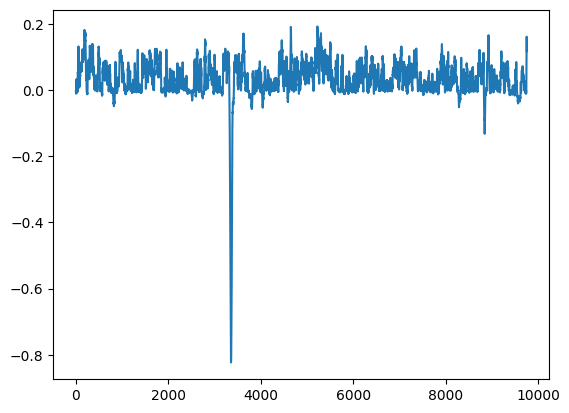

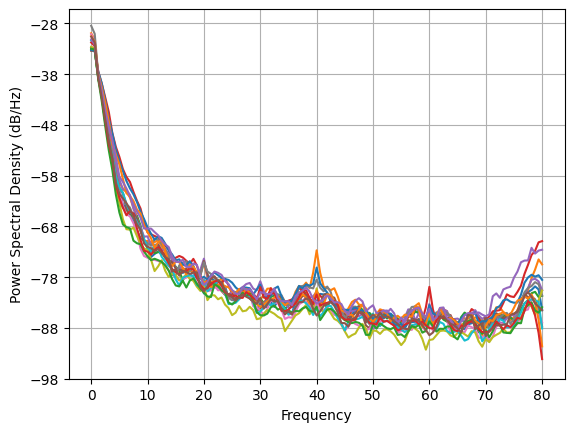

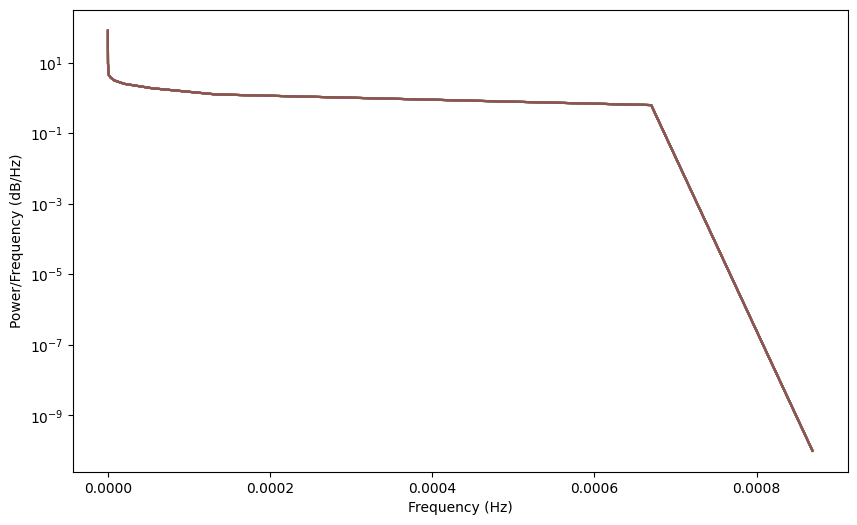

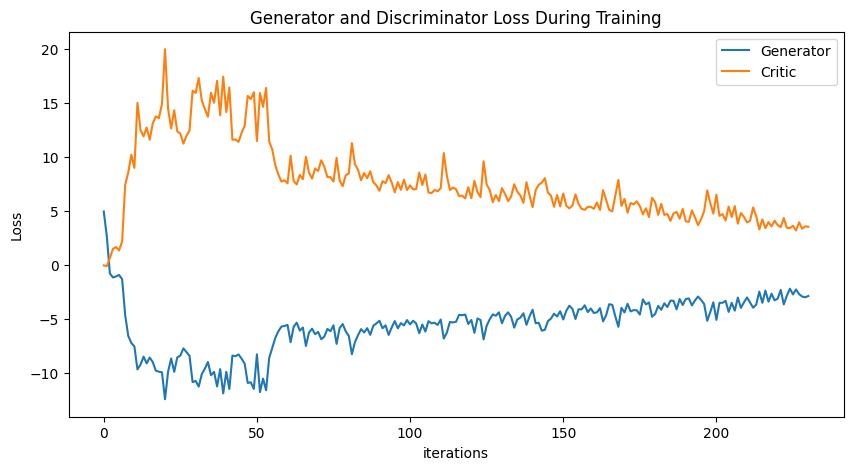

Epoch 240: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

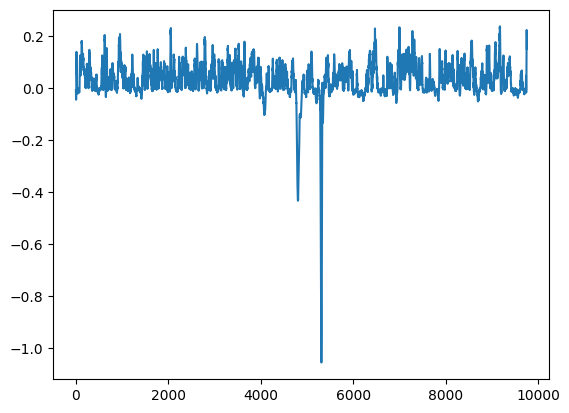

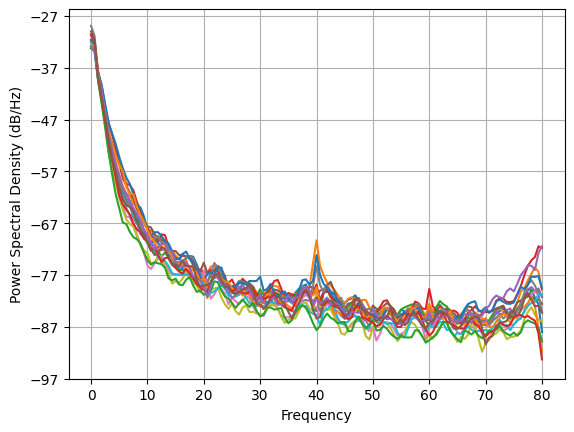

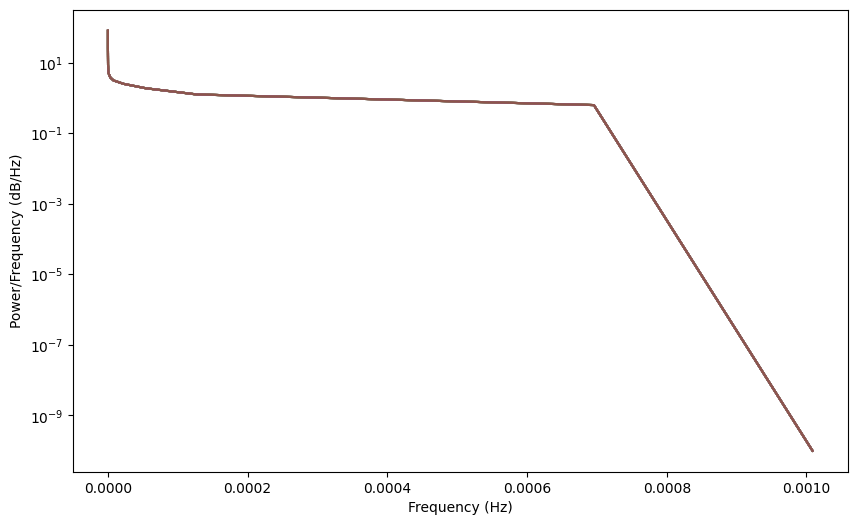

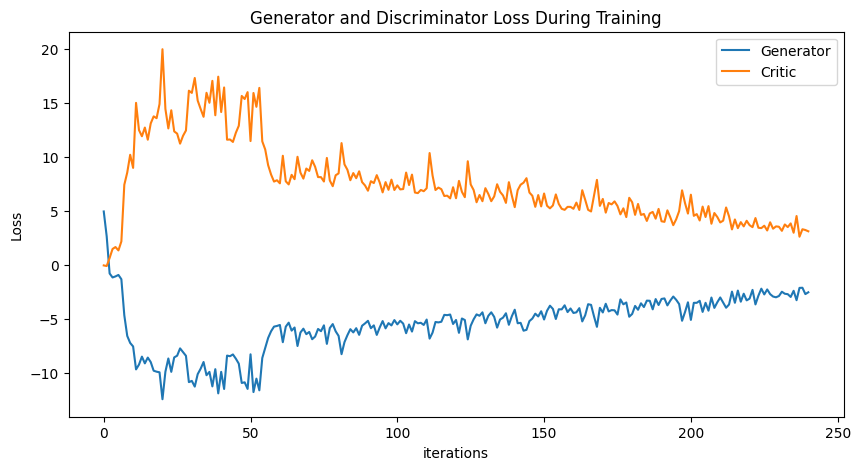

Epoch 250: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

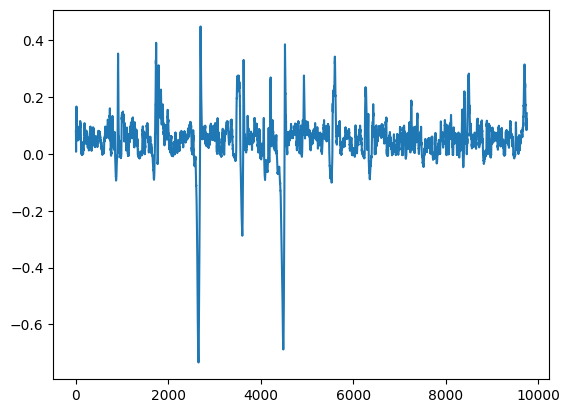

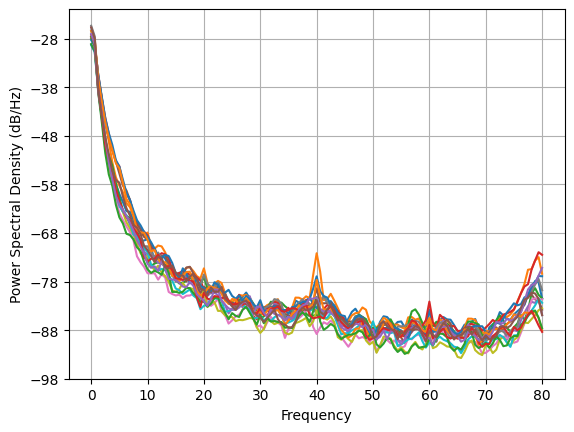

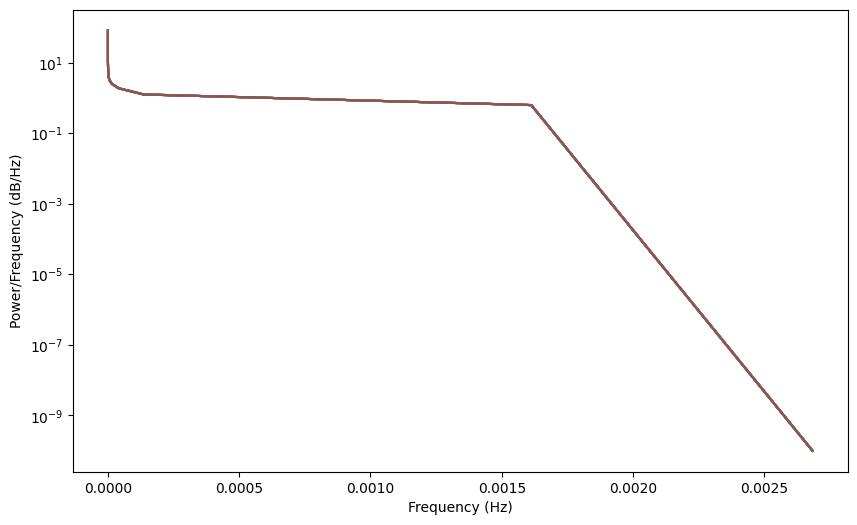

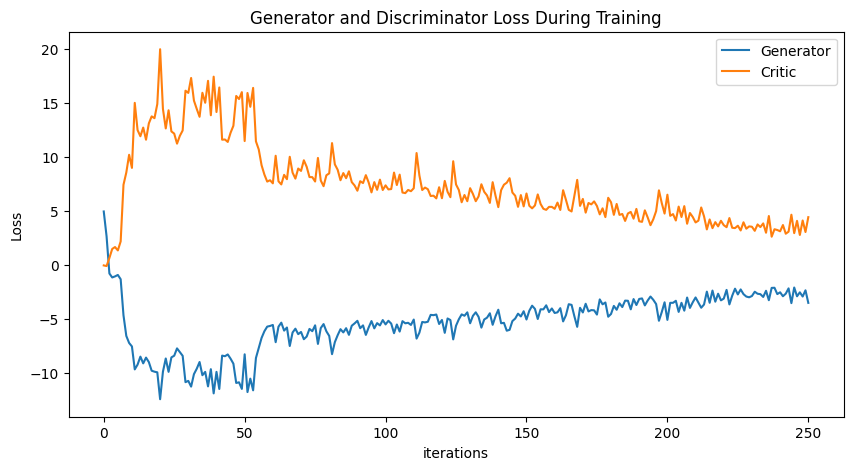

Epoch 260: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

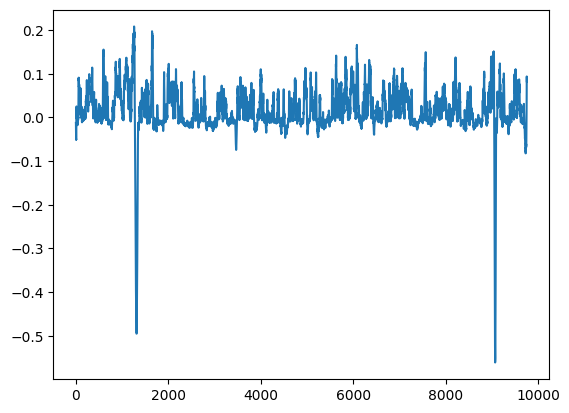

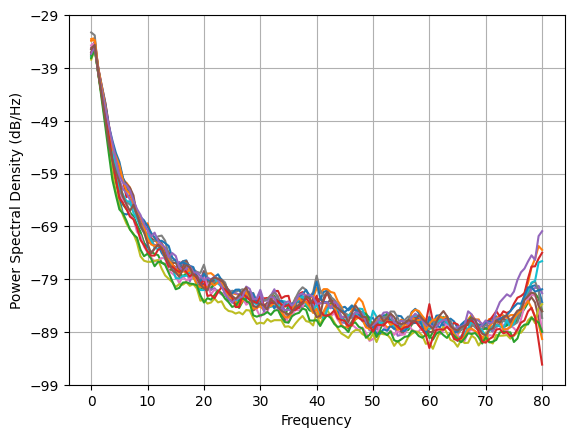

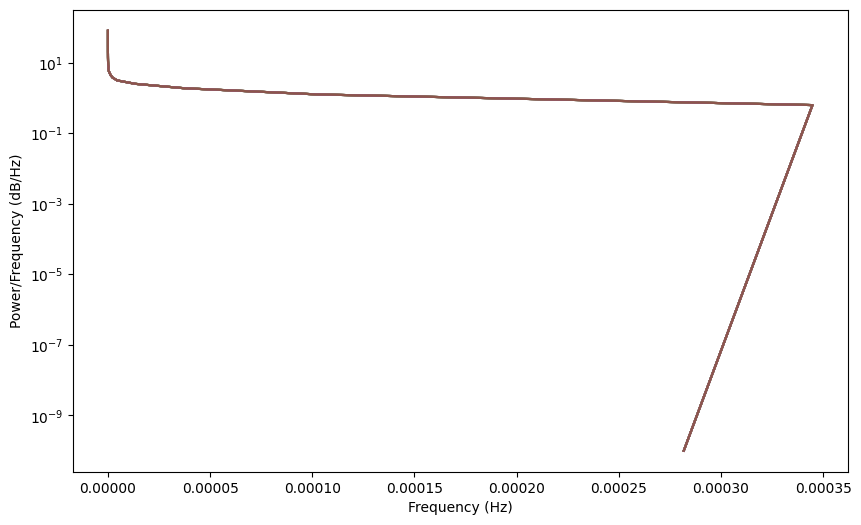

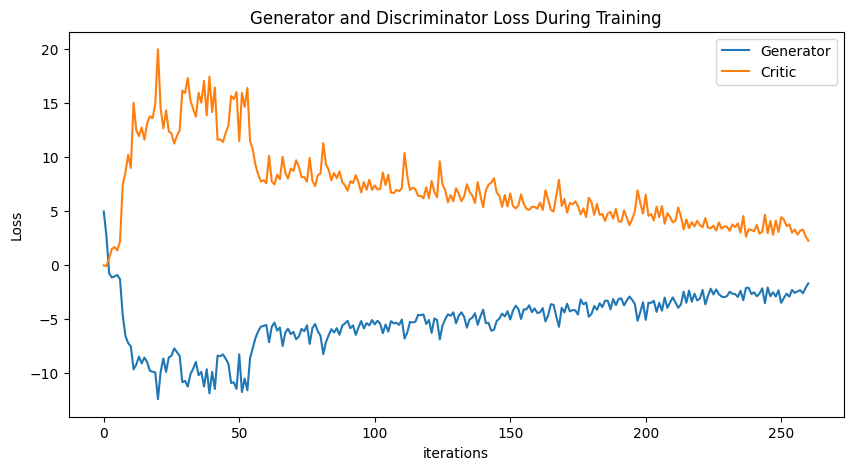

Epoch 270: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

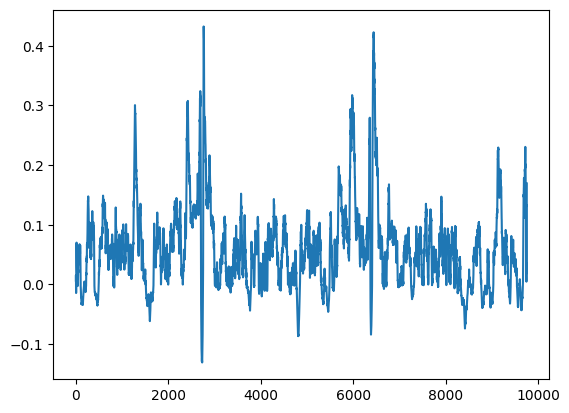

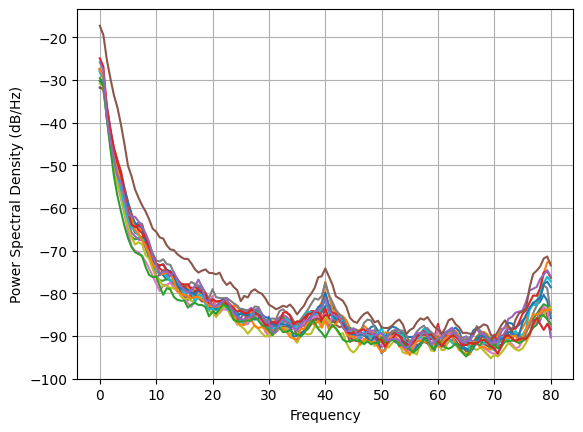

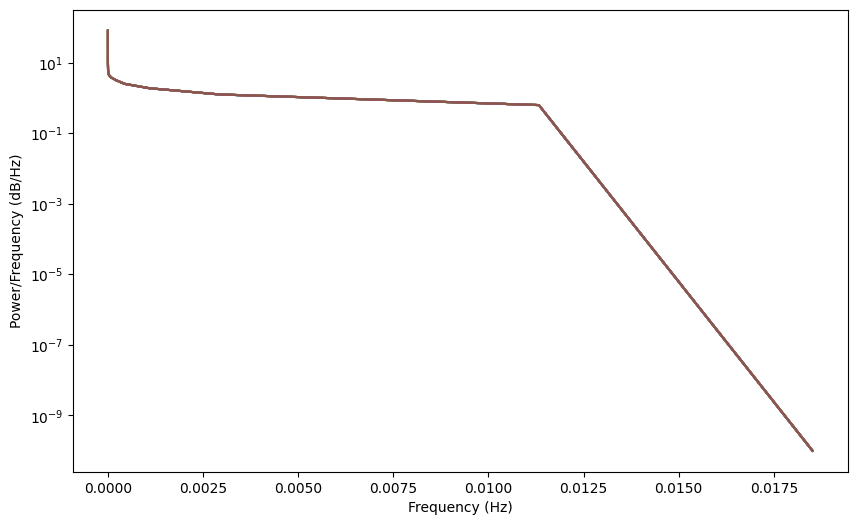

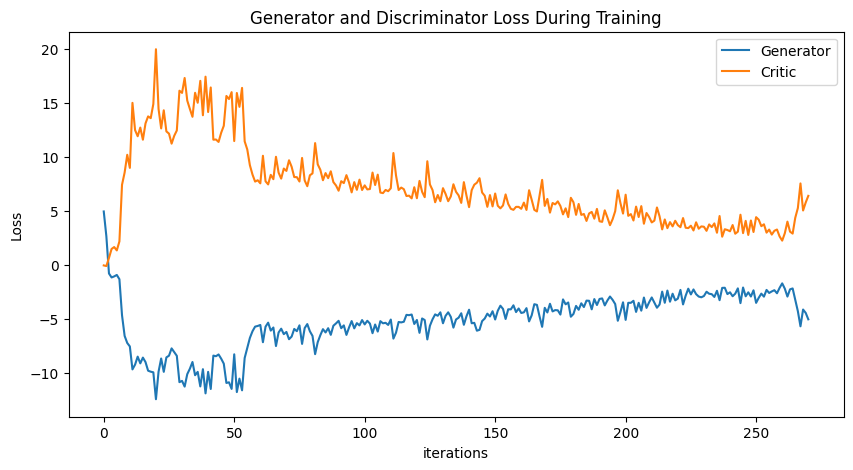

Epoch 280: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

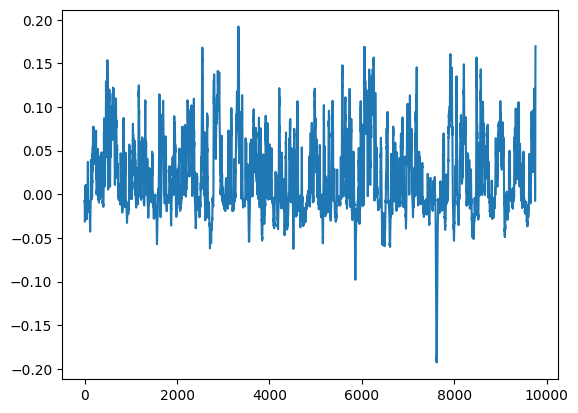

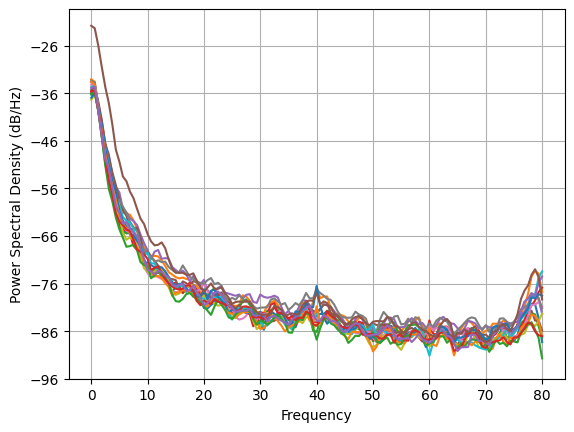

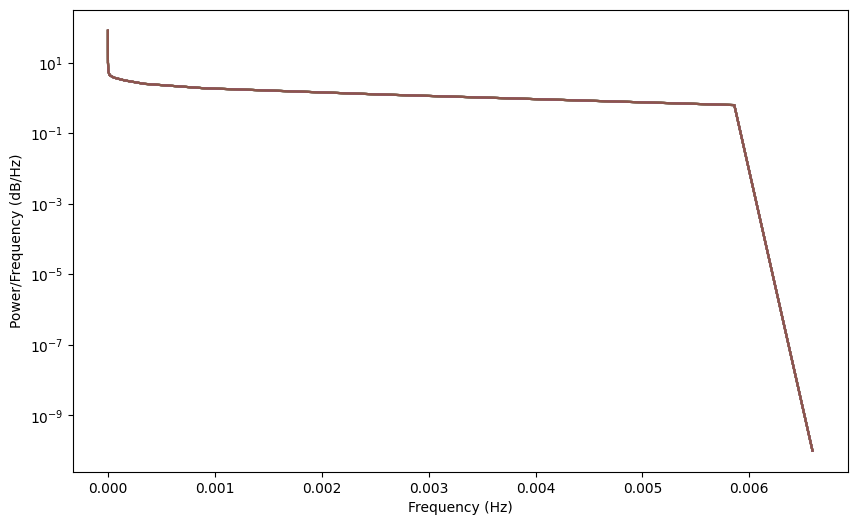

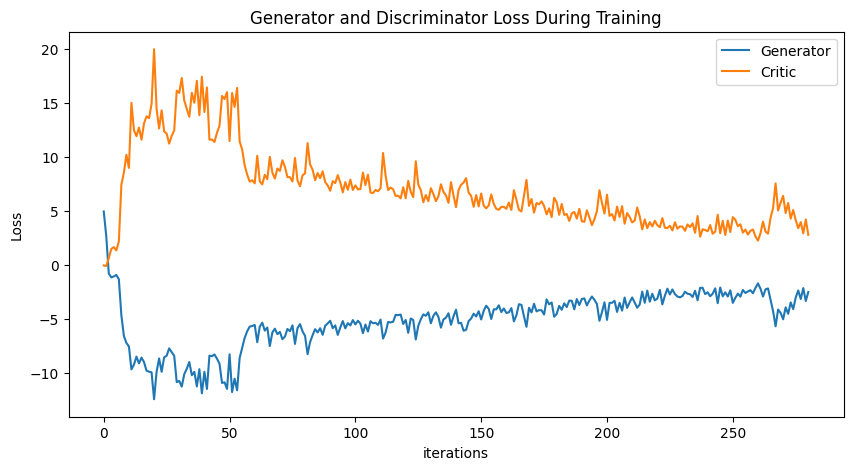

Epoch 290: Critic error ([4.943850766774254, 2.6468021878165926, -0.7897035723475675, -1.156460552424154, -1.0585547898704633, -0.9246075142372522, -1.3196050948315121, -4.652206604717204, -6.560651700308254, -7.211643752954347, -7.53323621885931, -9.65559549787386, -9.212728362355818, -8.475632238710837, -9.098417516589262, -8.564238431521149, -8.978730244249265, -9.77826266498696, -9.866603774165682, -9.925830193156072, -12.41242279856032, -9.867263906337044, -8.645717693516215, -9.883013808540491, -8.545503992502153, -8.389604160859772, -7.712760002751889, -8.061929927423927, -8.399789362127056, -10.833268778538887, -10.717703419040342, -11.246306186026816, -10.095568758365003, -9.593459612471404, -8.972184486372752, -10.193099486379612, -9.884928176496448, -11.228473993849923, -9.636240004971924, -11.871603830221684, -9.883212799860123, -11.46467892602977, -8.379478283992379, -8.43762616742557, -8.273660471089881, -8.664676260229824, -9.126818963197632, -10.909279419847932, -10.849

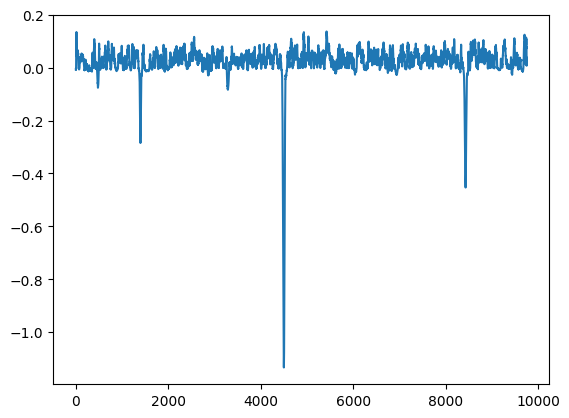

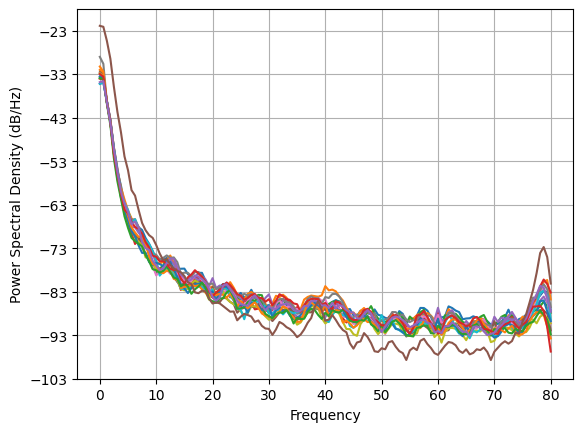

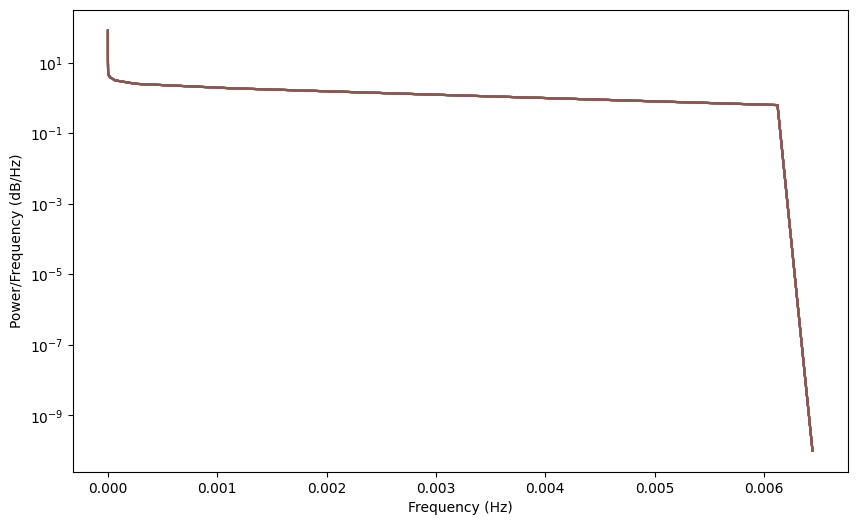

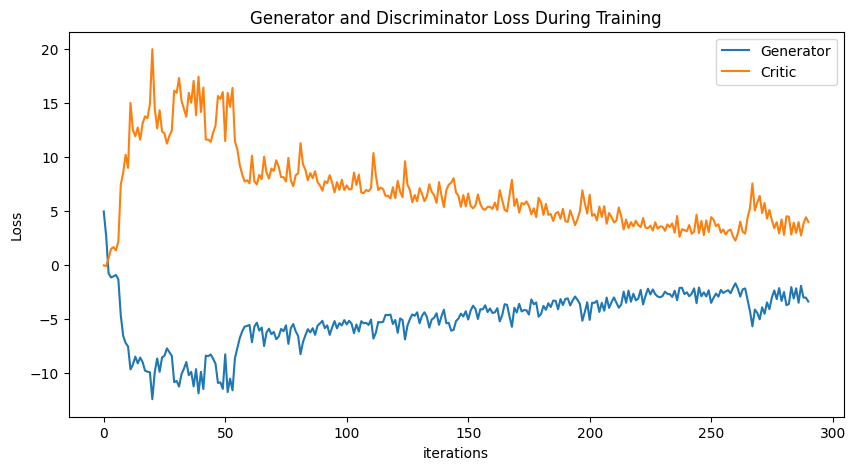

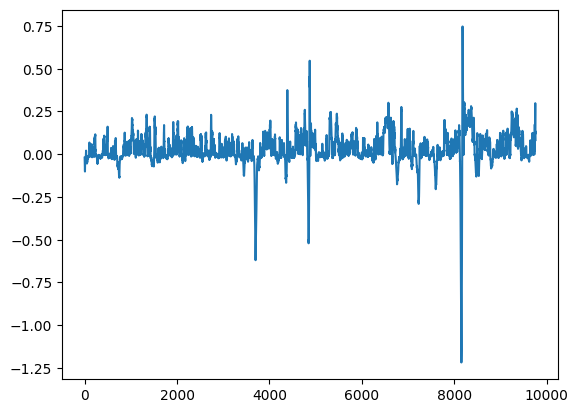

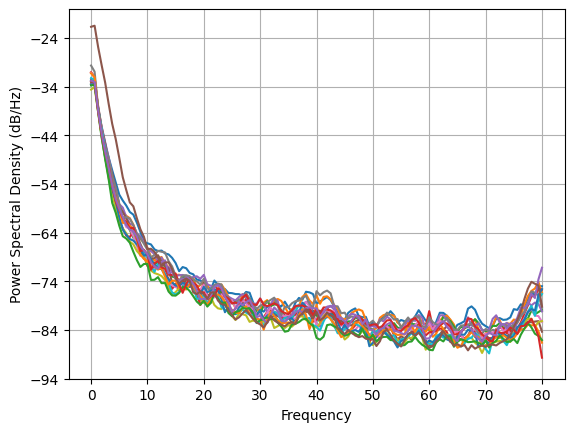

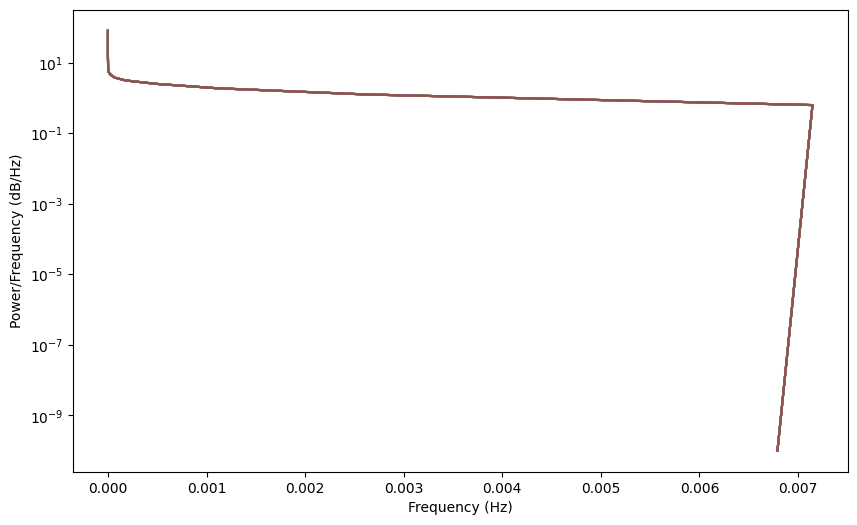

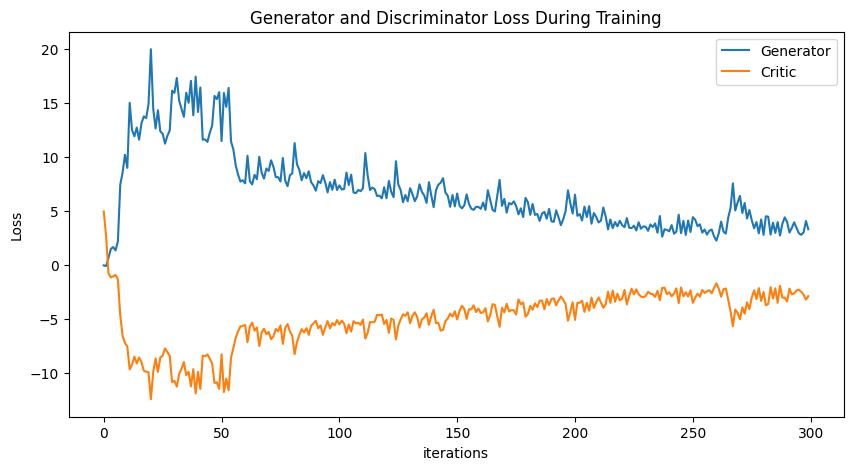

In [54]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch.pt')
torch.save(disc, 'disc_16ch.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

Epoch 0: Critic error ([4.917045953827386]) Generator err ([0.01386235561221838])


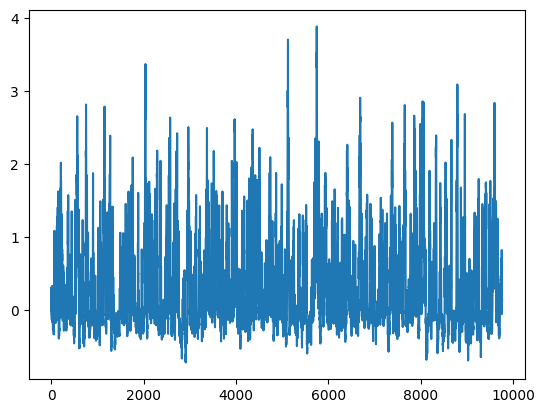

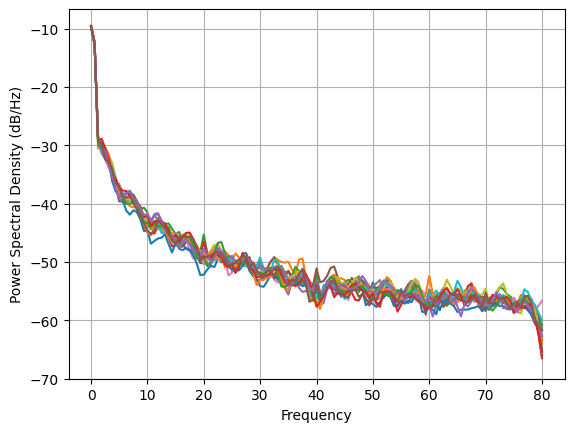

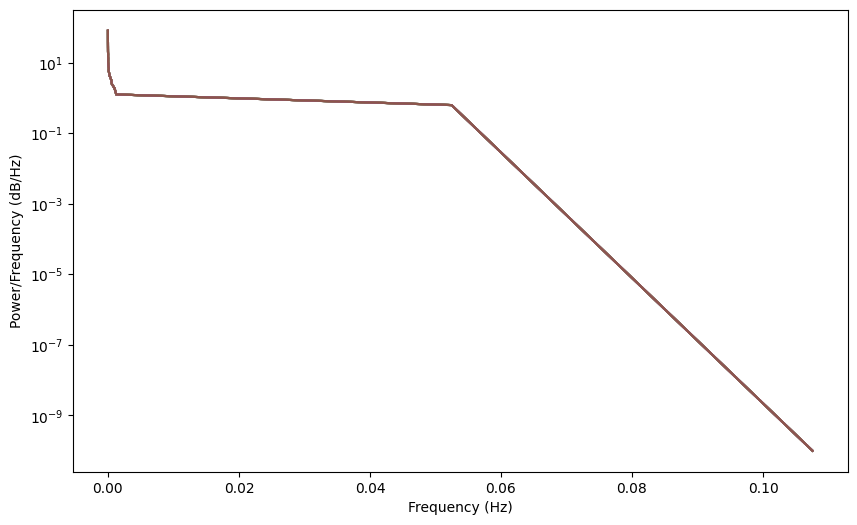

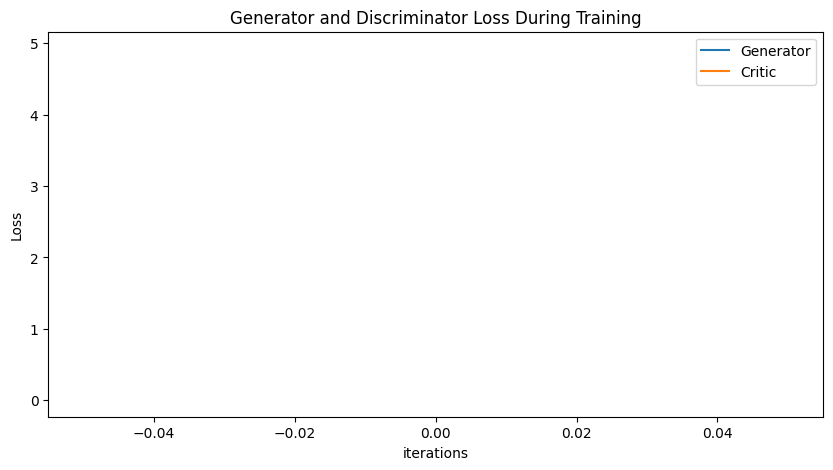

Epoch 10: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607]) Generator err ([0.01386235561221838, 0.20738686621189117, 2.1392900943756104, 2.0115456581115723, 4.213294982910156, 6.019637107849121, 9.479433059692383, 8.571412086486816, 8.922050476074219, 8.684074401855469, 9.726862907409668])


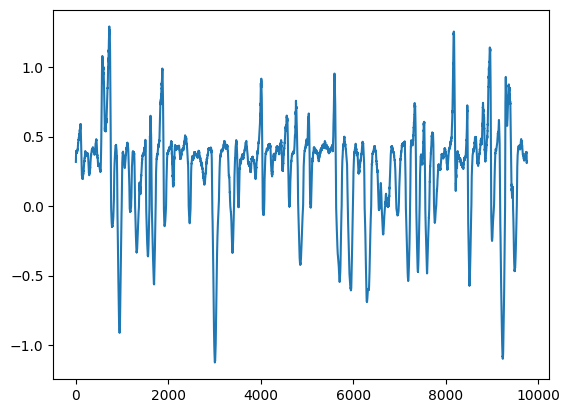

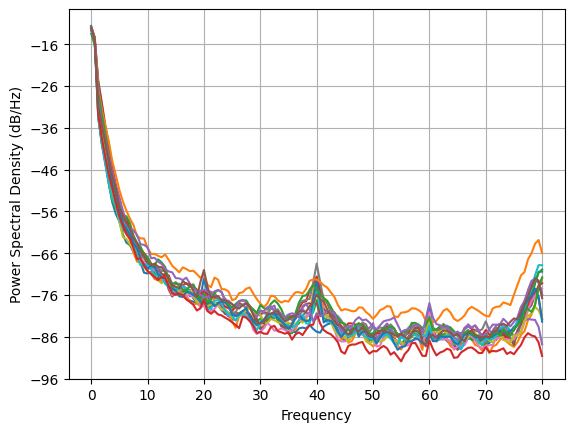

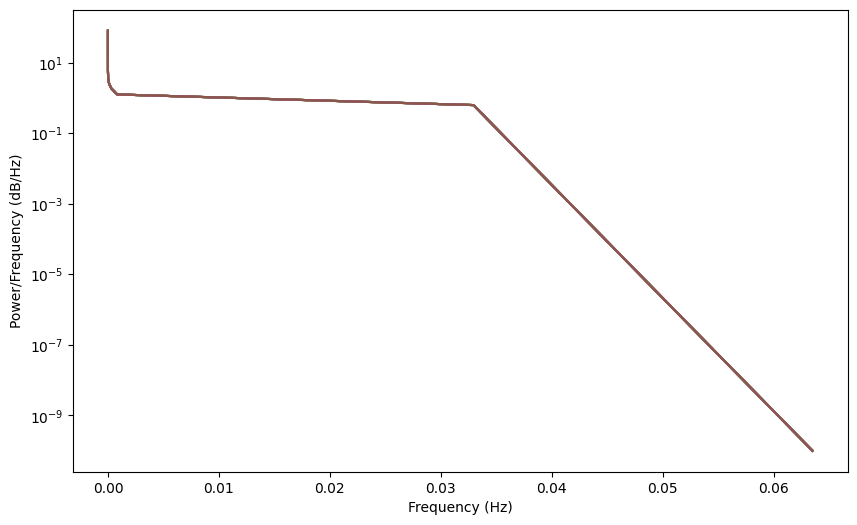

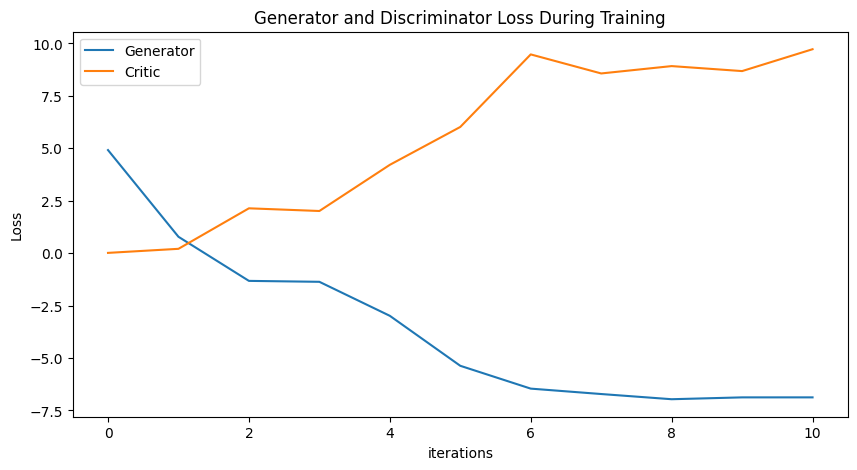

Epoch 20: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754]) Generator err ([0.01386235561221838, 0.20738686621189117, 2.1392900943756104, 2.0115456581115723, 4.213294982910156, 6.019637107849121, 9.479433059692383, 8.571412086486816, 8.922050476074219, 8.684074401855469, 9.726862907409668, 8.623533248901367, 8.881363868713379, 9.727750778198242, 9.628438949584961, 9.691246032714844, 9.830907821655273, 14.723241806030273, 15.583925247192383, 16.048297882080078, 17.233415603637695])


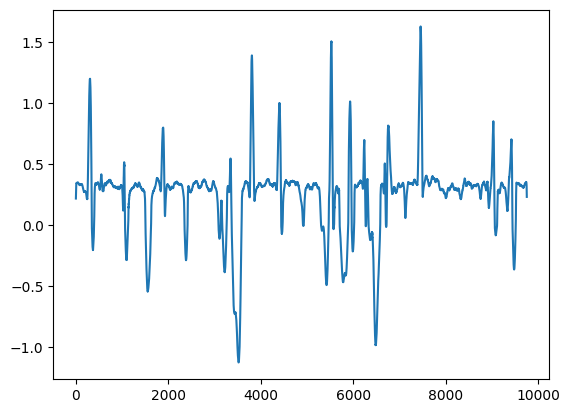

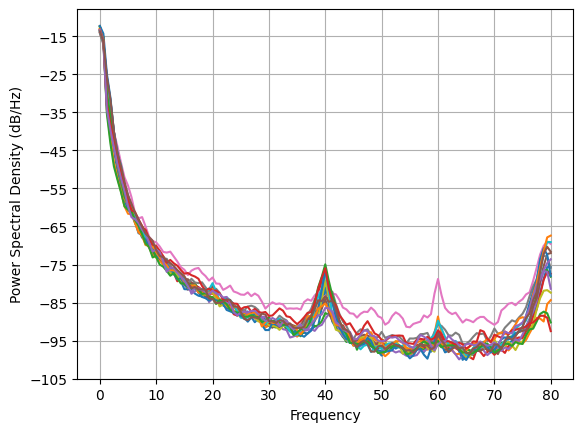

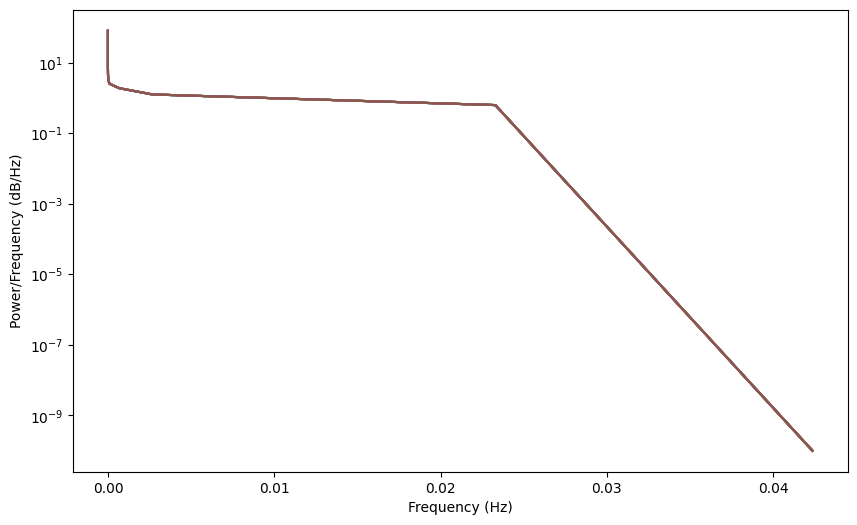

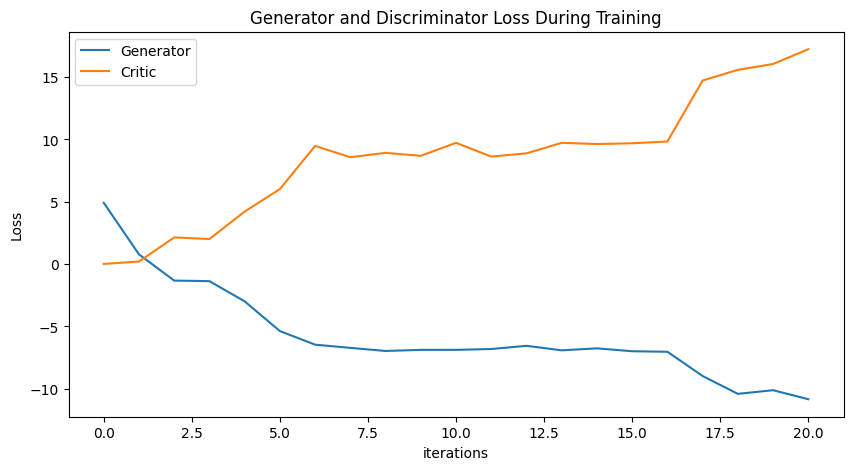

Epoch 30: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236]) Generator err ([0.01386235561221838, 0.20738686621189117, 2.1392900943756104, 2.0115456581115723, 4.213294982910156, 6.019637107849121, 9.479433059692383, 8.571412086486816, 8.922050476074219, 8.684074401855469, 9.726862907409668, 8.623533248901367, 8.881363868713379, 9.727750778198242, 9.628438949584961, 9.691246032714844, 9.830907821655273, 14.72

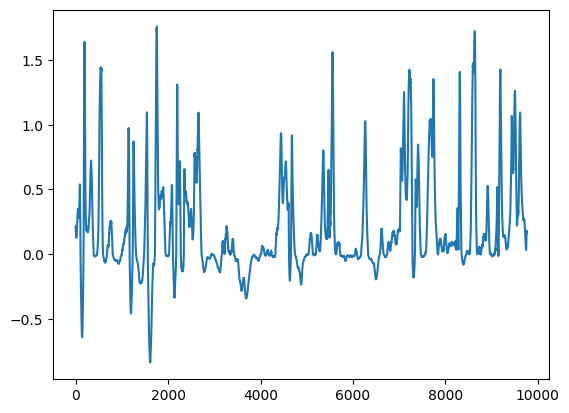

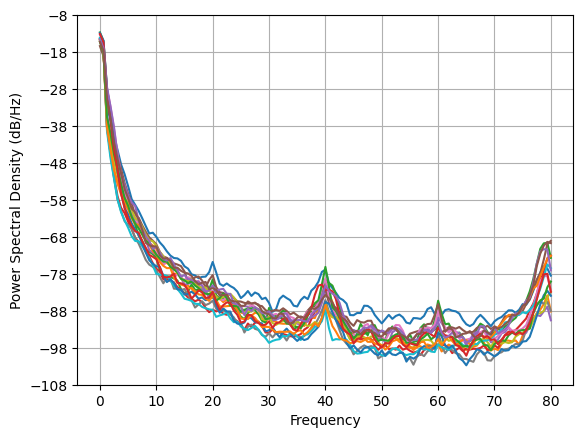

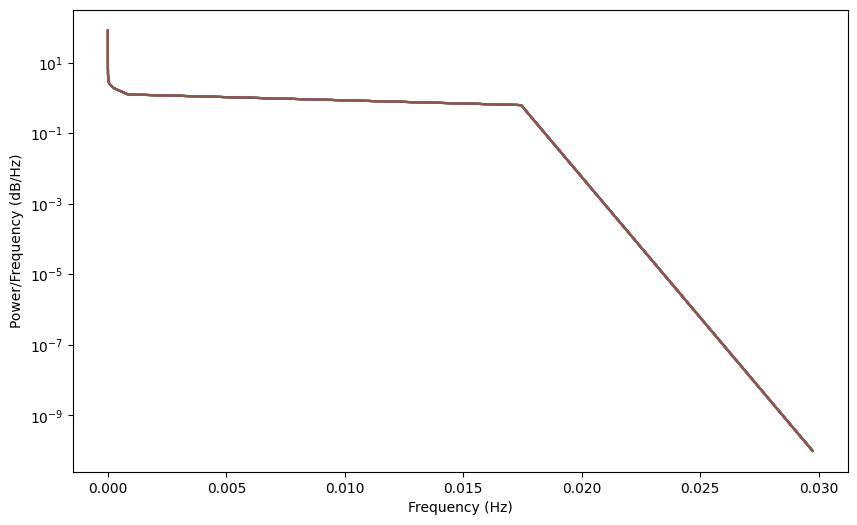

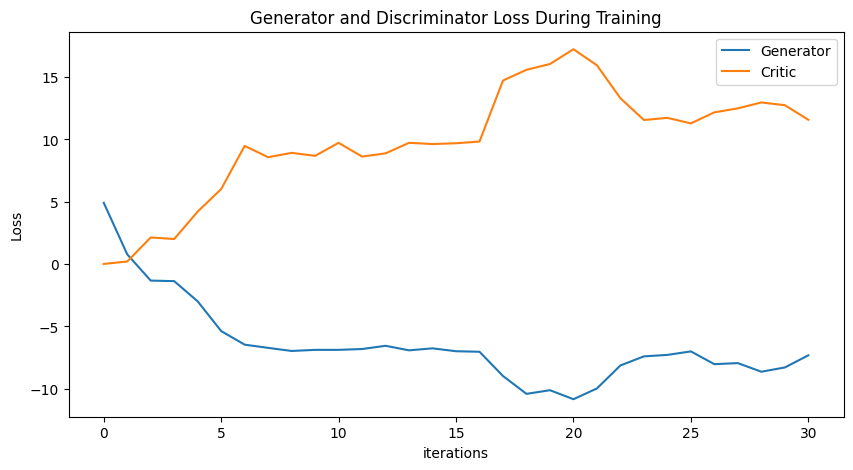

Epoch 40: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162]) Generator err ([0.01386235561221838, 0.20738686621189117, 2.1392900943756104, 2.0115456581115723, 4.213294982910156, 6.019637107849121, 9.4794330596923

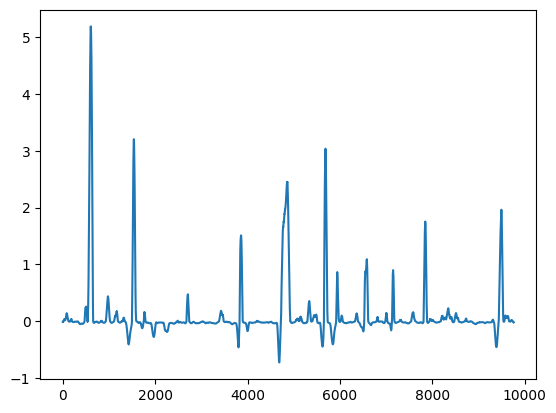

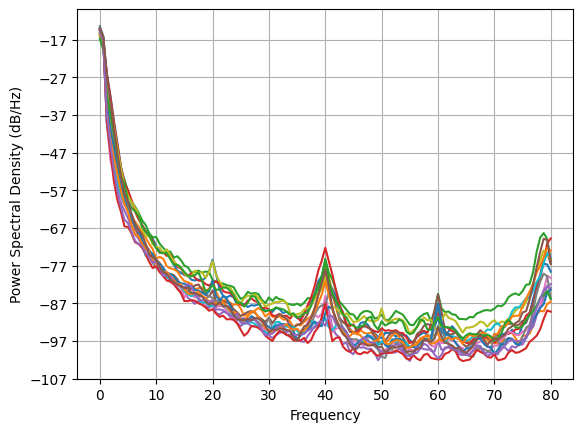

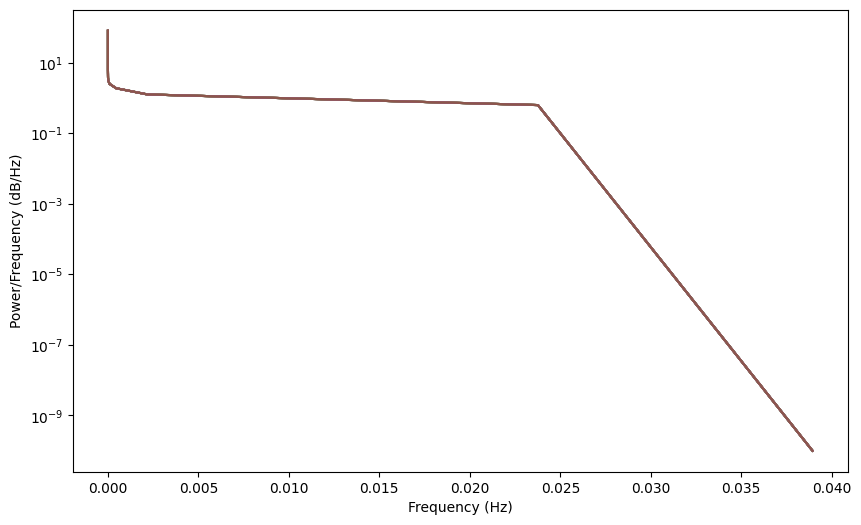

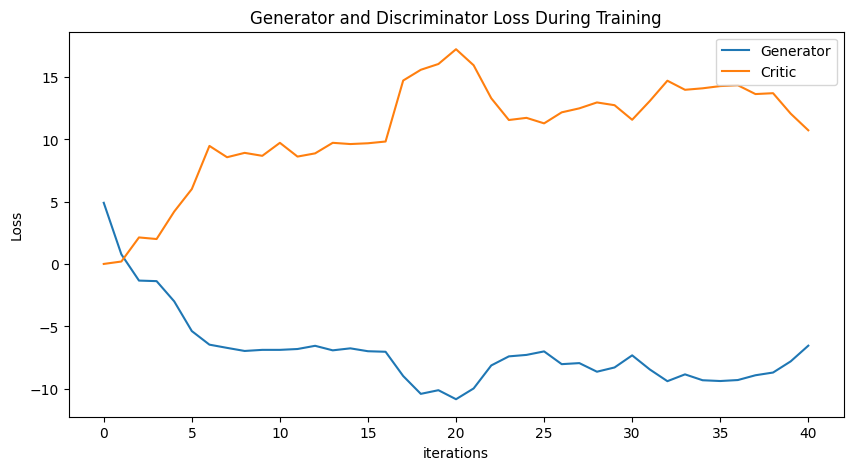

Epoch 50: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.182058555

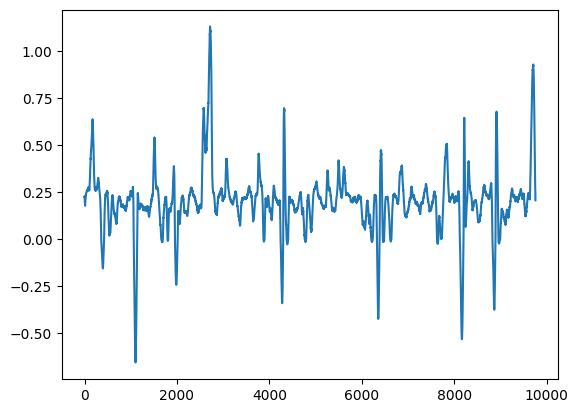

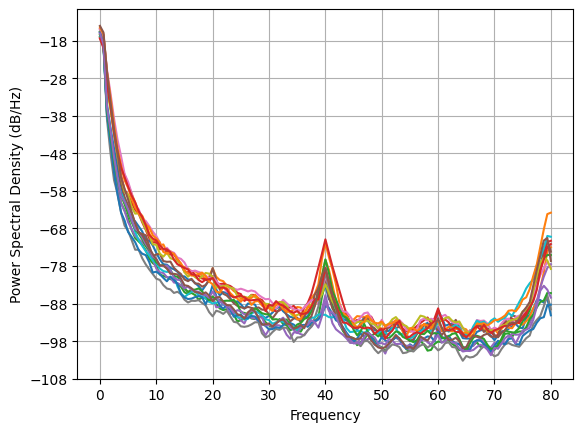

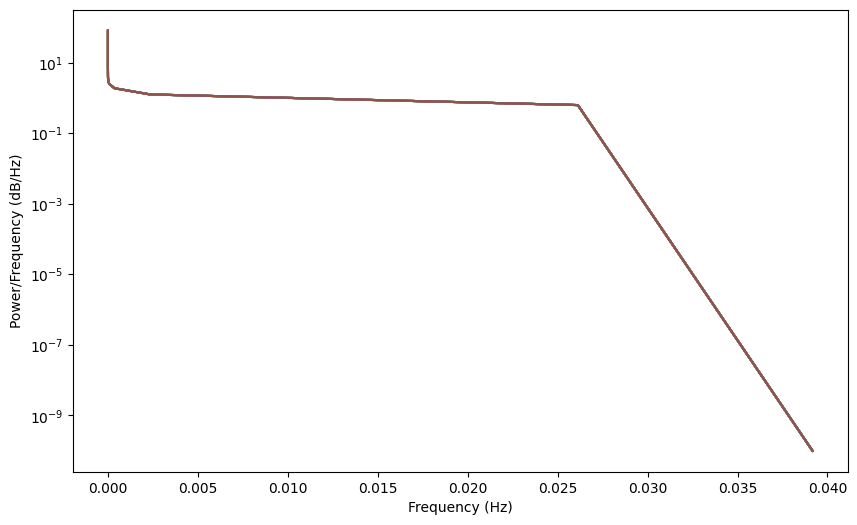

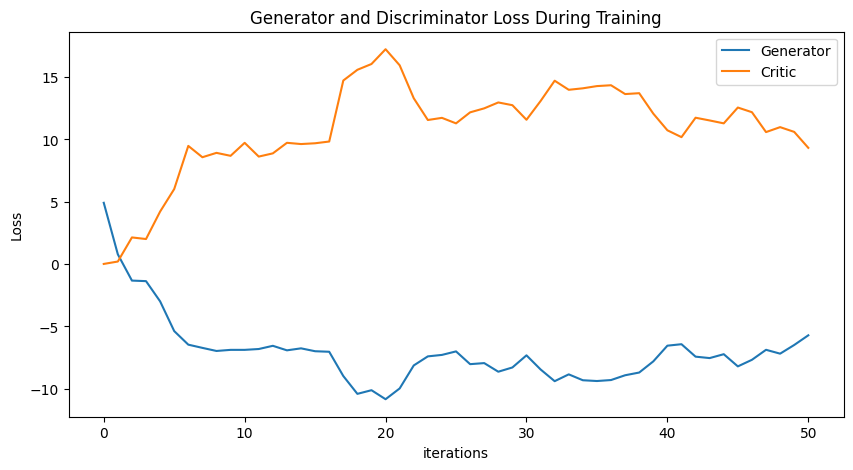

Epoch 60: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.182058555

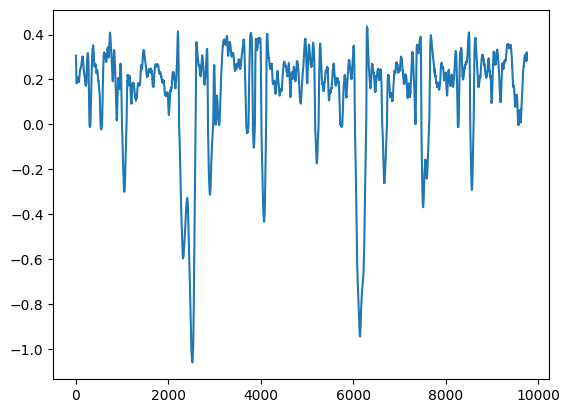

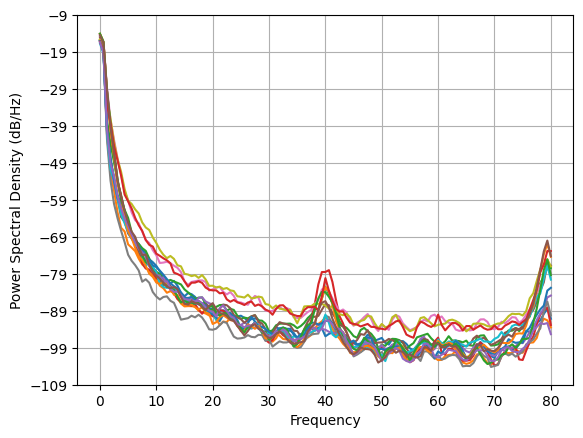

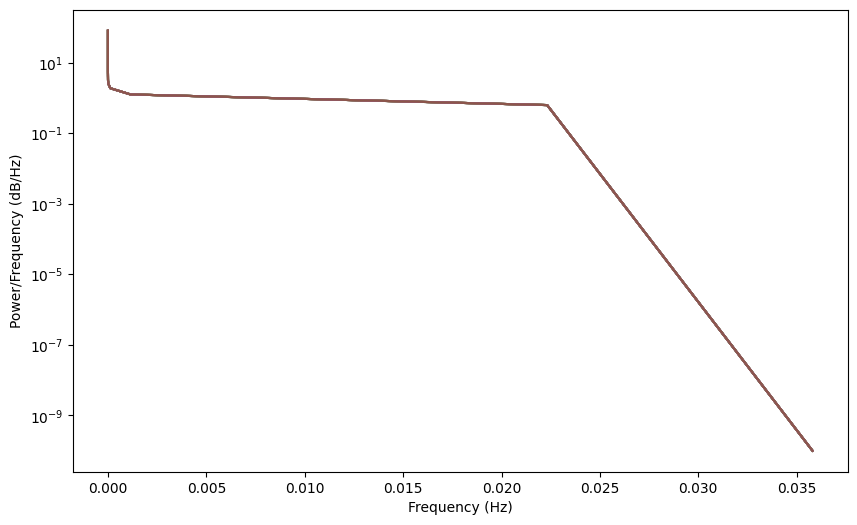

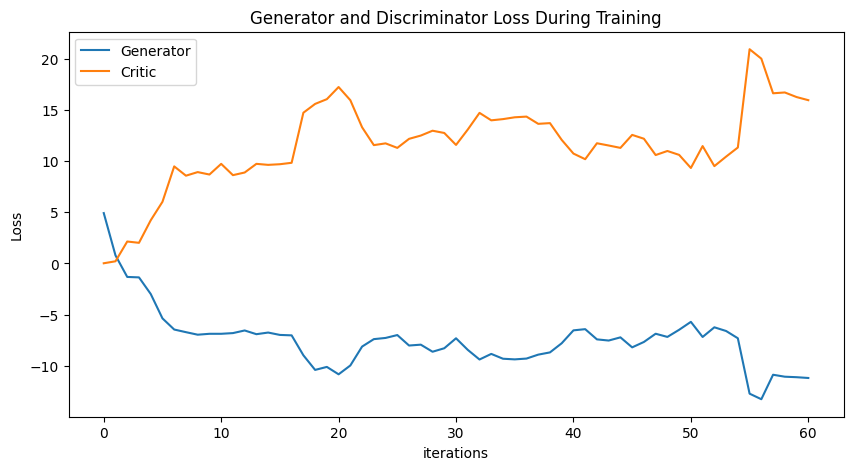

Epoch 70: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.182058555

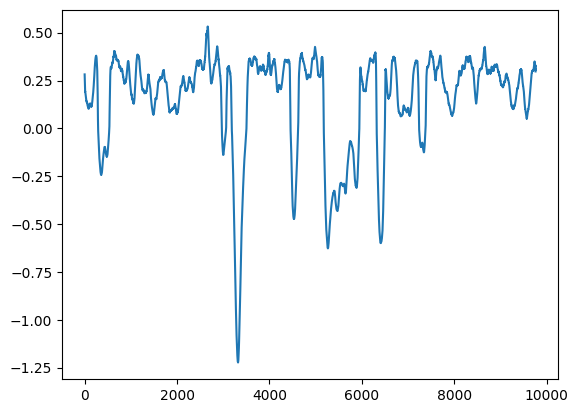

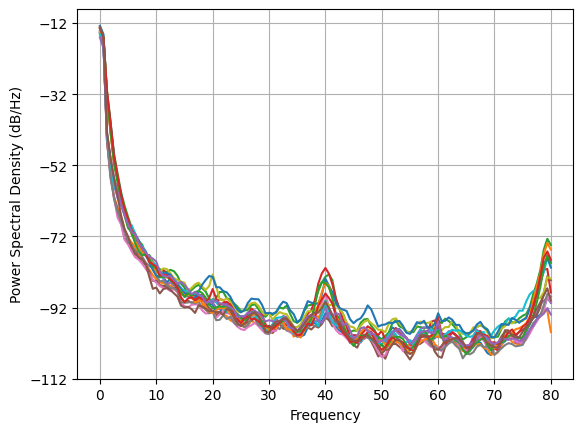

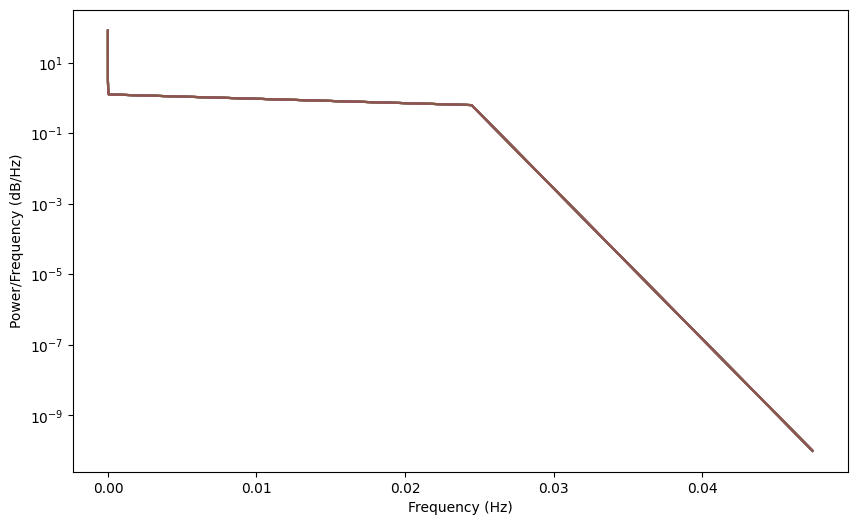

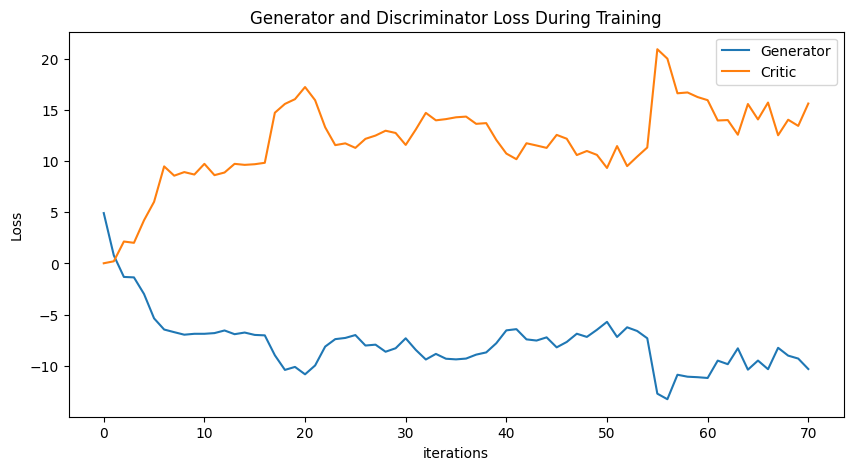

Epoch 80: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.182058555

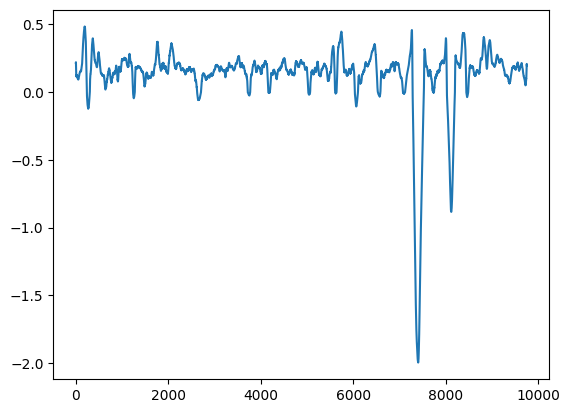

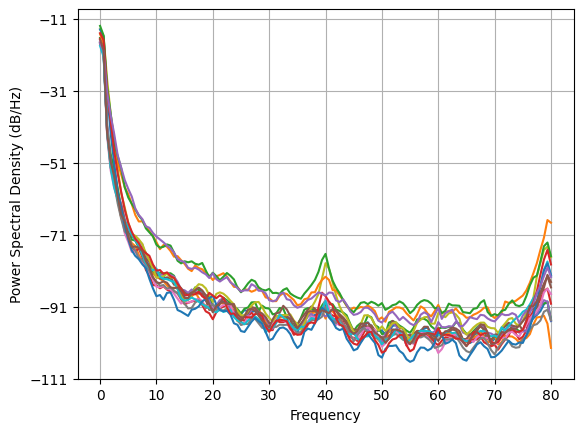

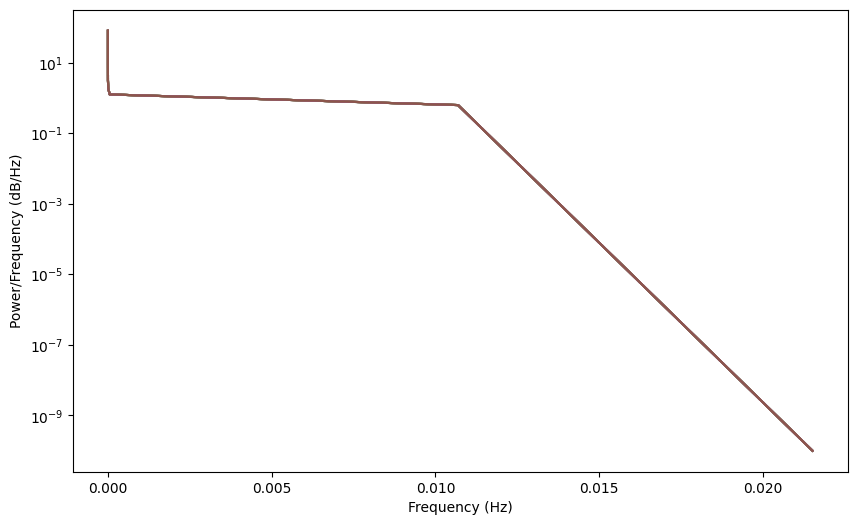

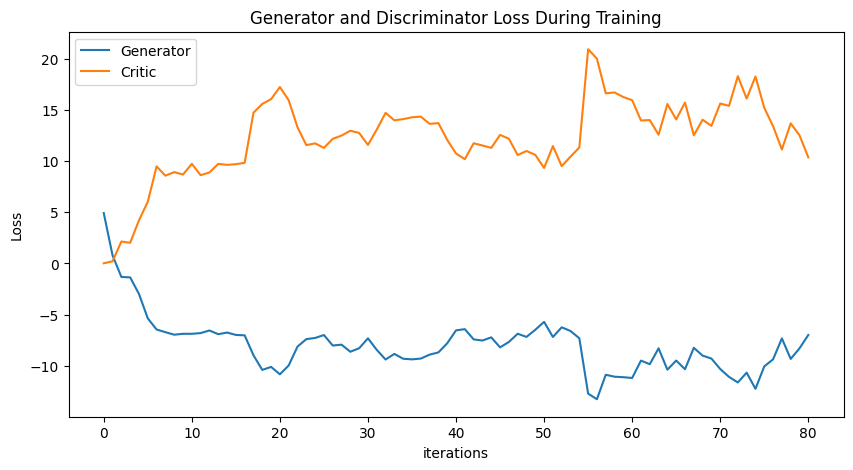

Epoch 90: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.182058555

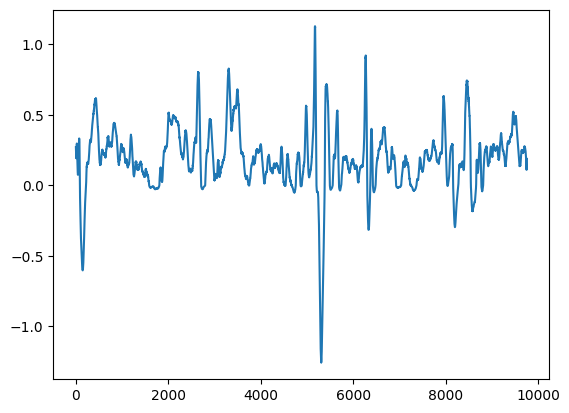

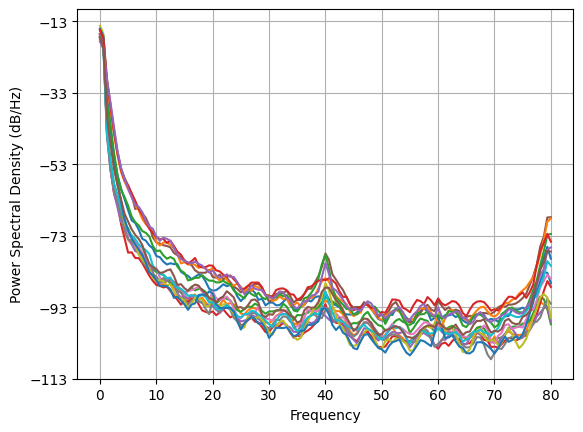

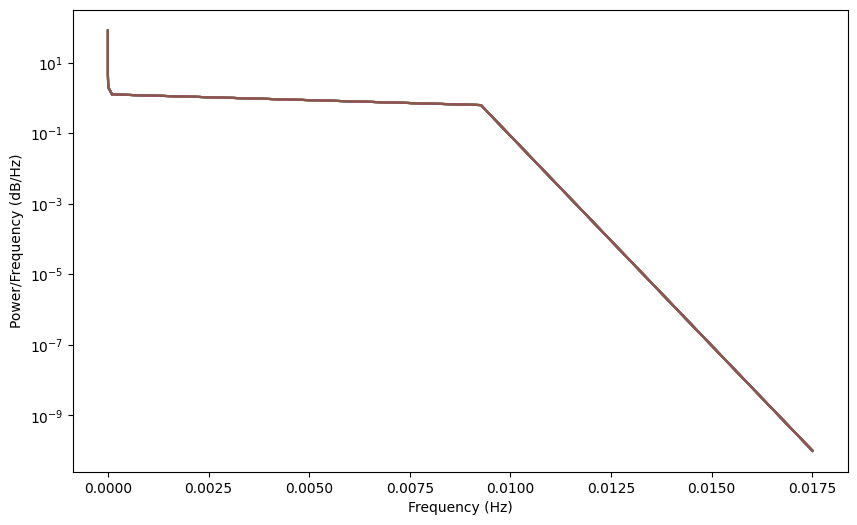

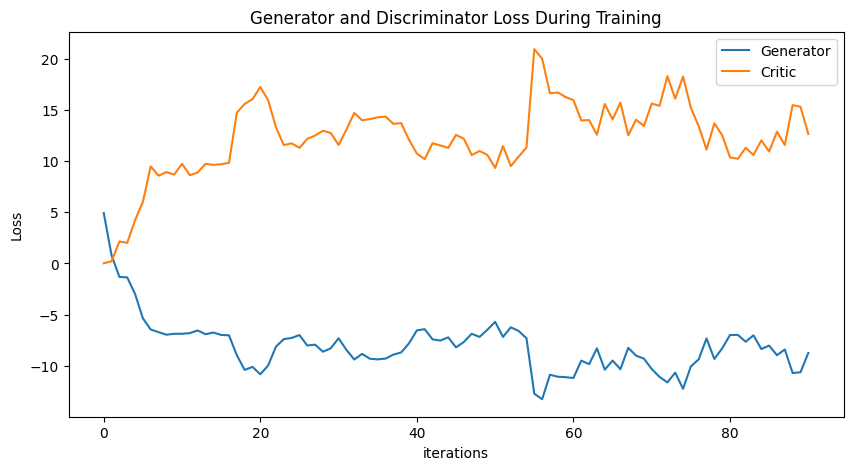

Epoch 100: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

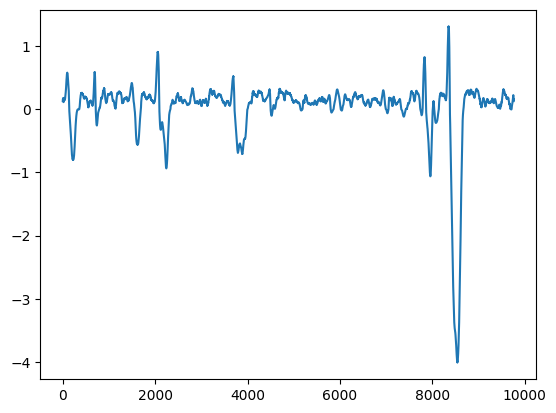

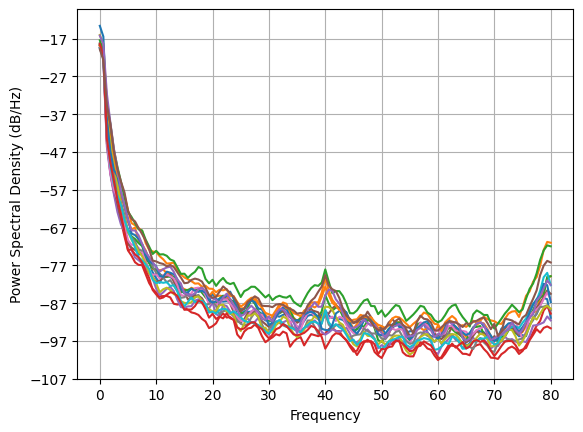

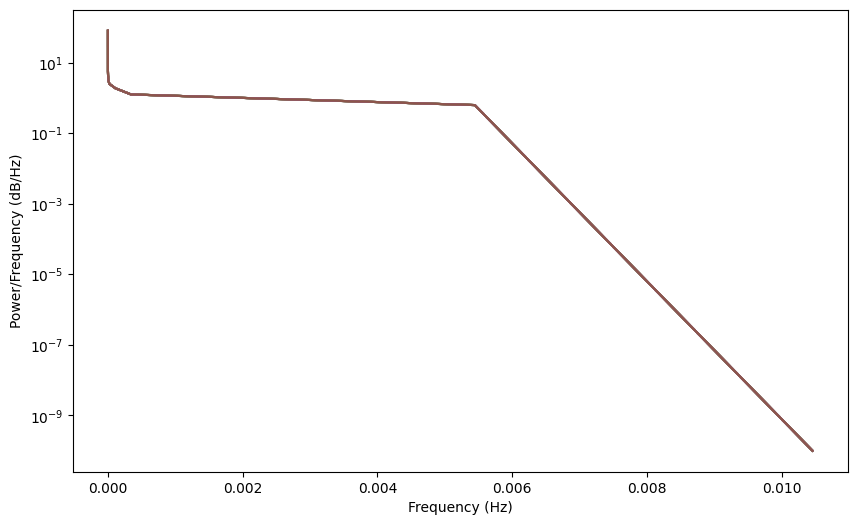

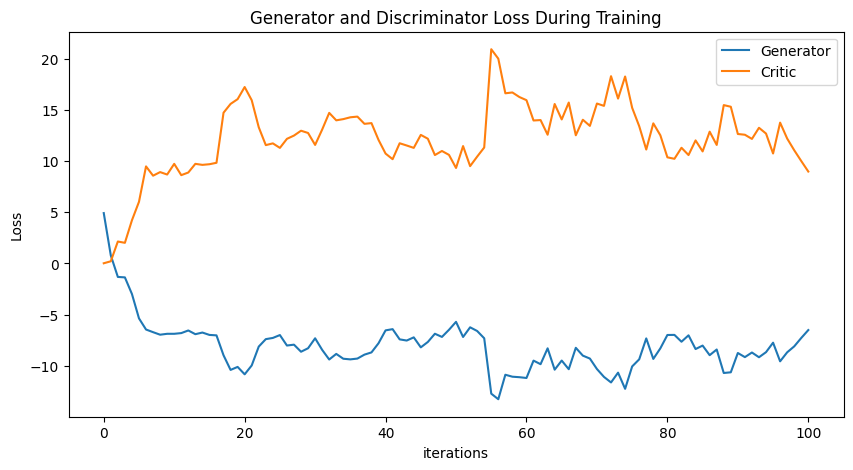

Epoch 110: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

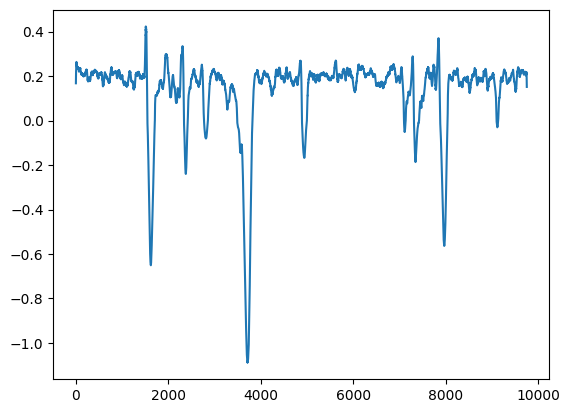

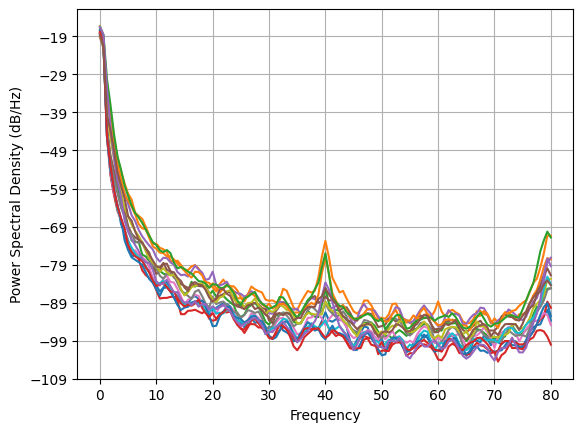

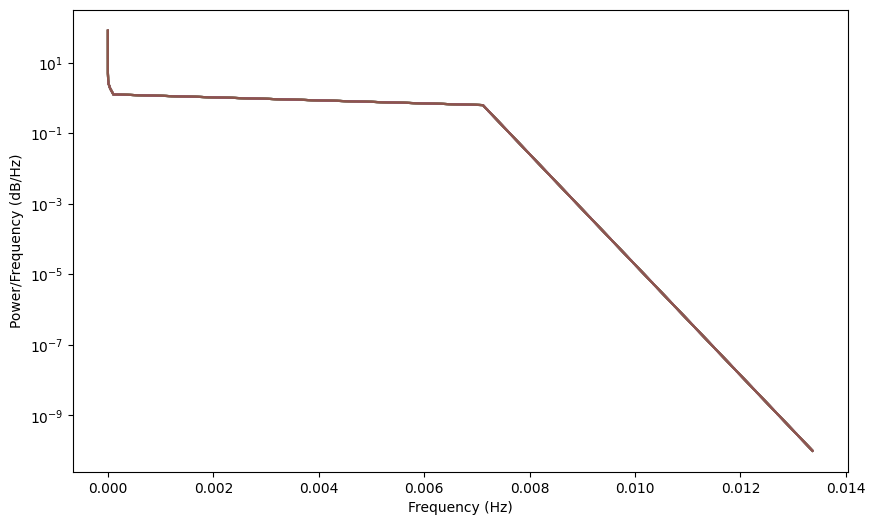

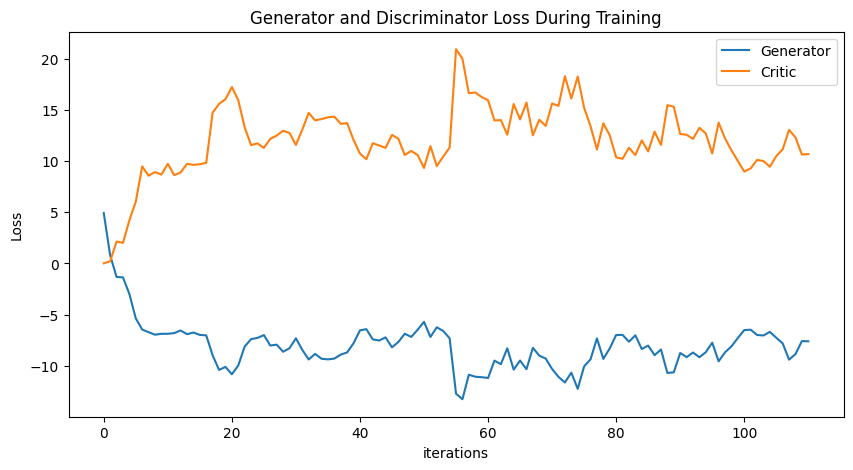

Epoch 120: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

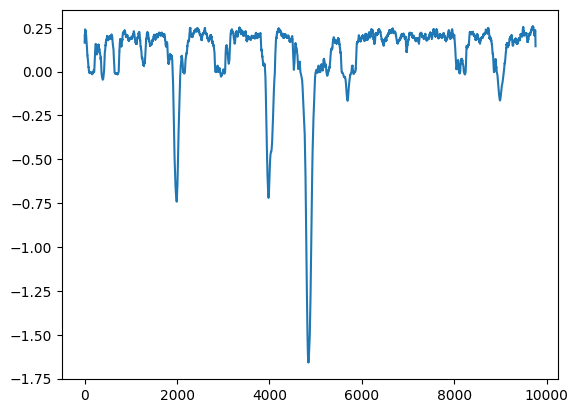

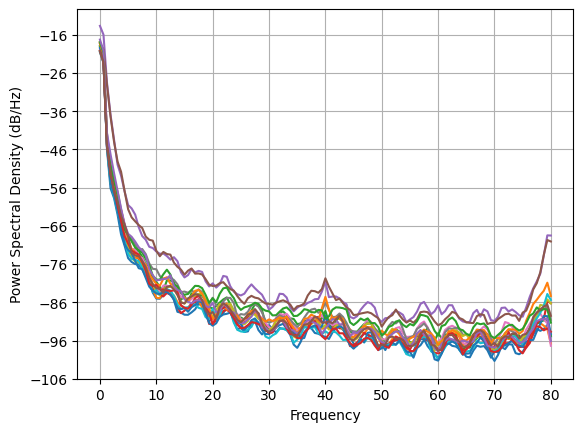

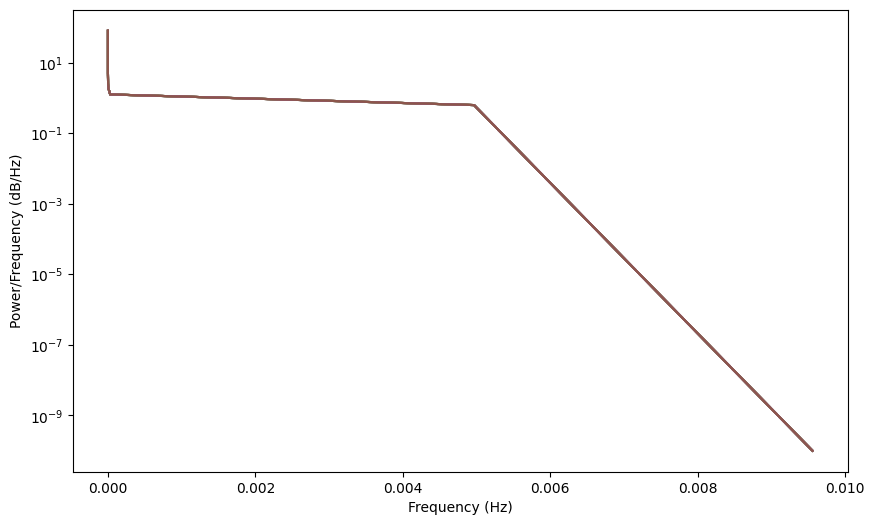

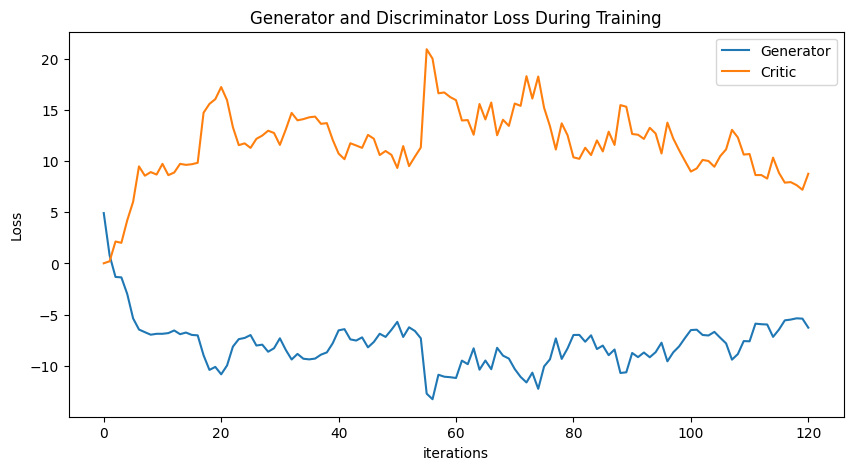

Epoch 130: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

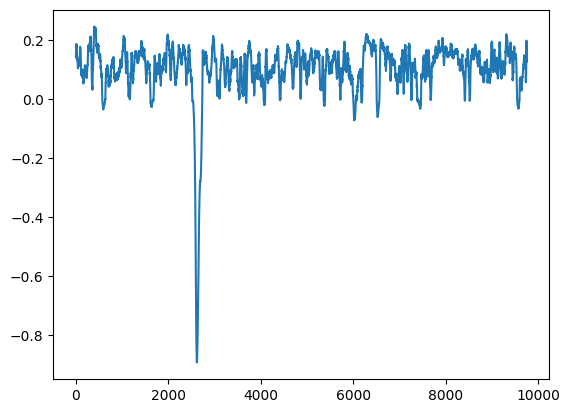

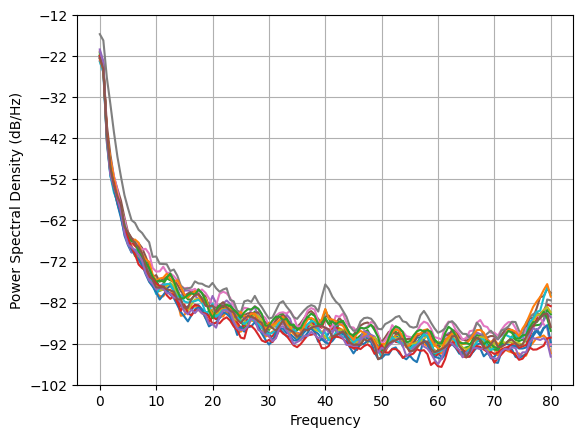

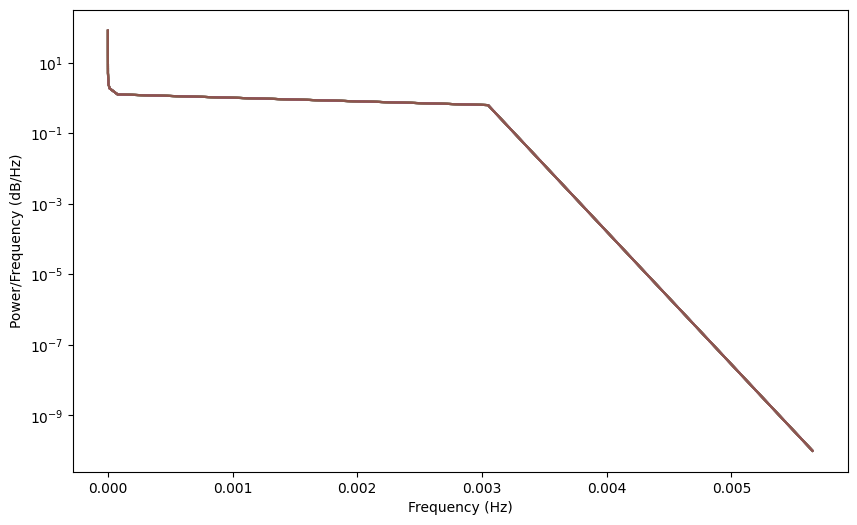

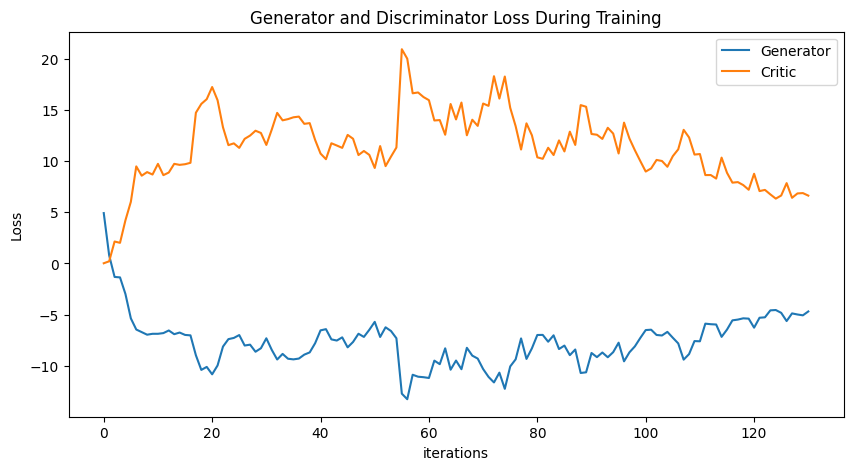

Epoch 140: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

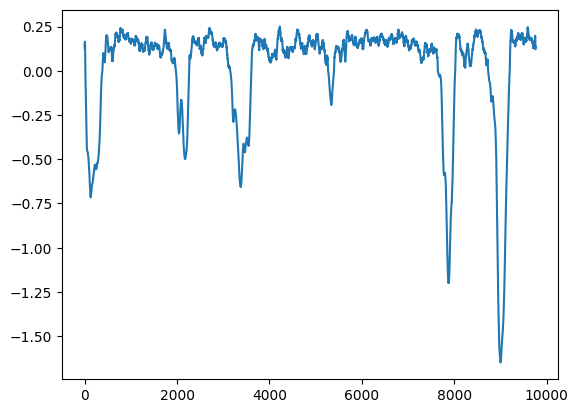

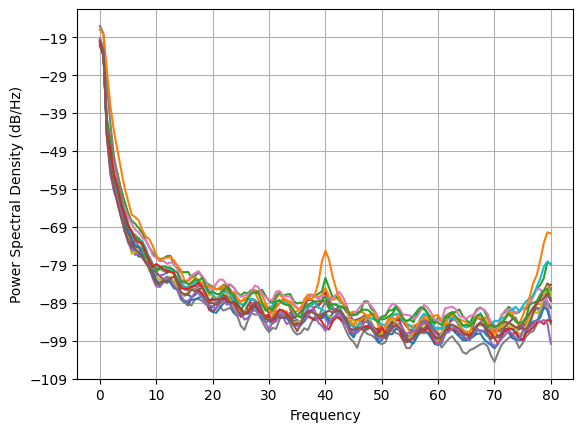

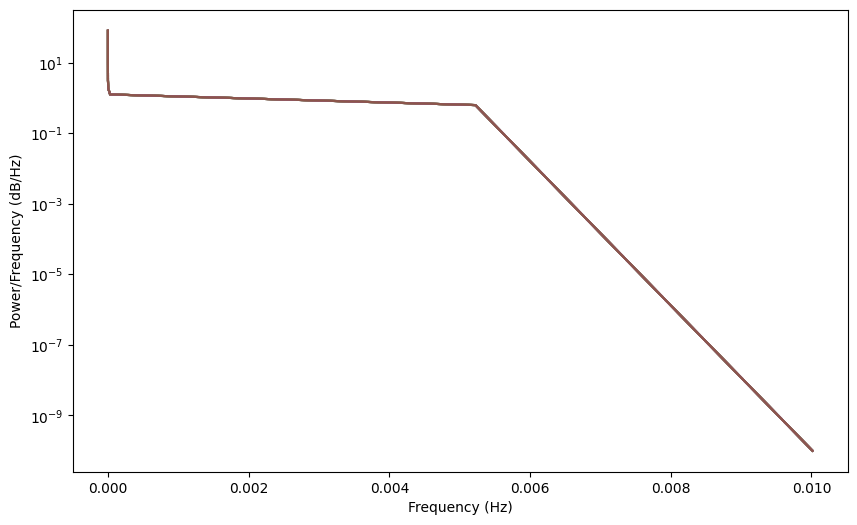

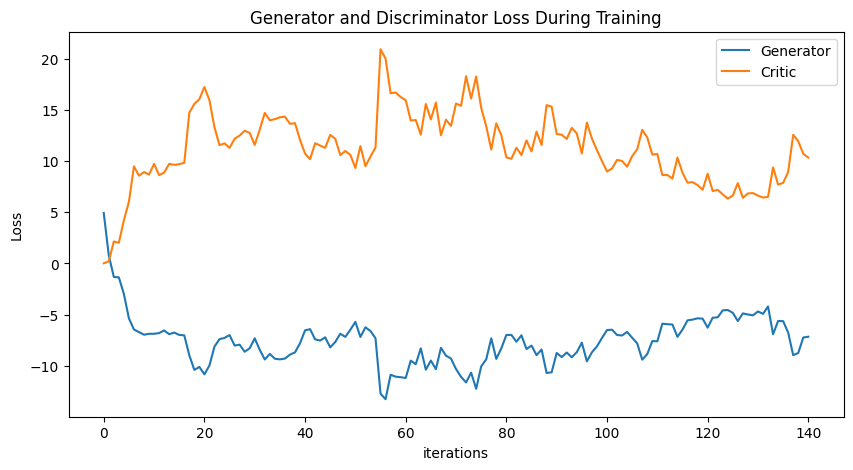

Epoch 150: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

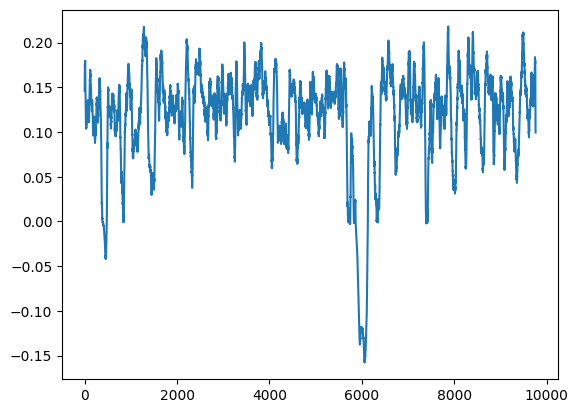

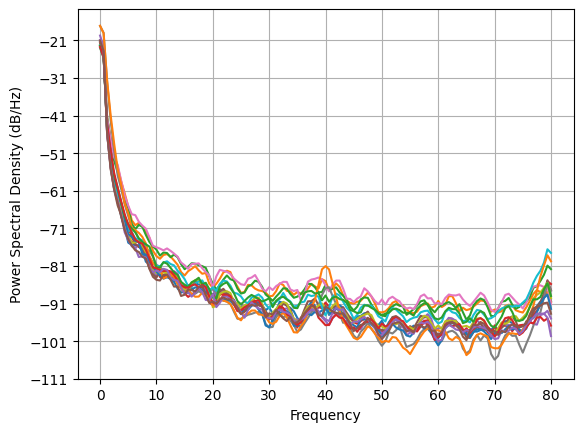

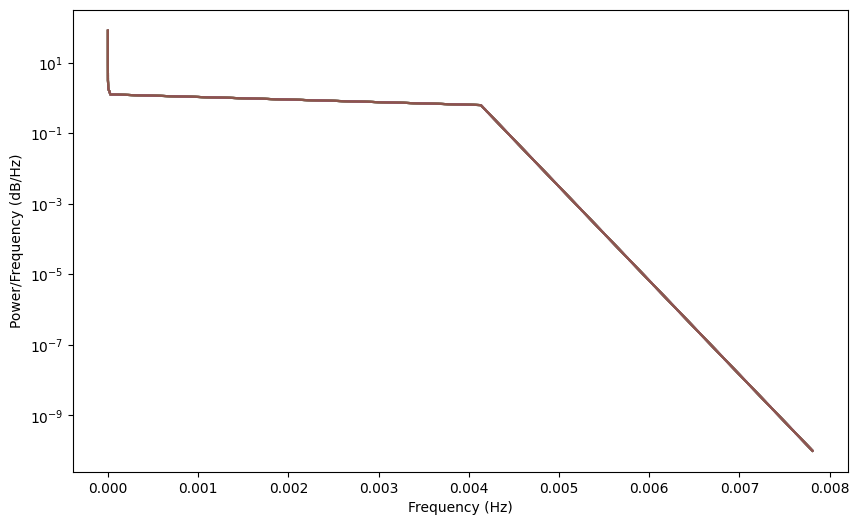

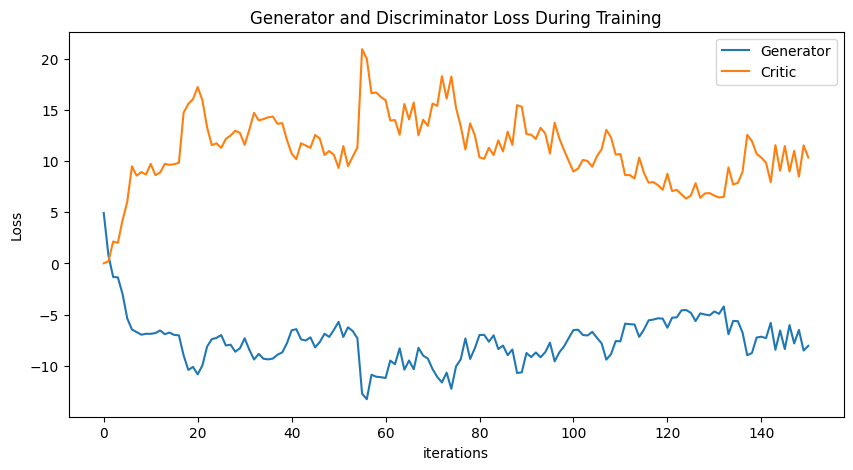

Epoch 160: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

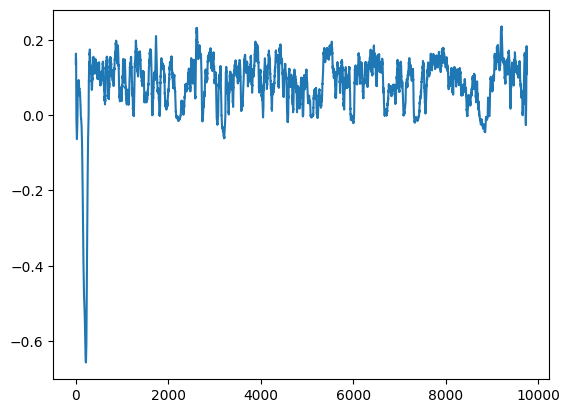

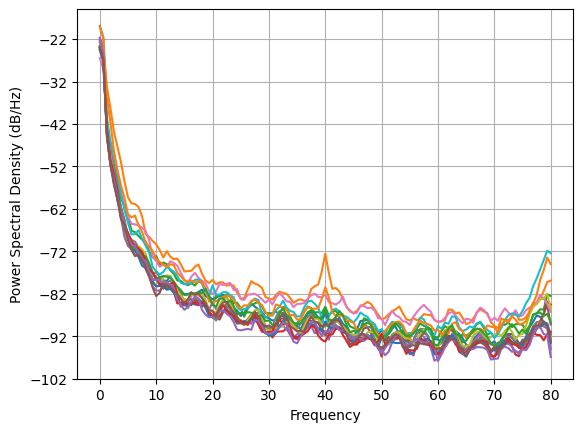

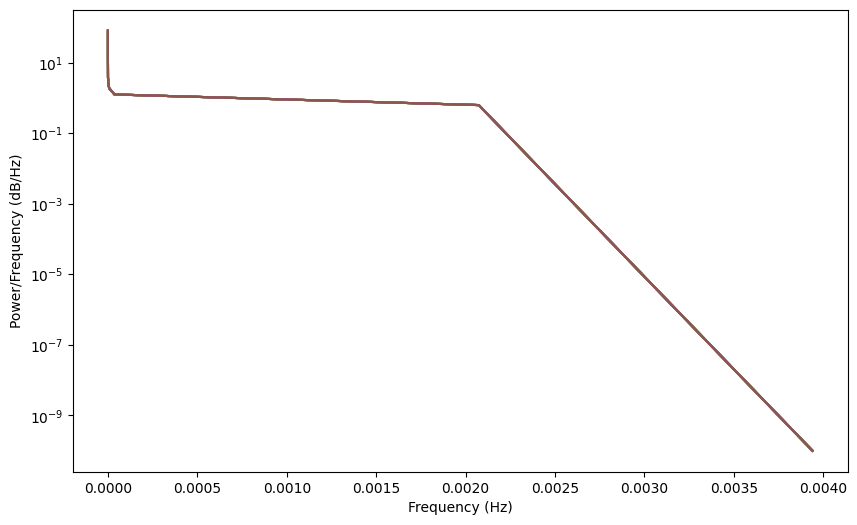

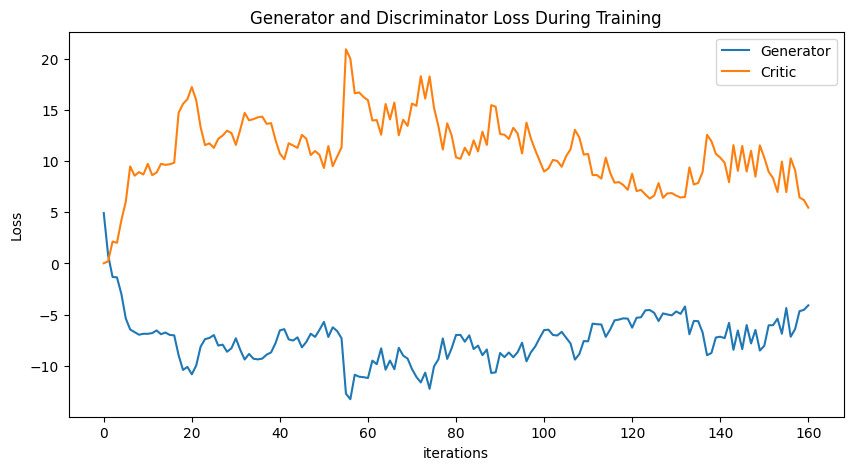

Epoch 170: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

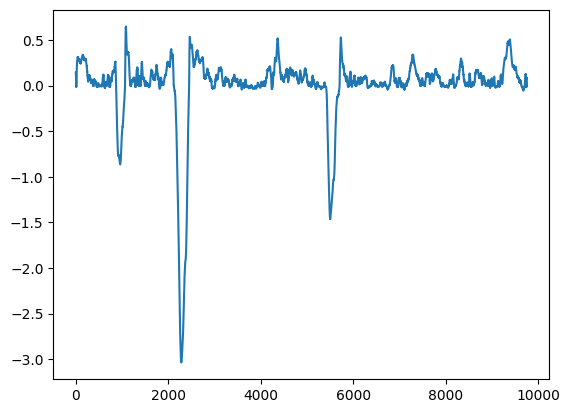

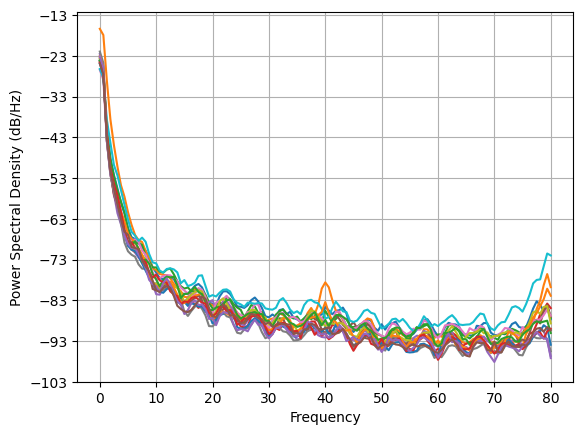

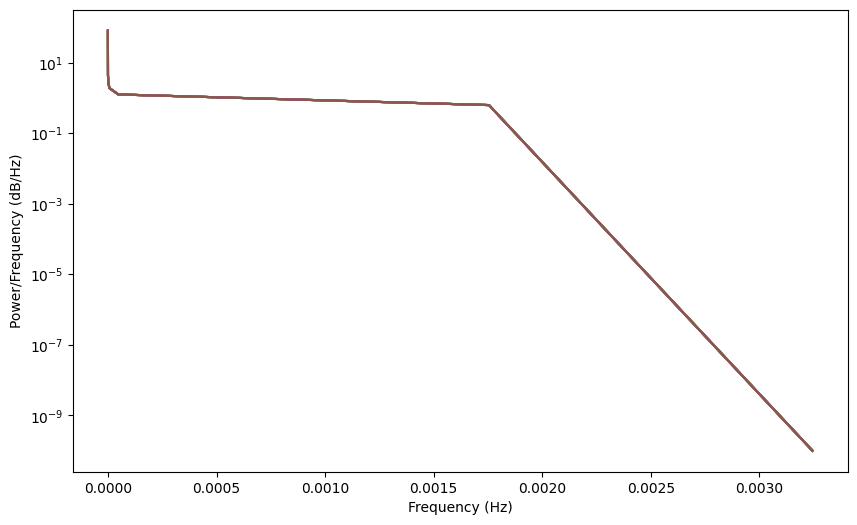

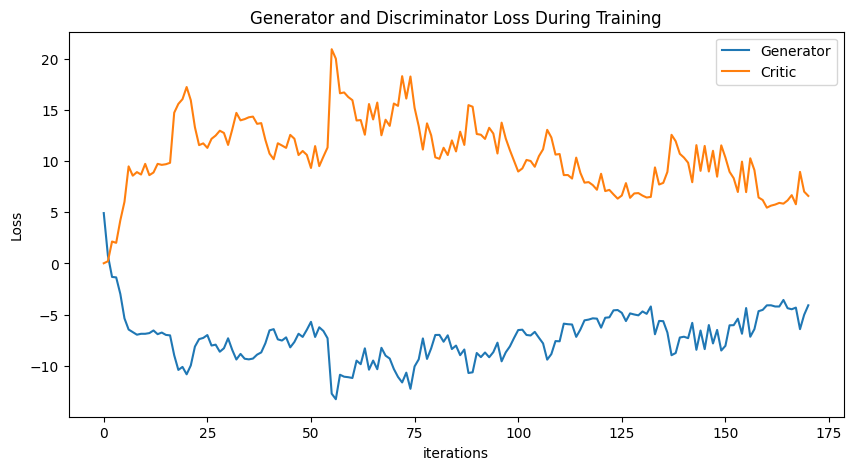

Epoch 180: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

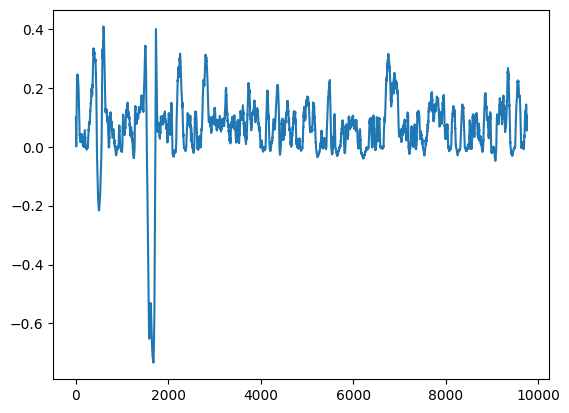

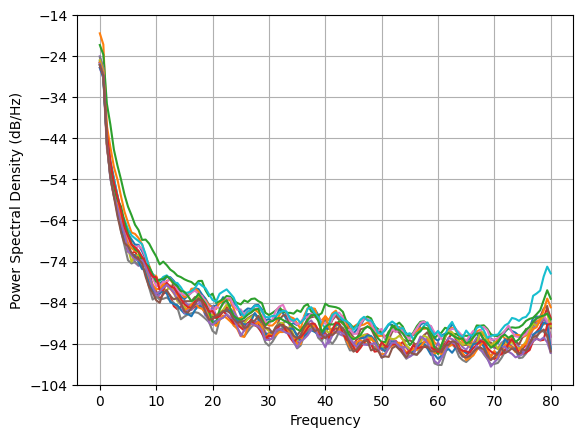

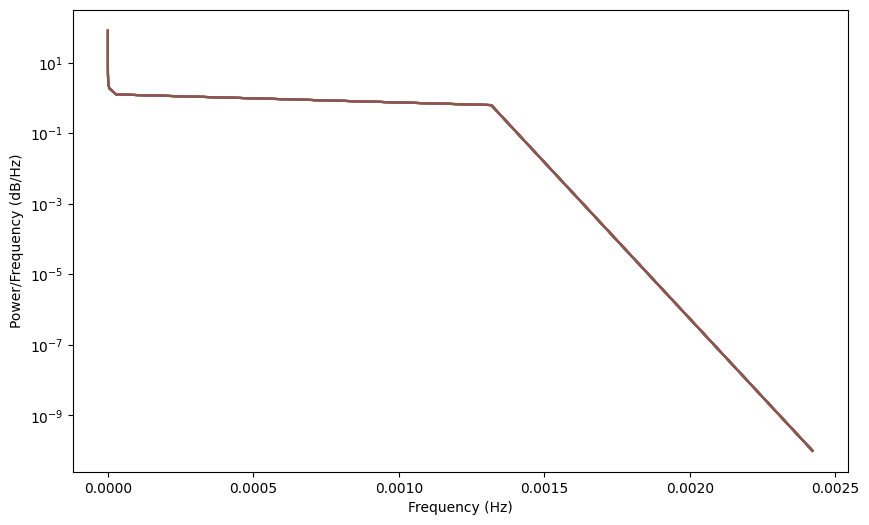

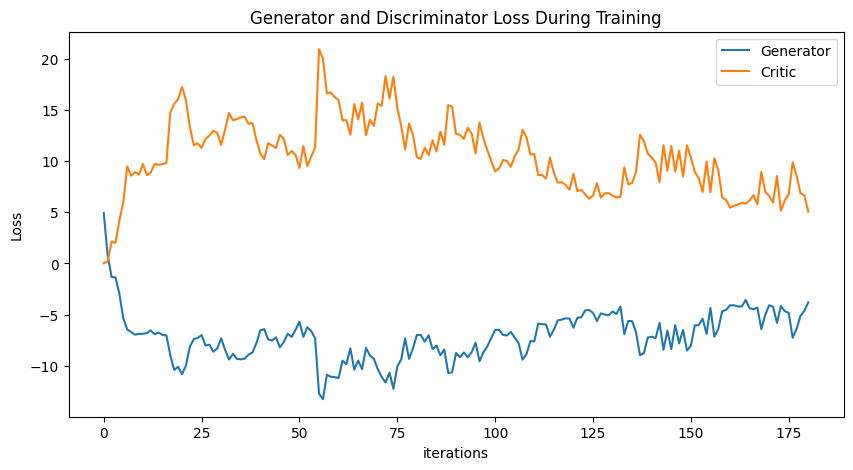

Epoch 190: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

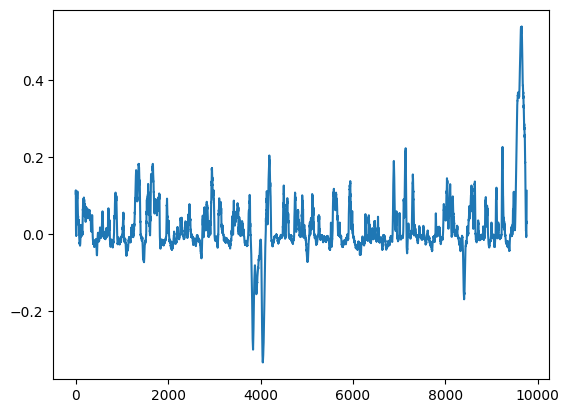

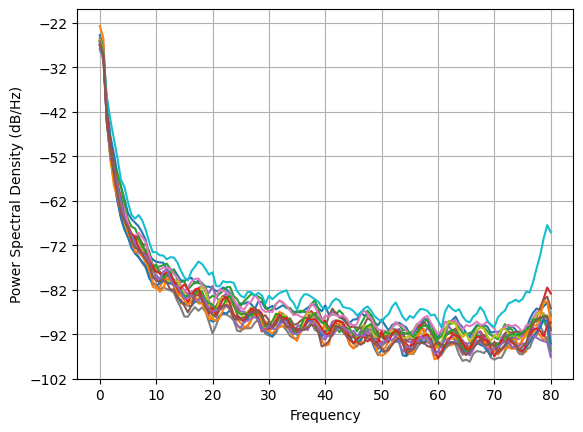

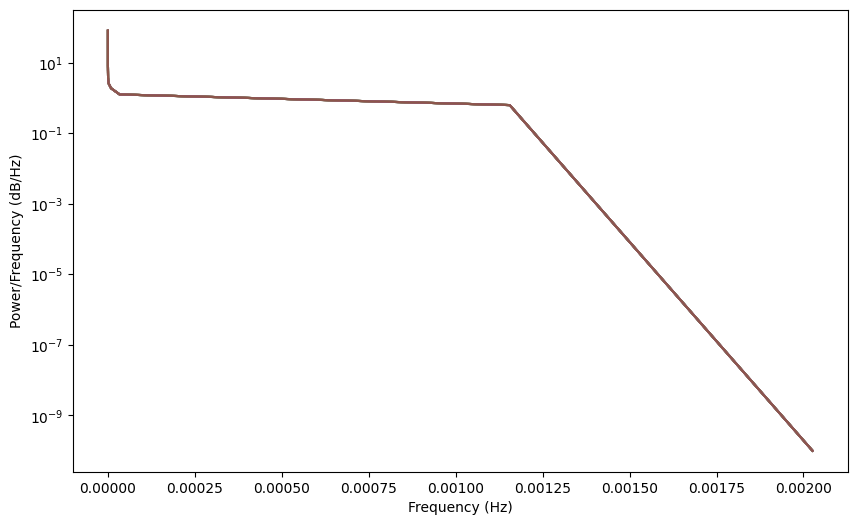

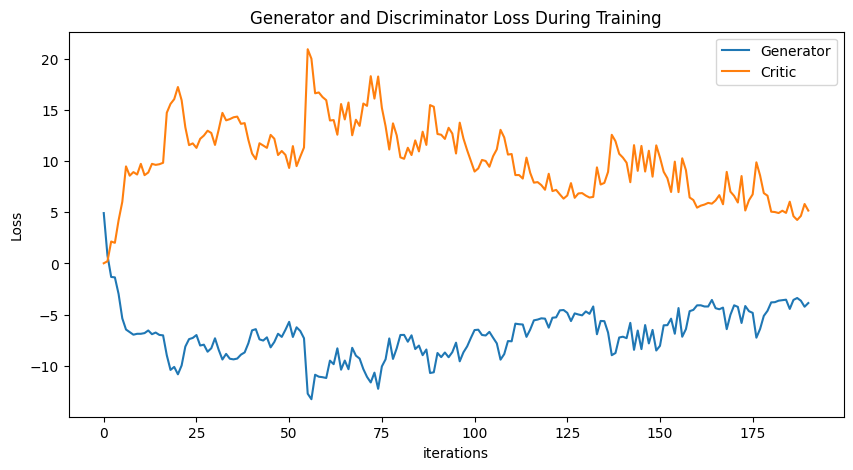

Epoch 200: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

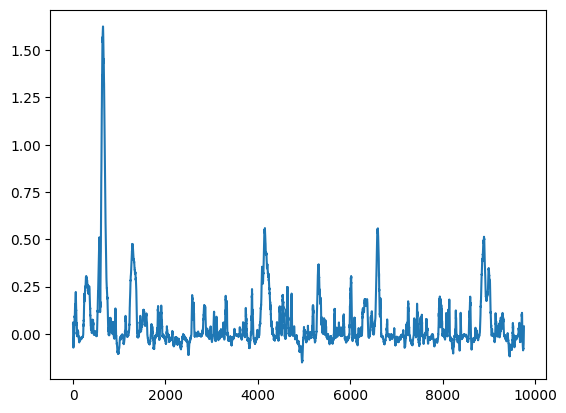

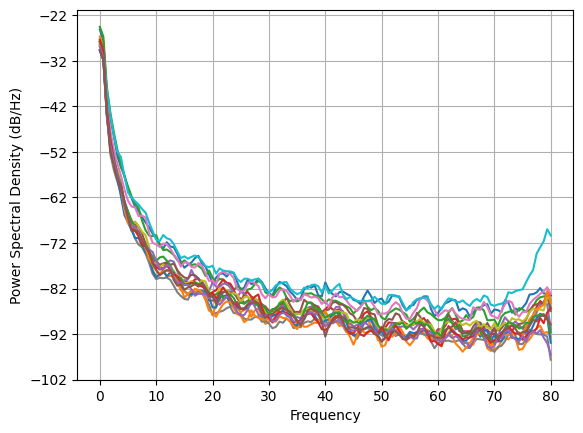

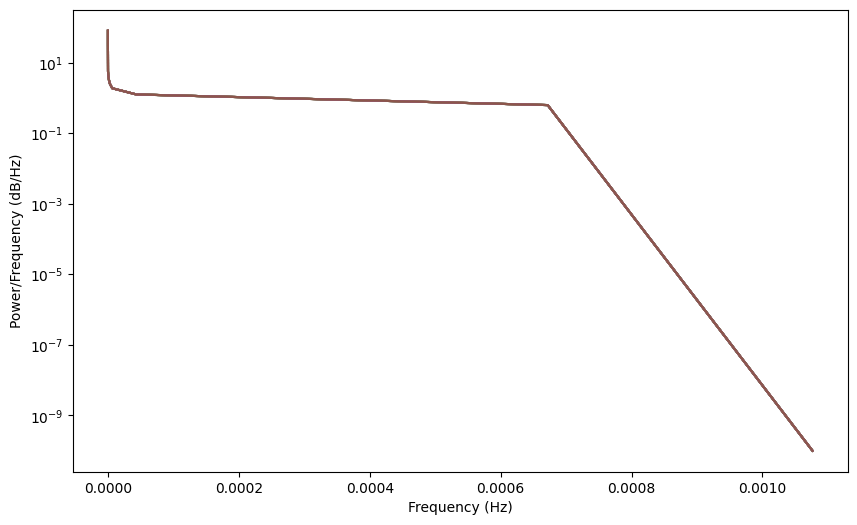

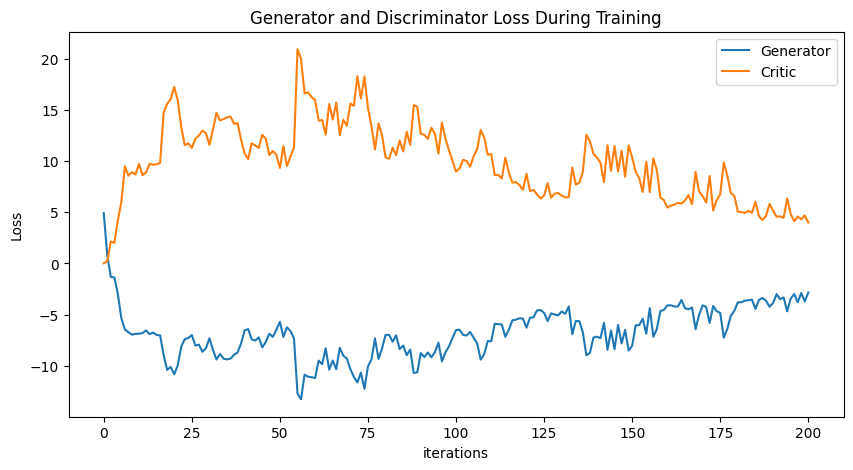

Epoch 210: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

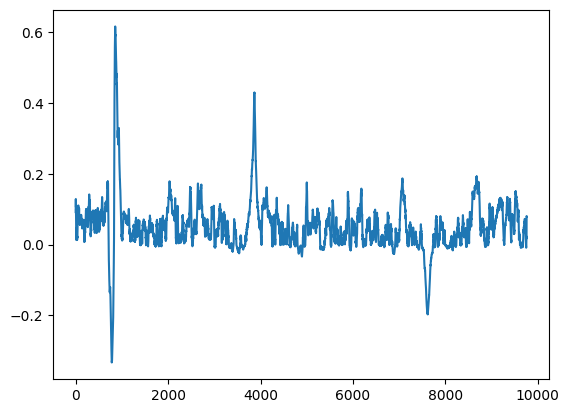

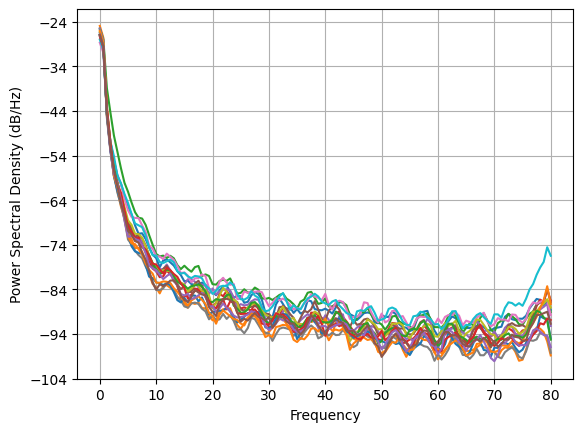

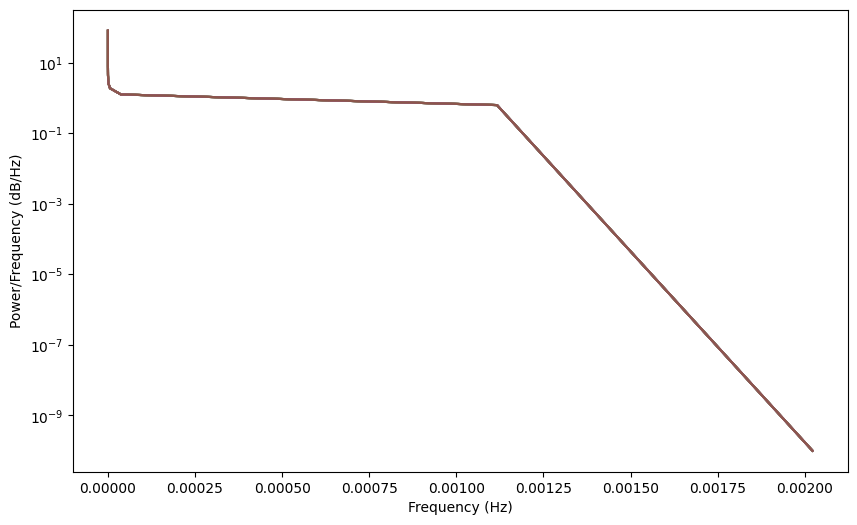

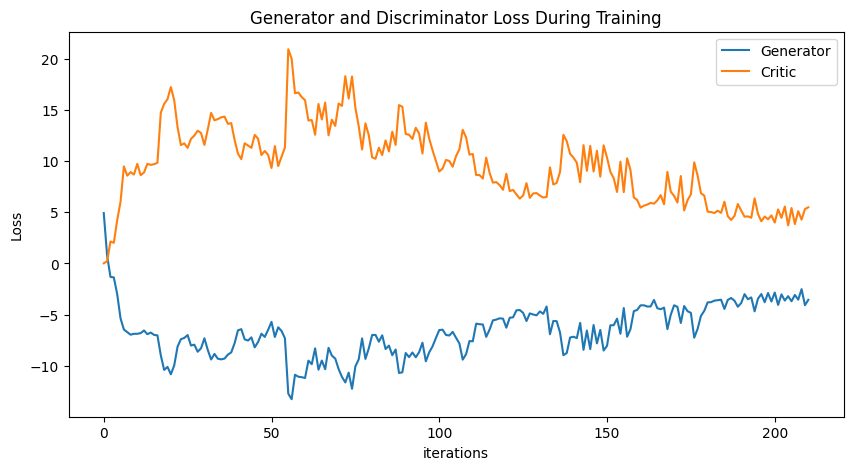

Epoch 220: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

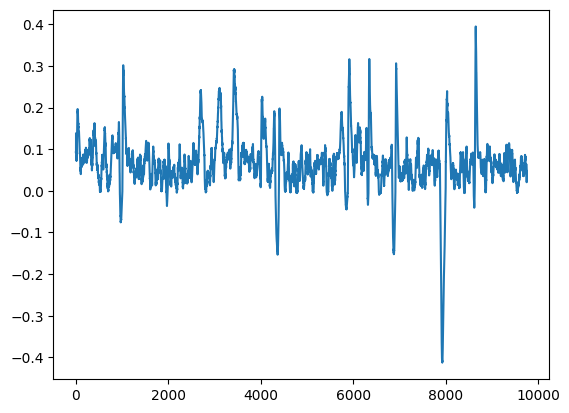

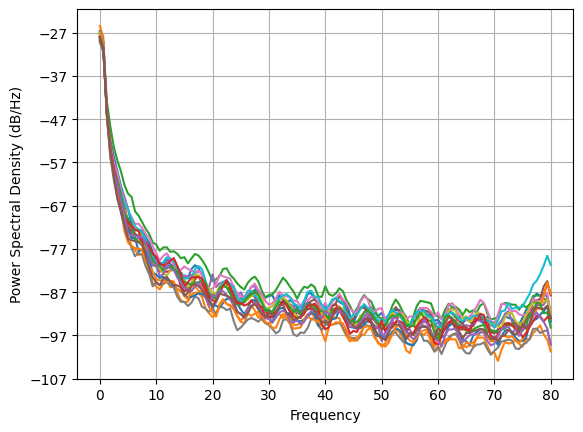

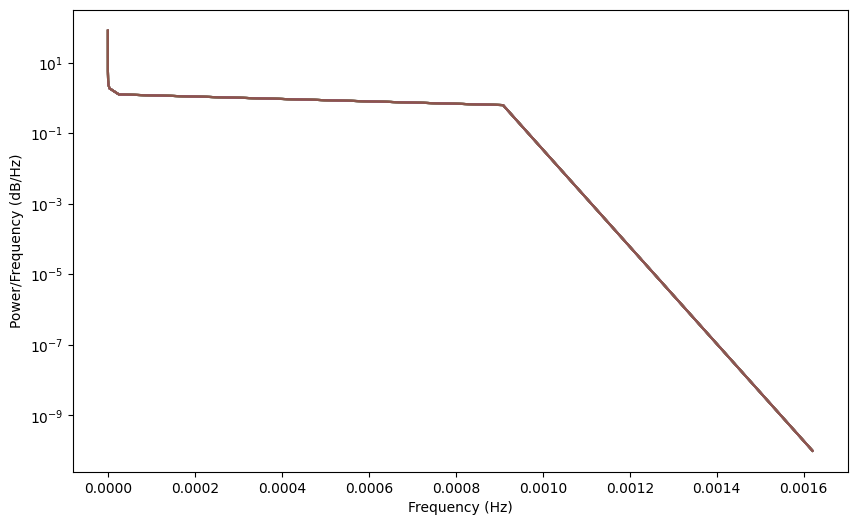

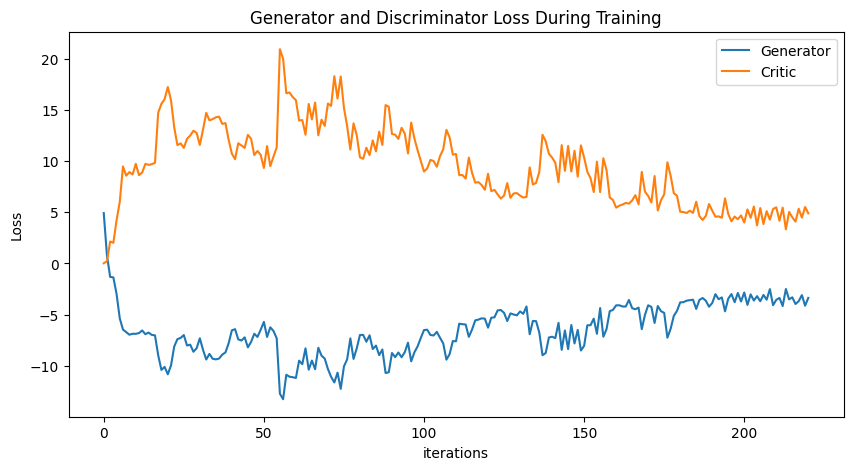

Epoch 230: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

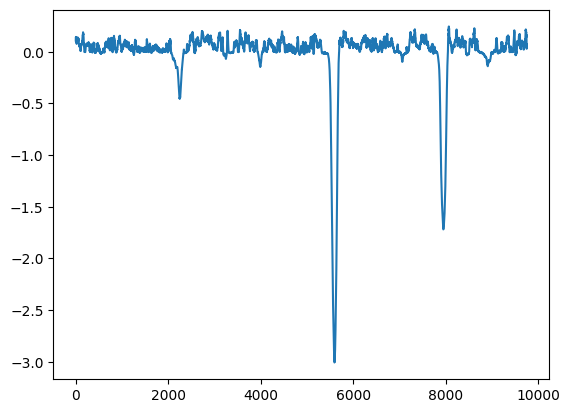

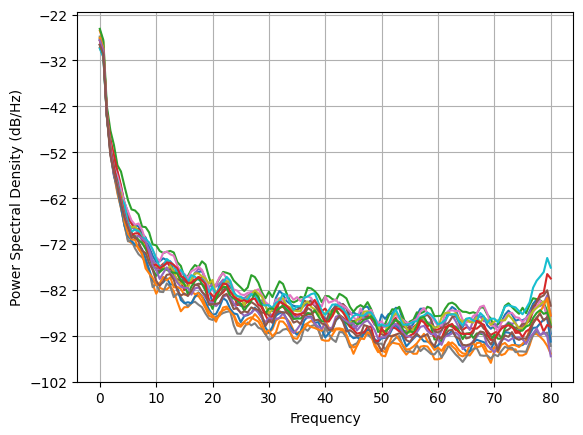

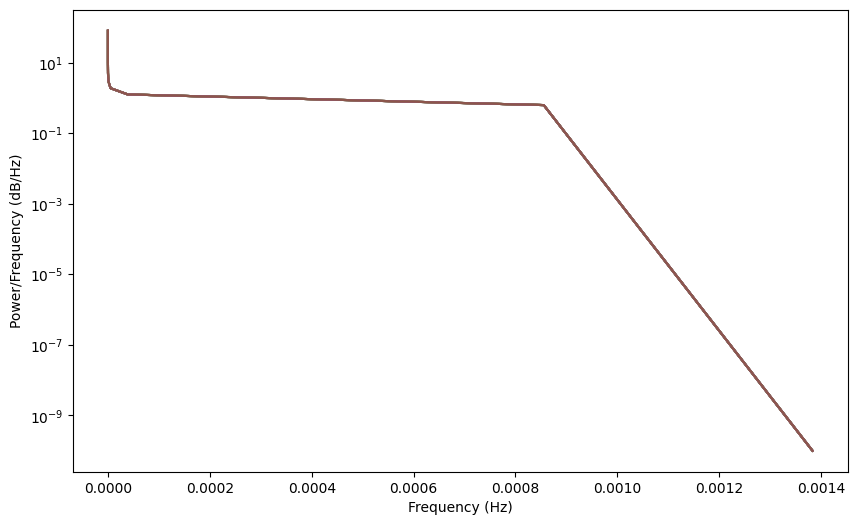

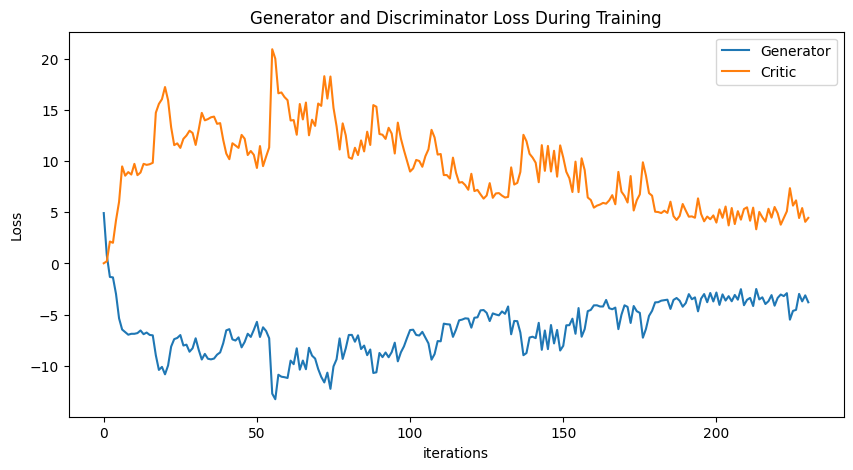

Epoch 240: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

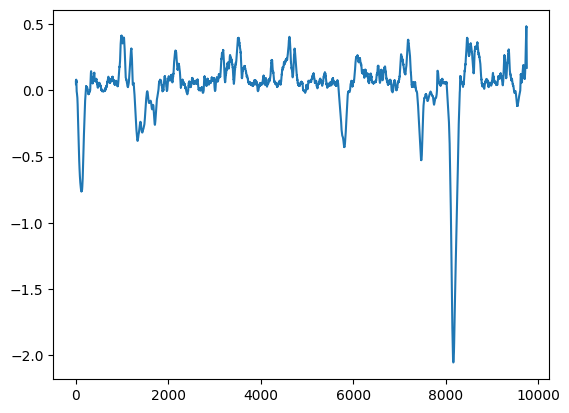

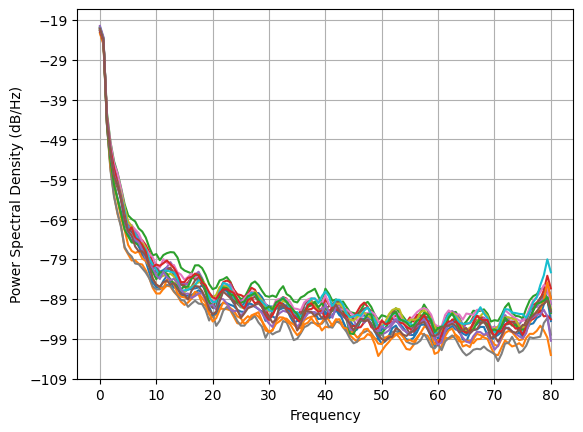

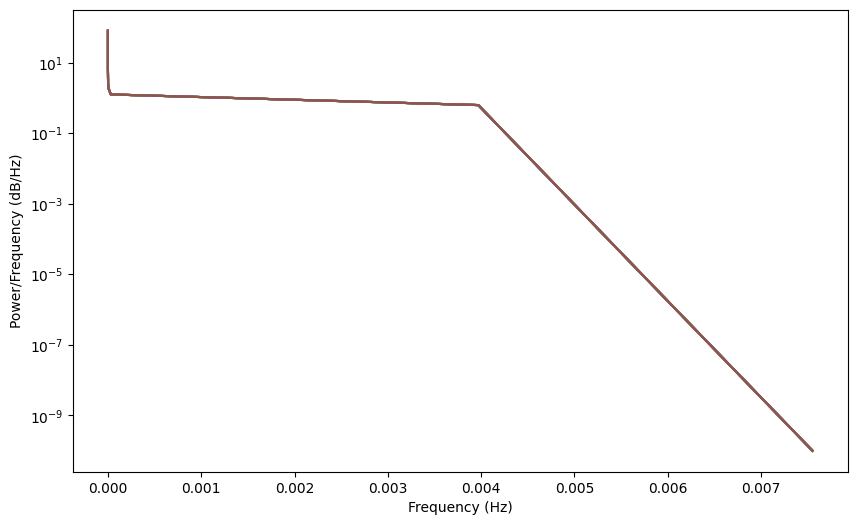

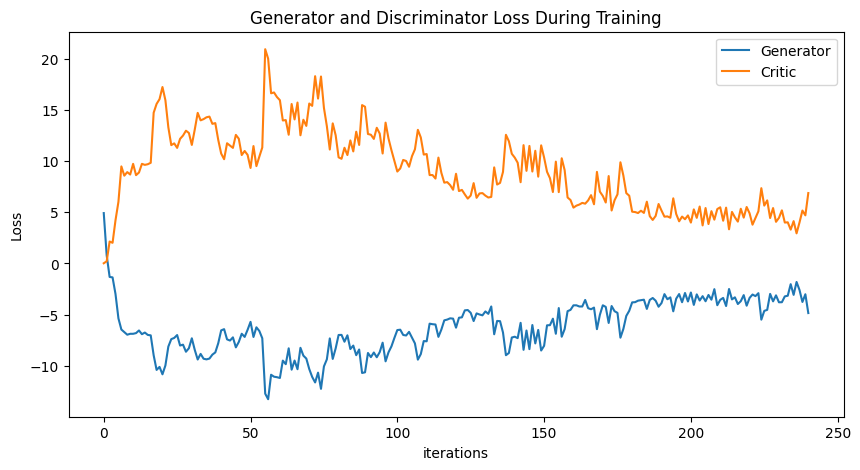

Epoch 250: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

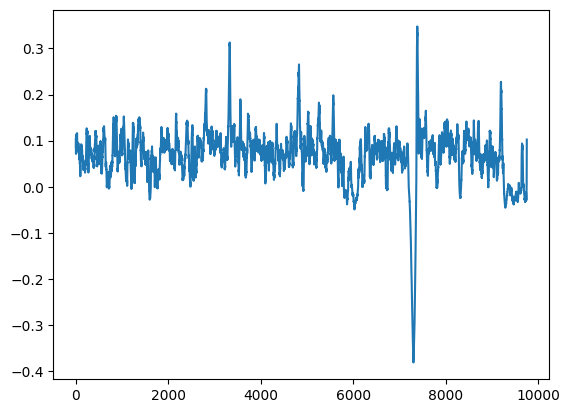

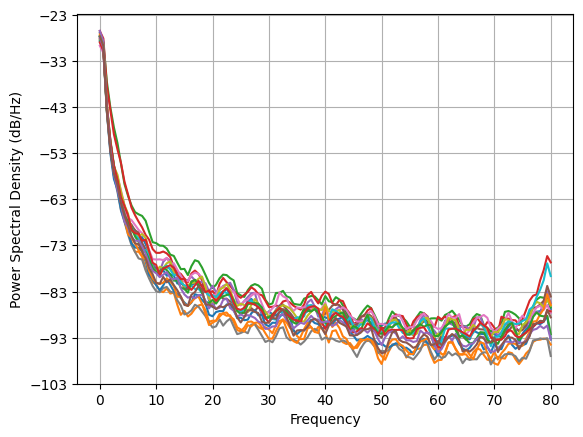

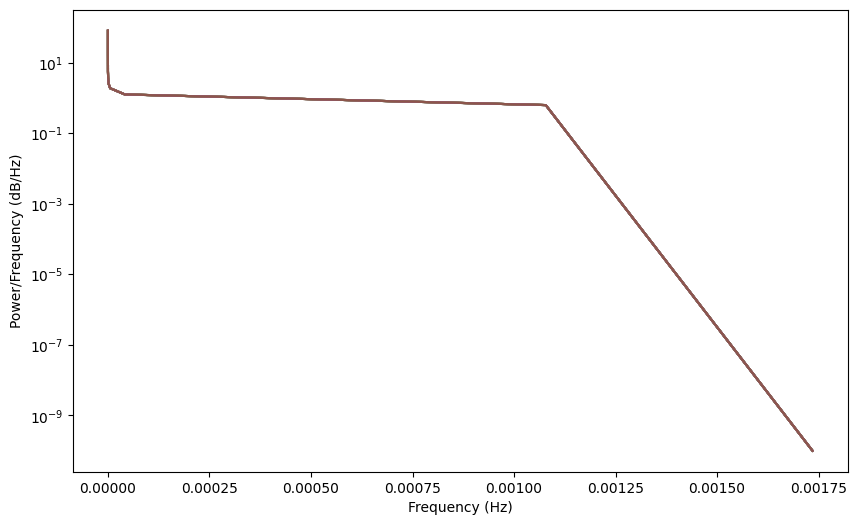

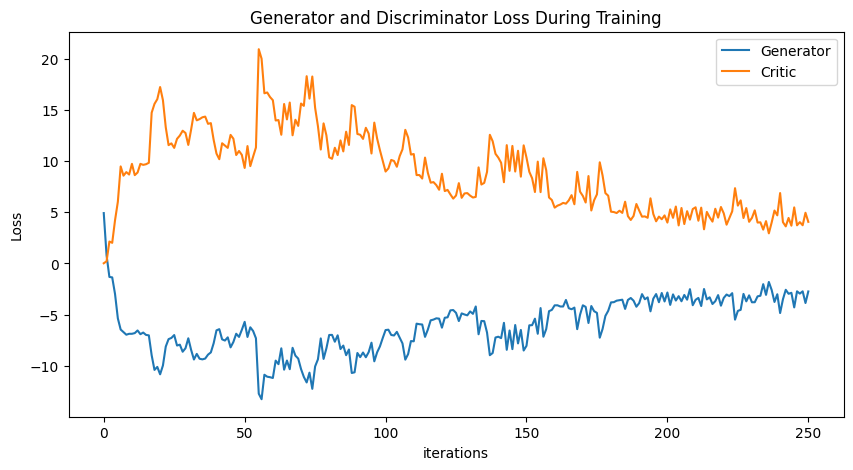

Epoch 260: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

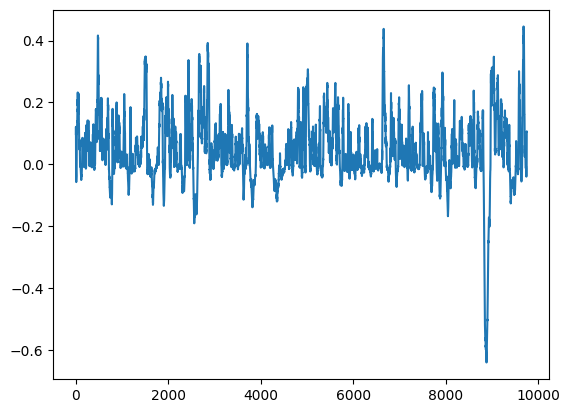

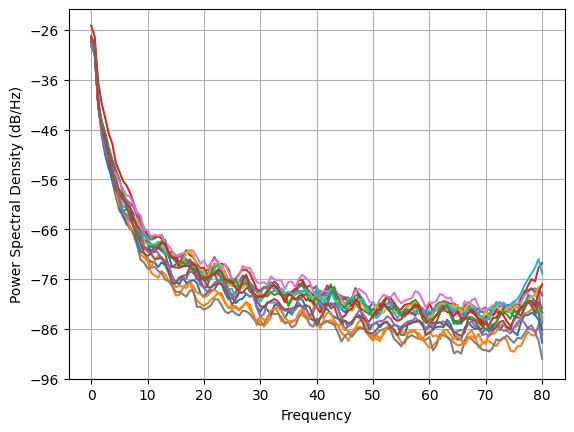

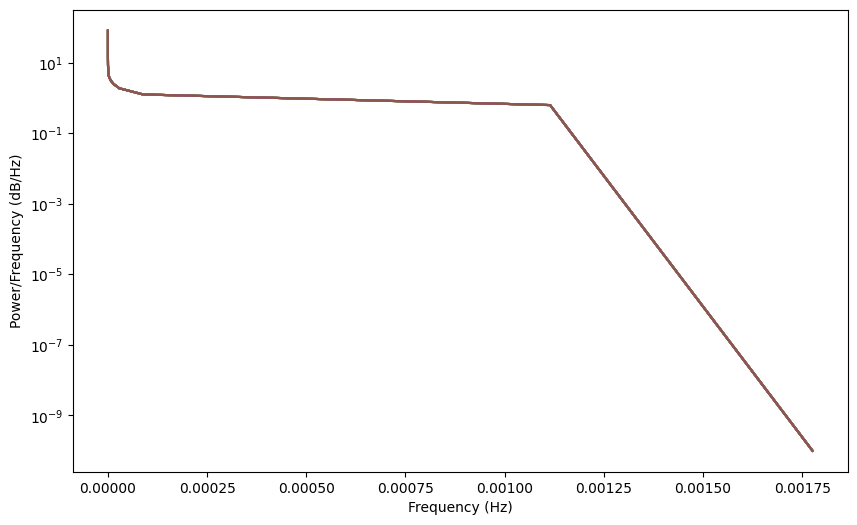

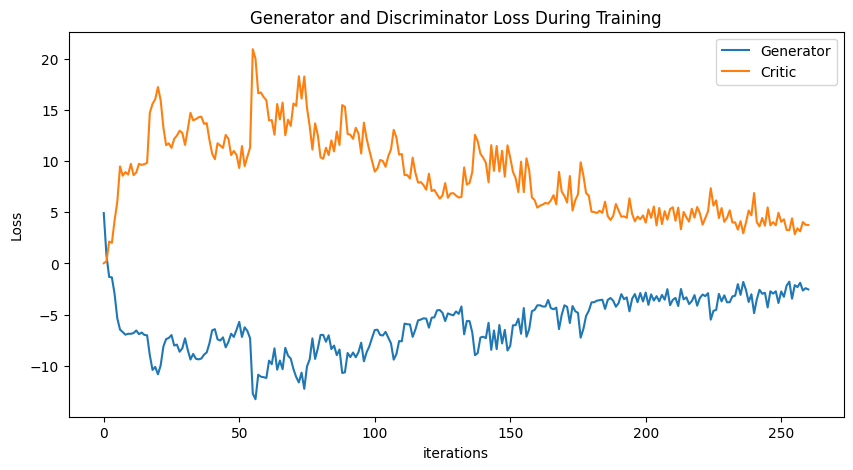

Epoch 270: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

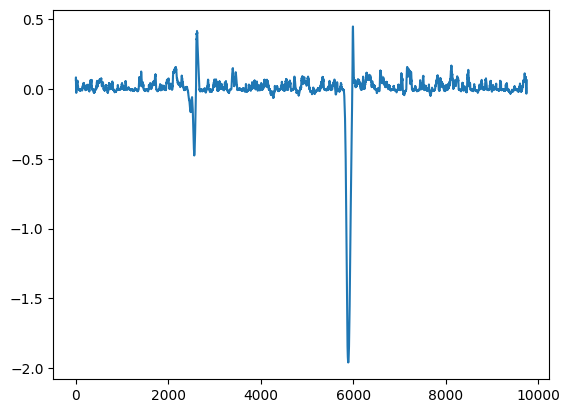

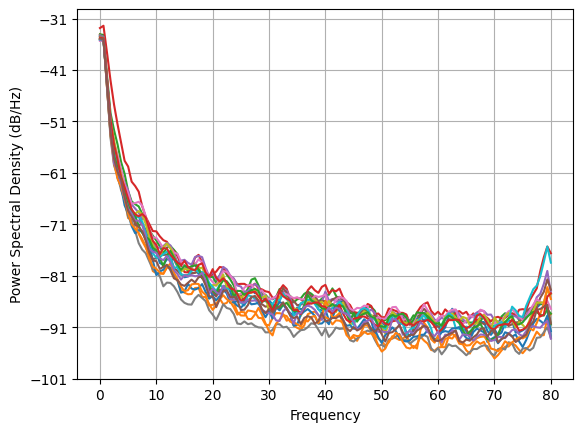

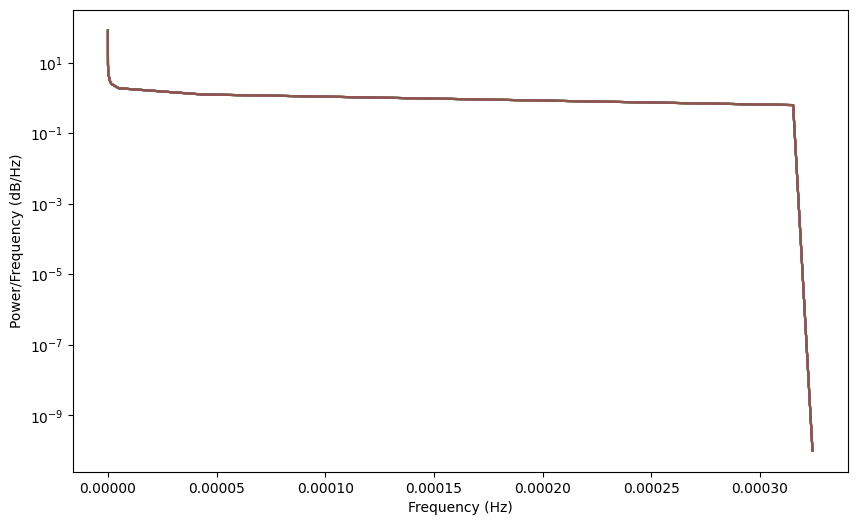

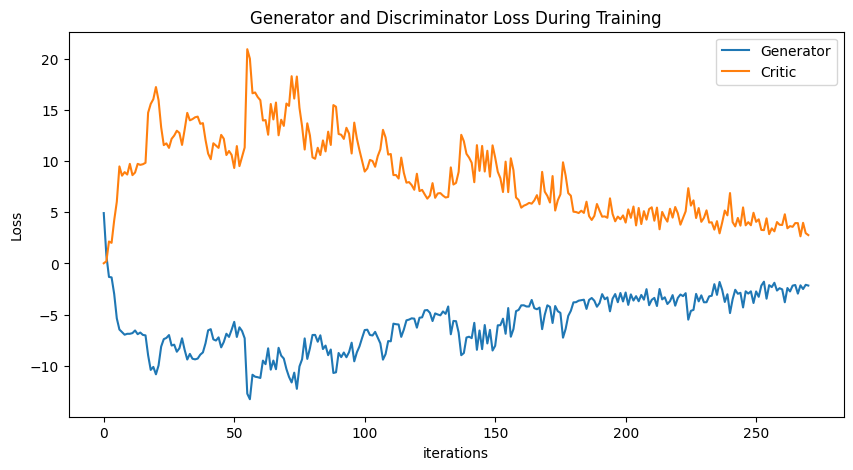

Epoch 280: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

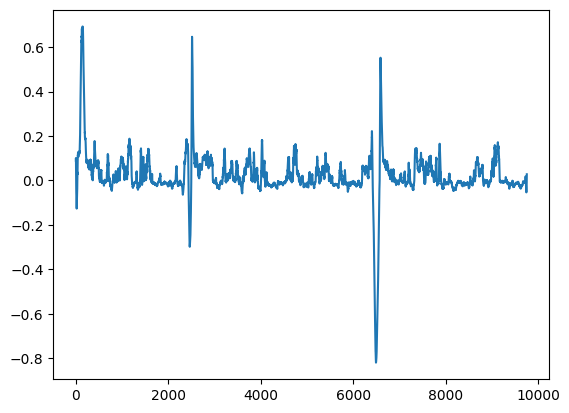

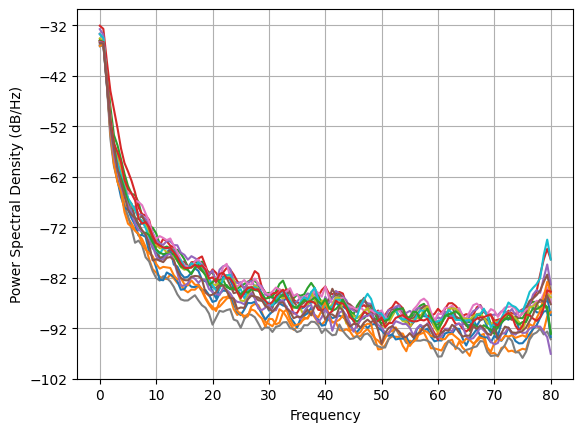

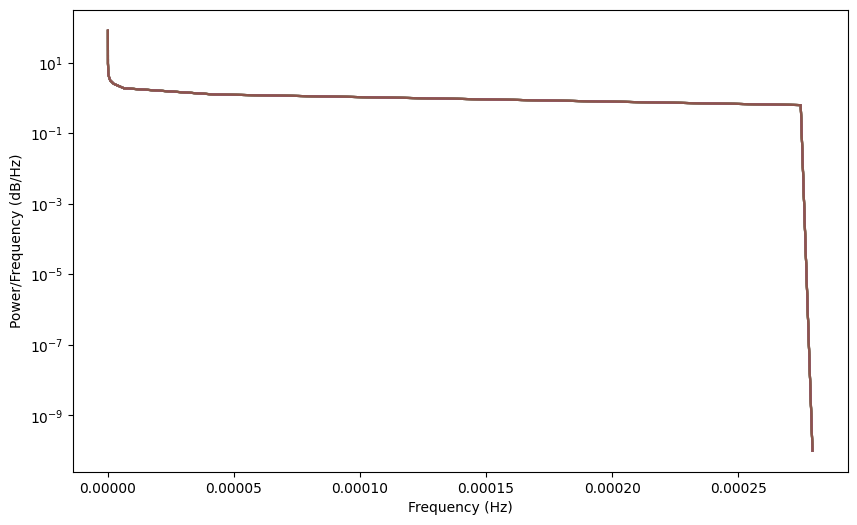

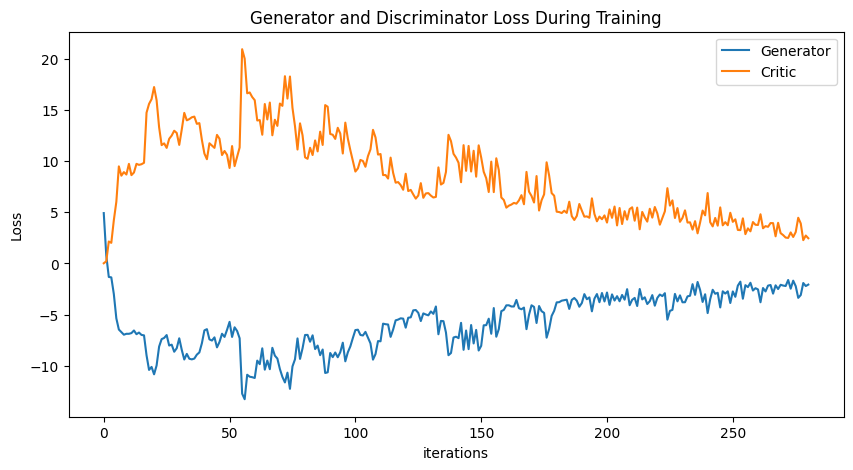

Epoch 290: Critic error ([4.917045953827386, 0.7820059316568423, -1.3216105780602385, -1.3656932975990306, -2.9875451060609035, -5.371127621728634, -6.459922203823998, -6.717975429160983, -6.9655083716752655, -6.877472107374728, -6.877163392602607, -6.809206484101169, -6.552015005991818, -6.915429965354987, -6.755435998513045, -6.98704036361184, -7.0296410887063585, -8.975256475488985, -10.405839201289362, -10.112564941509094, -10.83580760021754, -9.970932532661735, -8.126341920572184, -7.399255146770729, -7.28194865754013, -7.000389571982536, -8.023436485097022, -7.939252756814266, -8.630085414776396, -8.289139364725091, -7.316820903591236, -8.447235566636422, -9.389264886547389, -8.842002646595905, -9.314053957243921, -9.376181923967238, -9.297704663161344, -8.913708800540778, -8.69527591032244, -7.800238344070049, -6.541513916068162, -6.423892679799854, -7.422147601267242, -7.536651502831267, -7.224909058201646, -8.202315987079235, -7.675118949386924, -6.871842368208409, -7.18205855

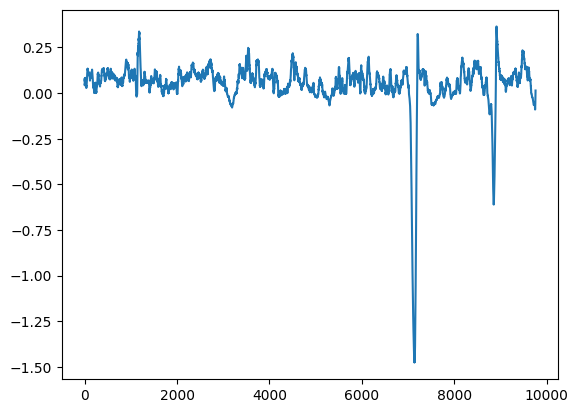

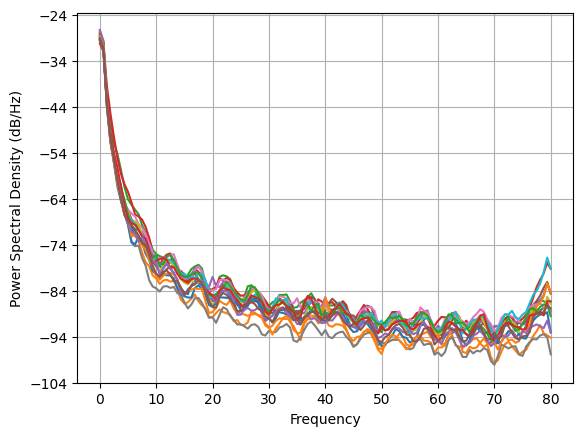

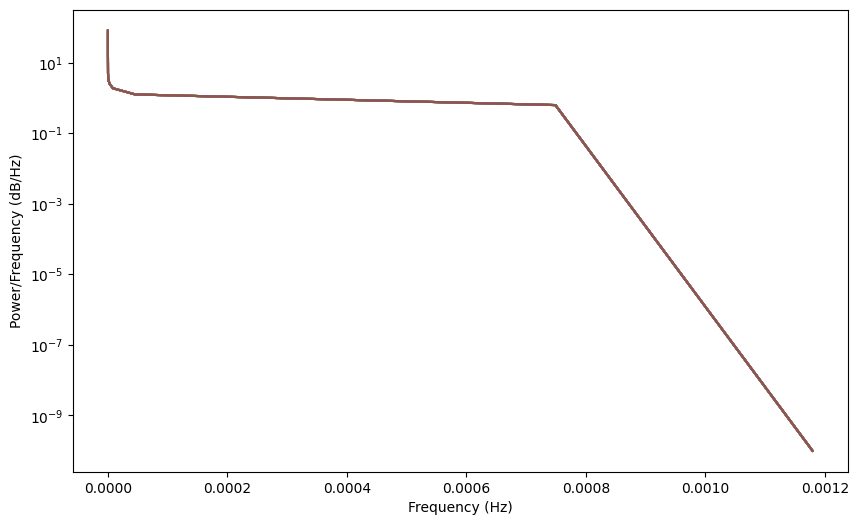

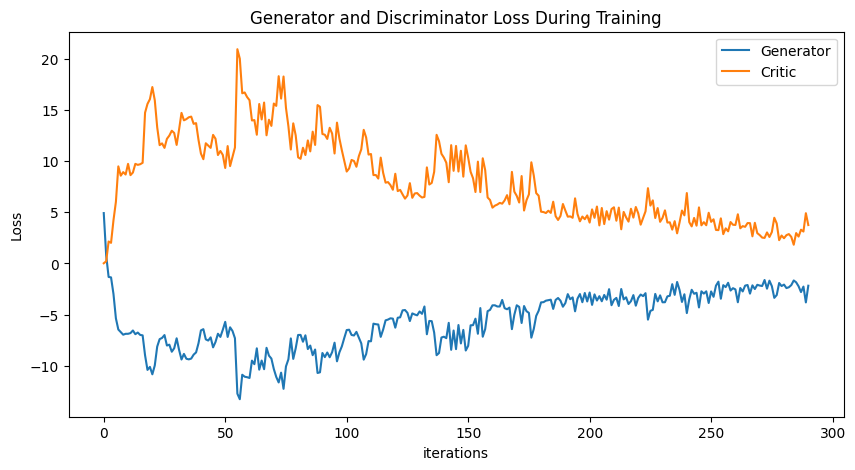

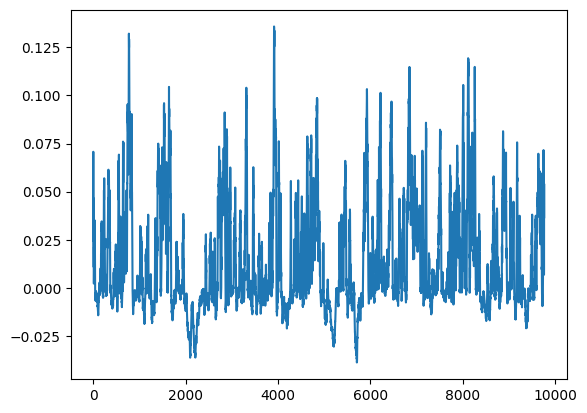

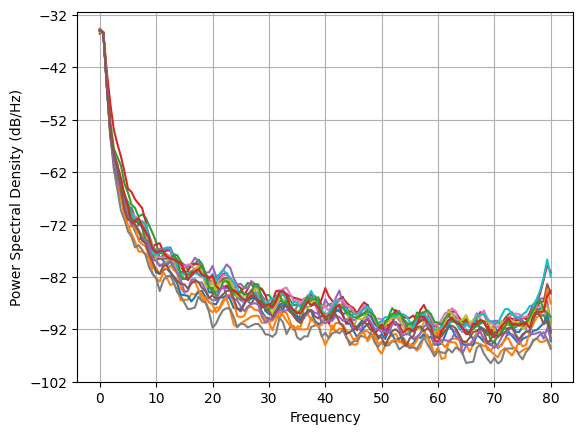

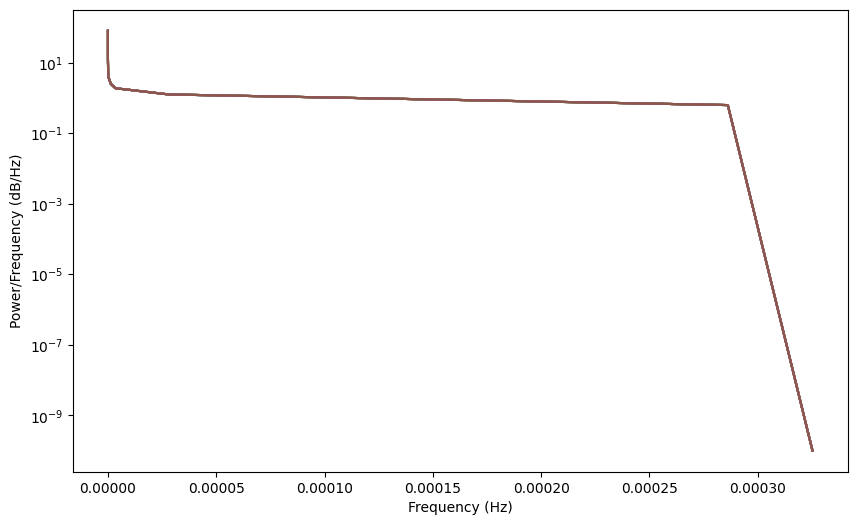

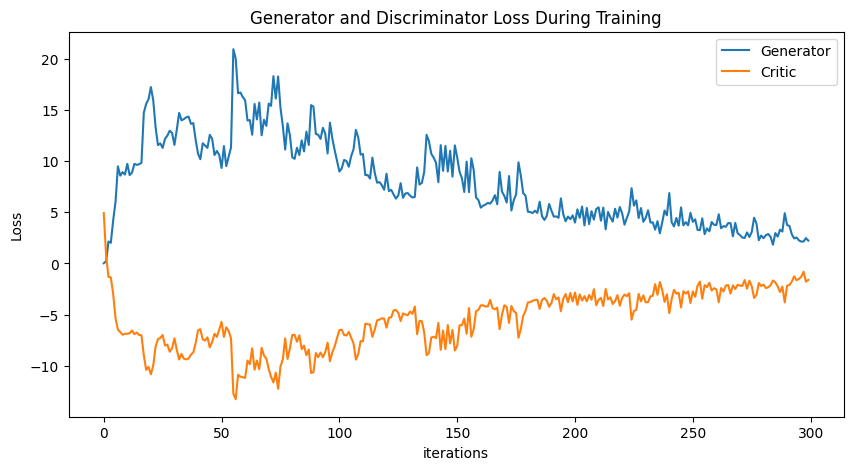

In [55]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_open)[0]
training_data = torch.tensor(training_data_open)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_open, disc, gen = train()

torch.save(gen, 'gen_16ch.pt')
torch.save(disc, 'disc_16ch.pt')
np.save('open_16ch.npy', generated_data_open.detach())
plot_everything(generated_data_open, gen_err, critic_err)
generated_data_open = None

# deeper generator (check this)

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(10240, 9760)
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),

            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(9, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 10)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'deepgen_16ch.pt')
torch.save(disc, 'deepdisc_16ch.pt')
np.save('deepclosed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# 320 inner channel size for both gen and disc 

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch.pt')
torch.save(disc, 'disc_16ch.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# kernel 2

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=2),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=2),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=2),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=2),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=2),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=2),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(9823, 9760)
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=2),
            nn.LeakyReLU(0.2),
            nn.Linear(150, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch_kernel2.pt')
torch.save(disc, 'disc_16ch_kernel2.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Try kernel 4

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(9949, 9760)
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.Linear(146, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch_kernel2.pt')
torch.save(disc, 'disc_16ch_kernel2.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# changing kernel size (9 then 4)

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=4),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(10229, 9760)
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=4),
            nn.LeakyReLU(0.2),
            nn.Linear(146, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch_kernel2.pt')
torch.save(disc, 'disc_16ch_kernel2.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Kernel size 20 

Epoch 0: Critic error ([0.30693914212570444]) Generator err ([0.34519797563552856])


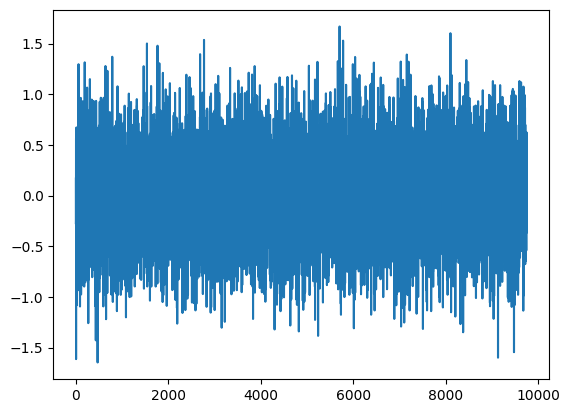

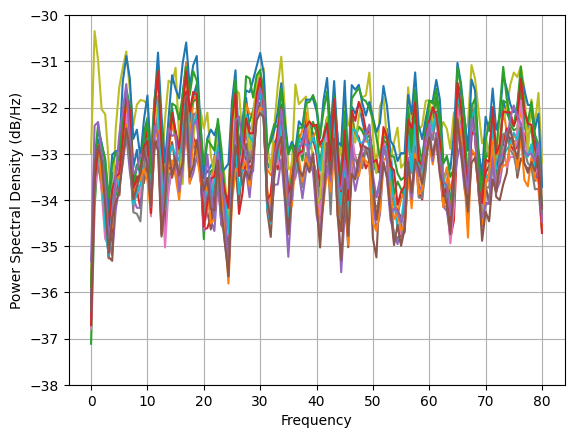

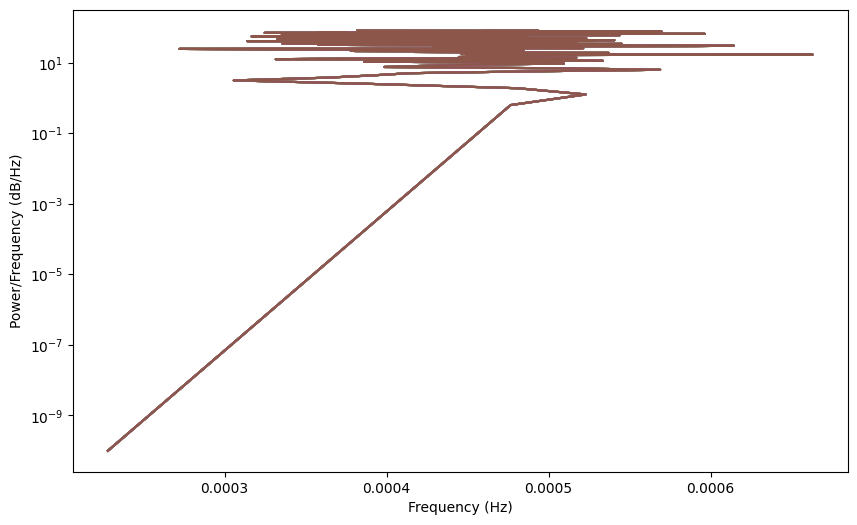

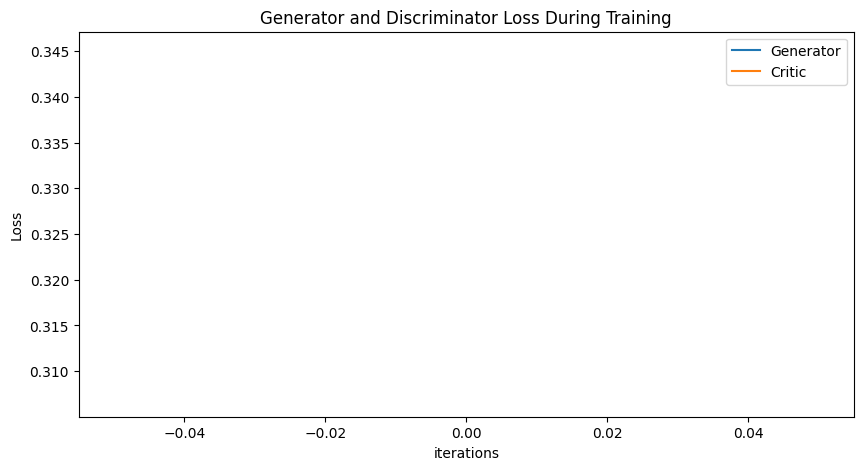

Epoch 10: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144]) Generator err ([0.34519797563552856, 65.76544189453125, 97.1737289428711, 119.2094497680664, 80.8116683959961, 55.093570709228516, 22.350149154663086, 15.496976852416992, 26.286277770996094, 14.850132942199707, 14.305792808532715])


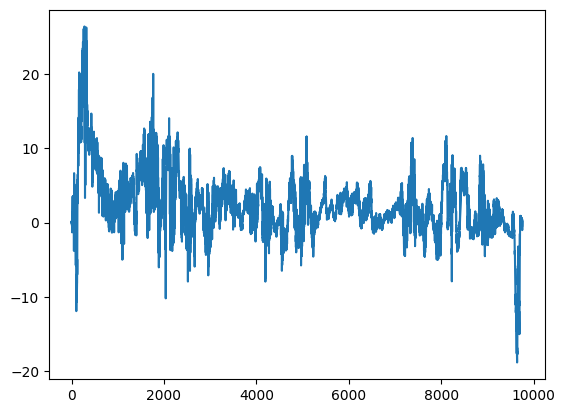

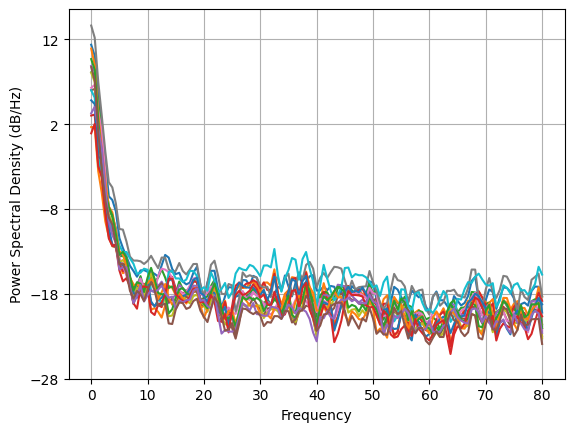

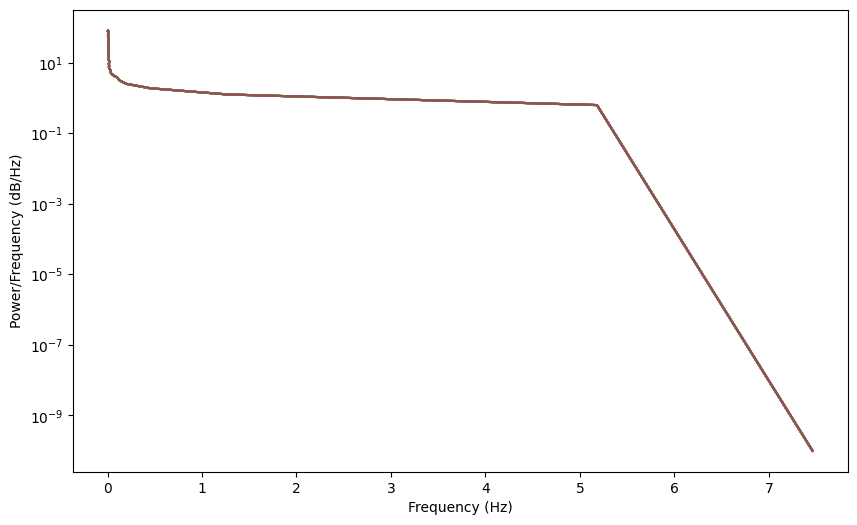

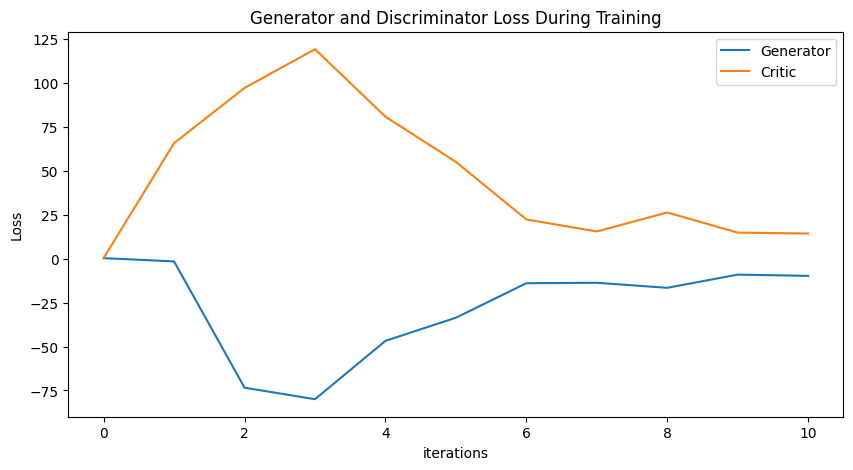

Epoch 20: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546]) Generator err ([0.34519797563552856, 65.76544189453125, 97.1737289428711, 119.2094497680664, 80.8116683959961, 55.093570709228516, 22.350149154663086, 15.496976852416992, 26.286277770996094, 14.850132942199707, 14.305792808532715, 7.3730058670043945, 6.927855014801025, 7.471524715423584, 4.649755477905273, 2.8716561794281006, 3.573944091796875, 3.182114839553833, 2.5398471355438232, 3.3394381999969482, 2.791029214859009])


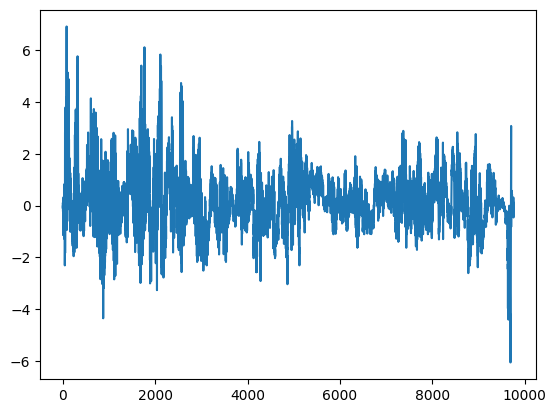

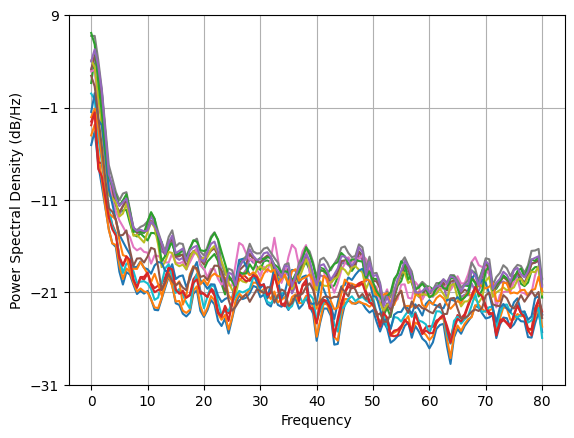

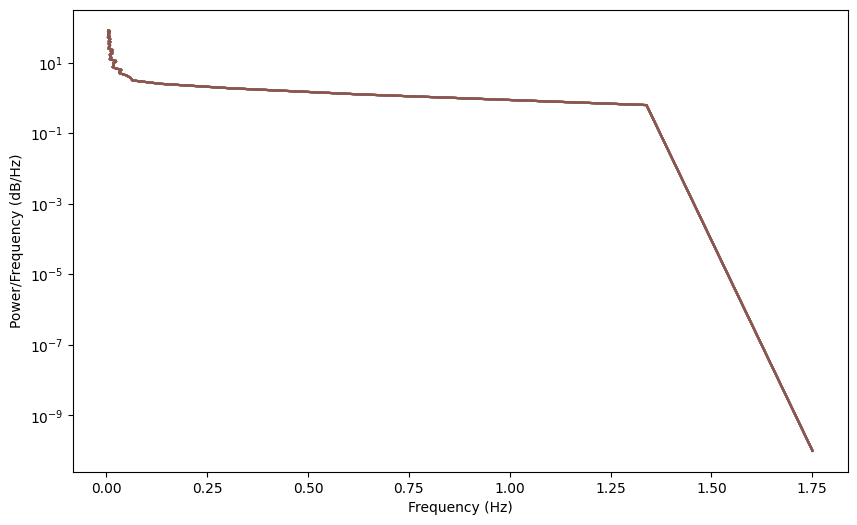

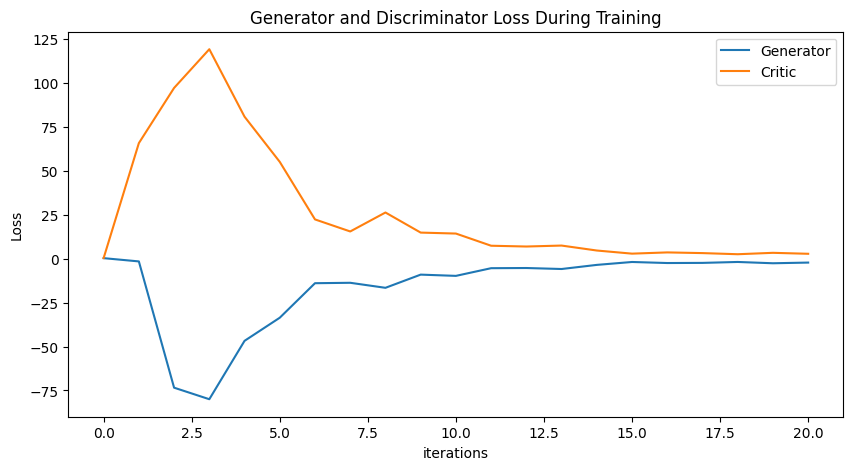

Epoch 30: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271]) Generator err ([0.34519797563552856, 65.76544189453125, 97.1737289428711, 119.2094497680664, 80.8116683959961, 55.093570709228516, 22.350149154663086, 15.496976852416992, 26.286277770996094, 14.850132942199707, 14.305792808532715, 7.3730058670043945, 6.927855014801025, 7.471524715423584, 4.649755477905273, 2.8716561794281006, 3.573944091796875,

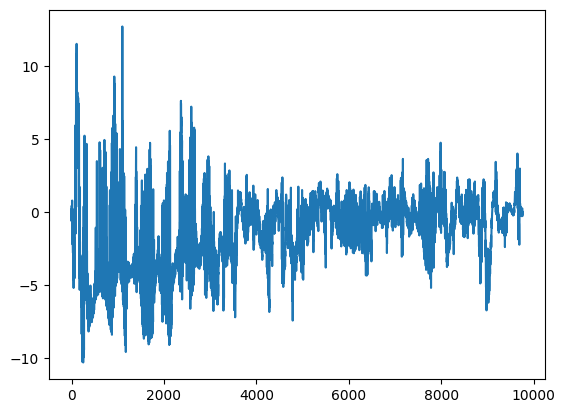

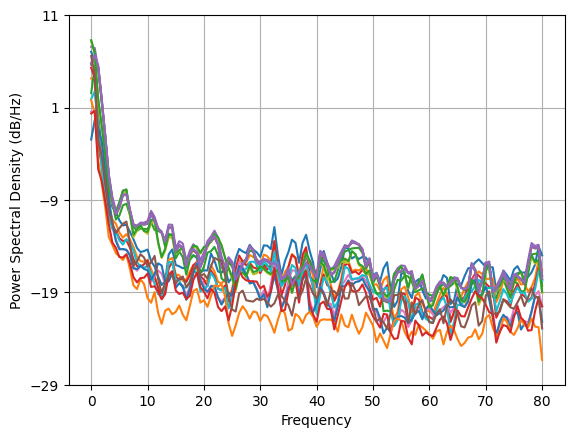

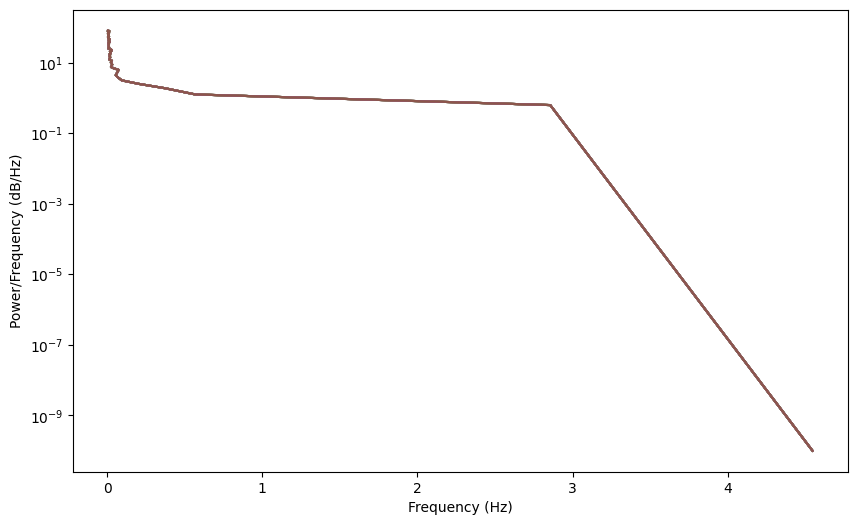

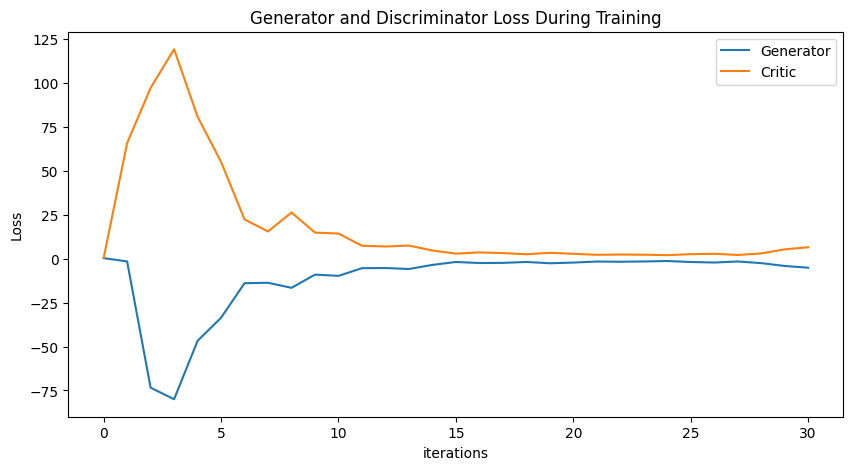

Epoch 40: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271, -5.9839357936989614, -7.848582994024962, -4.930449180555267, -2.0145863086800553, -1.168586469600096, -2.1228556508687735, -2.0209675062712424, -2.355168079011456, -3.5142252366314697, -2.214737266513465]) Generator err ([0.34519797563552856, 65.76544189453125, 97.1737289428711, 119.2094497680664, 80.8116683959961, 55.093570709228516, 22.3501491

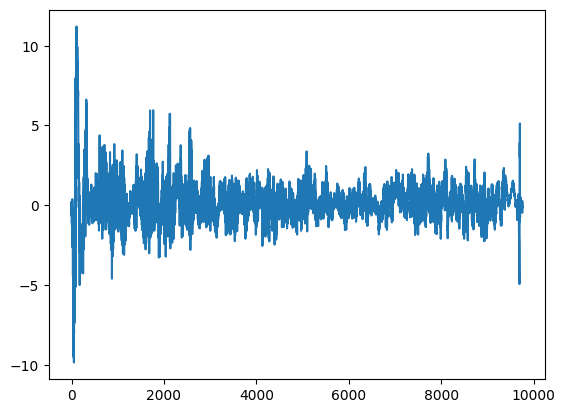

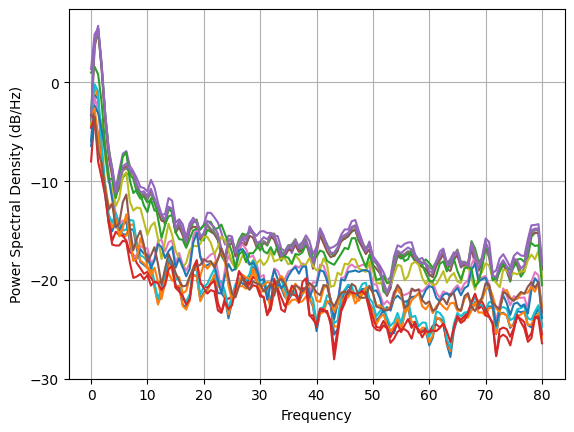

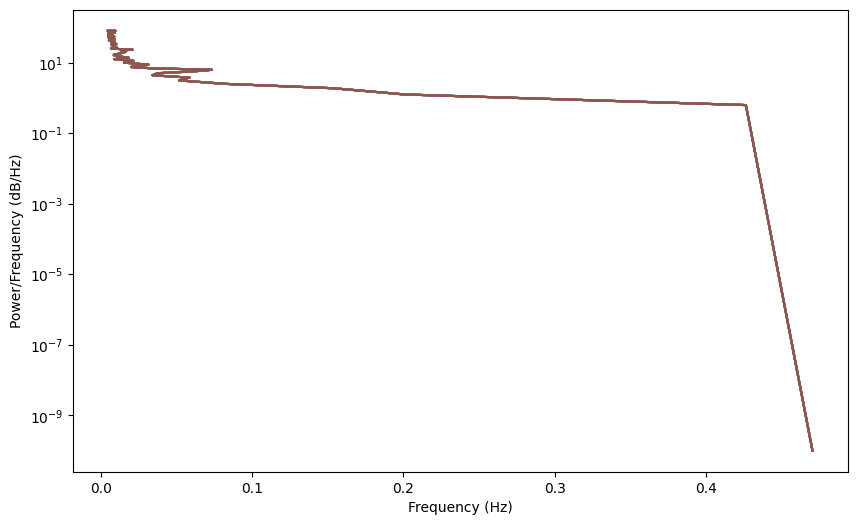

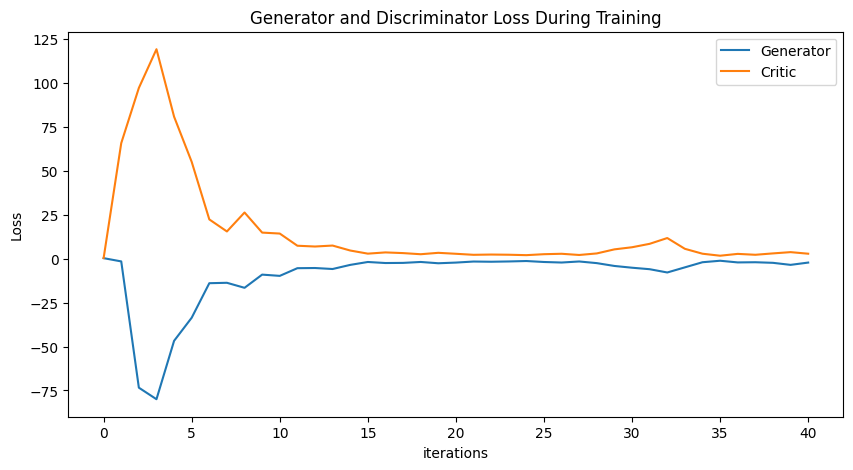

Epoch 50: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271, -5.9839357936989614, -7.848582994024962, -4.930449180555267, -2.0145863086800553, -1.168586469600096, -2.1228556508687735, -2.0209675062712424, -2.355168079011456, -3.5142252366314697, -2.214737266513465, -2.712395136502783, -2.163160956865973, -1.6766633777945739, -2.3974375721355163, -3.539822133438829, -3.049003299734212, -2.400375684588482, 

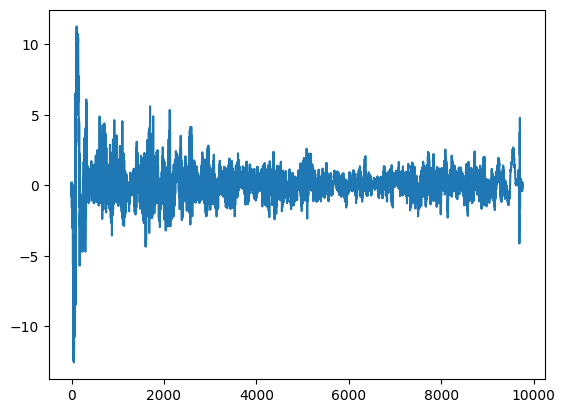

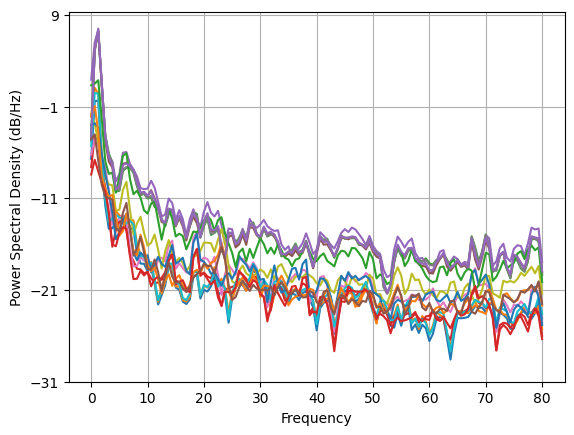

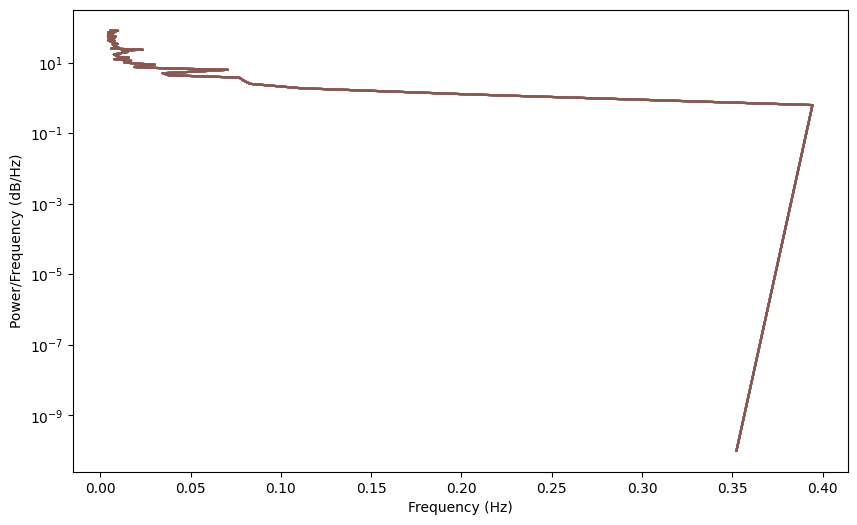

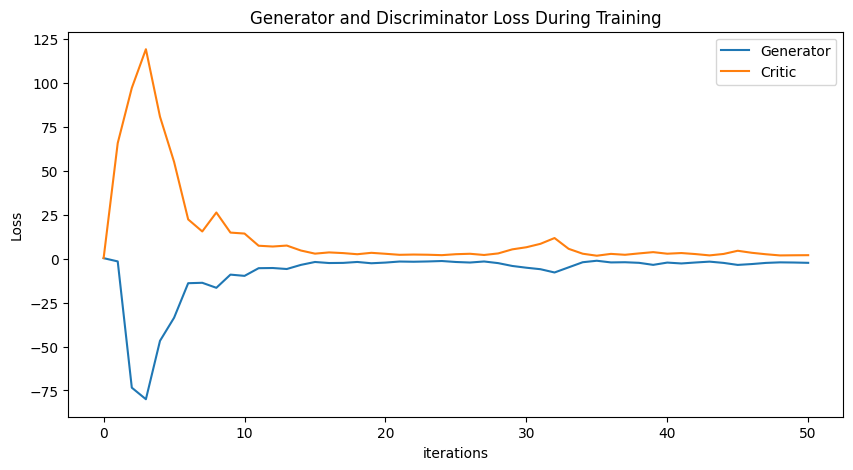

Epoch 60: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271, -5.9839357936989614, -7.848582994024962, -4.930449180555267, -2.0145863086800553, -1.168586469600096, -2.1228556508687735, -2.0209675062712424, -2.355168079011456, -3.5142252366314697, -2.214737266513465, -2.712395136502783, -2.163160956865973, -1.6766633777945739, -2.3974375721355163, -3.539822133438829, -3.049003299734212, -2.400375684588482, 

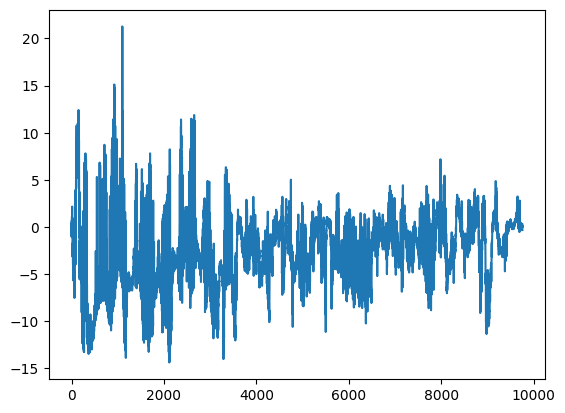

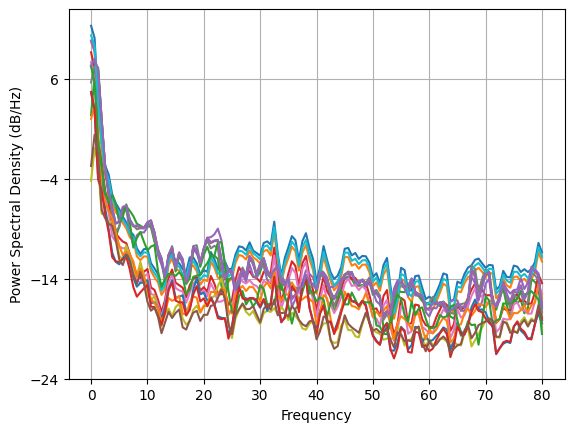

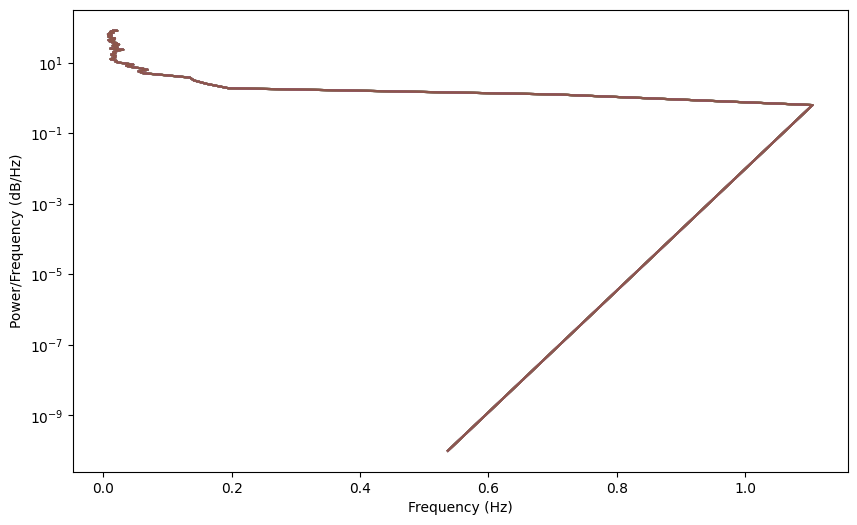

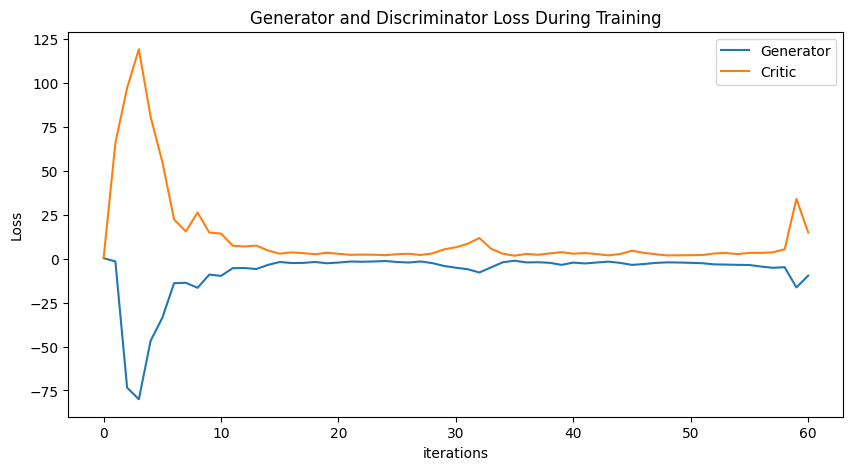

Epoch 70: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271, -5.9839357936989614, -7.848582994024962, -4.930449180555267, -2.0145863086800553, -1.168586469600096, -2.1228556508687735, -2.0209675062712424, -2.355168079011456, -3.5142252366314697, -2.214737266513465, -2.712395136502783, -2.163160956865973, -1.6766633777945739, -2.3974375721355163, -3.539822133438829, -3.049003299734212, -2.400375684588482, 

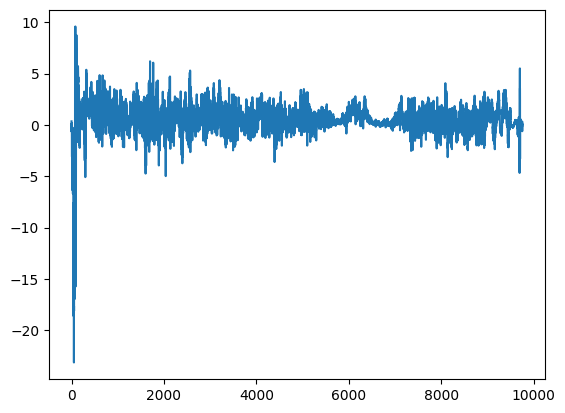

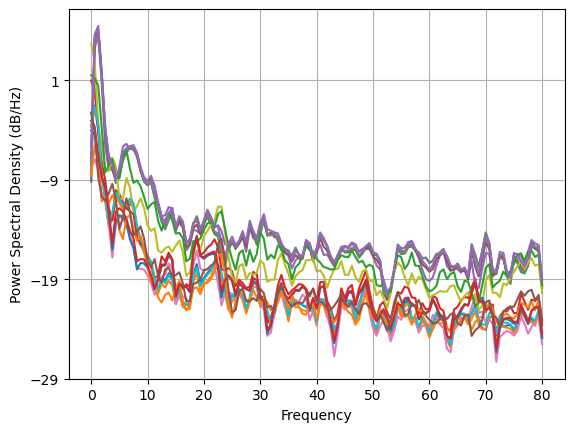

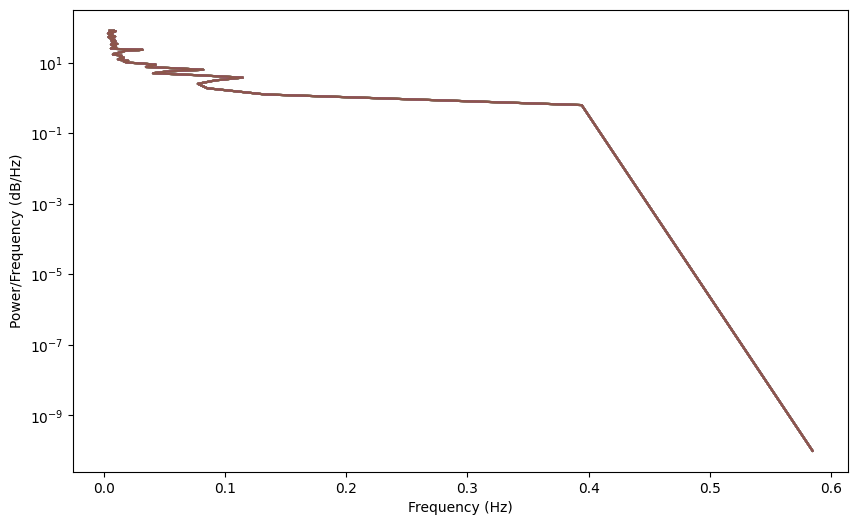

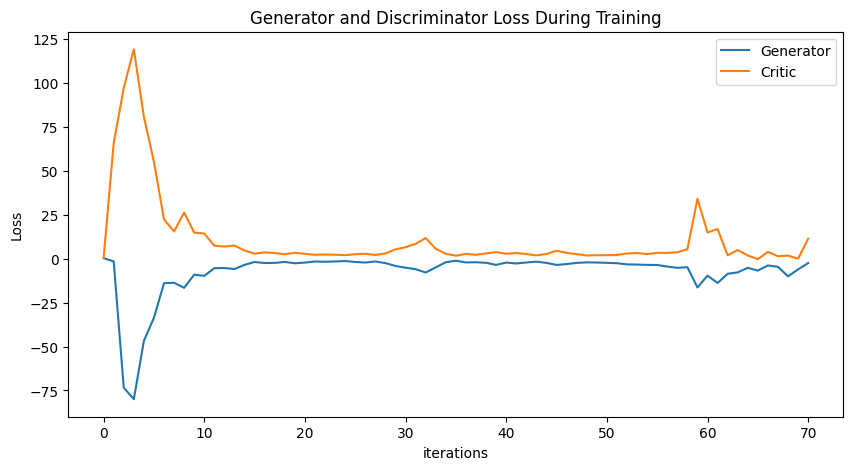

Epoch 80: Critic error ([0.30693914212570444, -1.5502725676550415, -73.40651802181755, -79.97779369109851, -46.7550804653436, -33.59474715296331, -13.95176027277697, -13.715652239116578, -16.57185431122297, -9.067223022962413, -9.777996818459144, -5.406657786852584, -5.305850057253344, -5.870974727869502, -3.5282070288512215, -1.875635001364057, -2.4700518574430133, -2.3907785728827364, -1.8633007572021478, -2.60155183198741, -2.213535453605546, -1.6185569124323844, -1.7375486945673213, -1.5759454732418308, -1.3275382545223184, -1.8810288126245827, -2.183489468355607, -1.586992932385619, -2.525933993397913, -4.1378667788658, -5.139309127387271, -5.9839357936989614, -7.848582994024962, -4.930449180555267, -2.0145863086800553, -1.168586469600096, -2.1228556508687735, -2.0209675062712424, -2.355168079011456, -3.5142252366314697, -2.214737266513465, -2.712395136502783, -2.163160956865973, -1.6766633777945739, -2.3974375721355163, -3.539822133438829, -3.049003299734212, -2.400375684588482, 

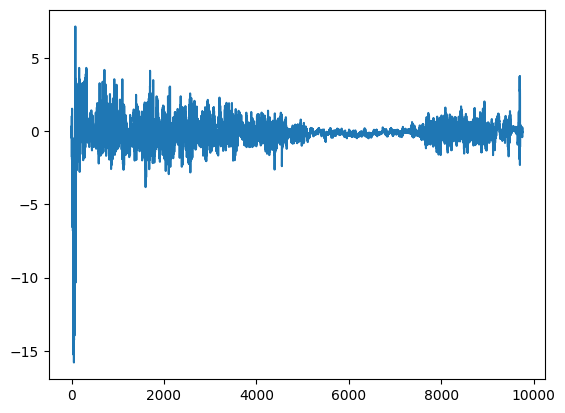

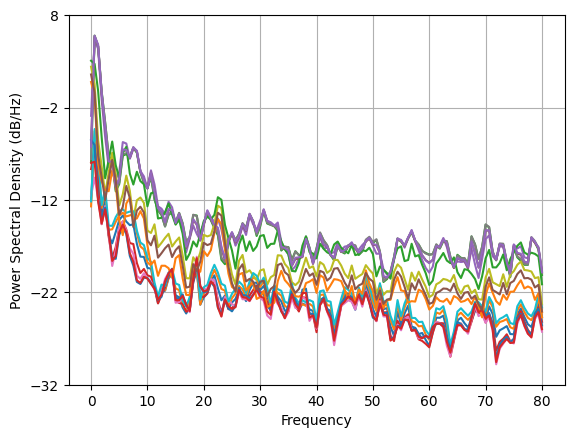

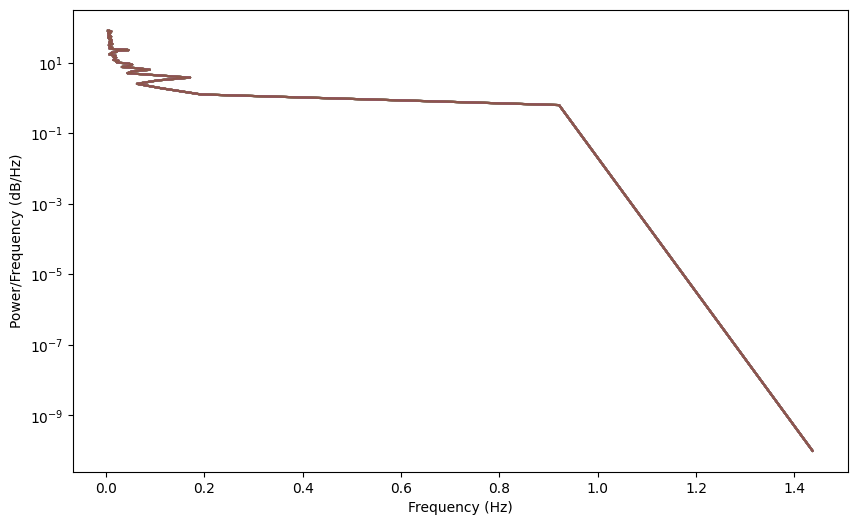

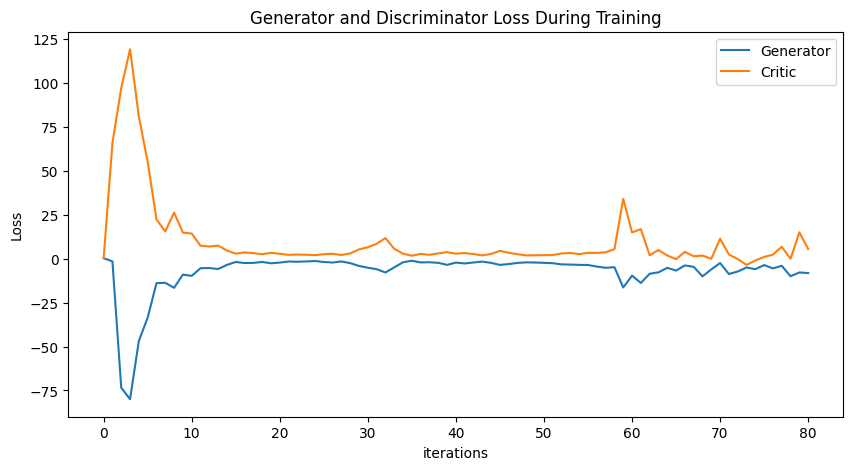

KeyboardInterrupt: 

In [2]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=20),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=20),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=20),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=20),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=20),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=20),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(10957, 9760)
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=20),
            nn.LeakyReLU(0.2),
            nn.Linear(114, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch_kernel20.pt')
torch.save(disc, 'disc_16ch_kernel20.pt')
np.save('closed_16ch_k20.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# kernel size 9, no padding

In [ ]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = np.load('training_closed.npy')
BATCH_SIZE = np.shape(training_data)[0]
training_data = torch.tensor(training_data_closed)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 320, kernel_size=9),
            nn.BatchNorm1d(320, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(320, 16, kernel_size=9),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(16, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 320, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(320, 16, kernel_size=9),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 320, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_16ch.pt')
torch.save(disc, 'disc_16ch.pt')
np.save('closed_16ch.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None